# Evaluation des couts sur la ville de Montreal

## Liste des quartiers de Montreal

In [1]:
listofquarter = []
listofquarter.append("Verdun, Montreal, Canada")
listofquarter.append("LaSalle, Montreal, Canada")
listofquarter.append("Borough of Lachine, Montreal, Canada")
listofquarter.append("Saint-Laurent, Montreal, Canada")
listofquarter.append("Le Sud-Ouest, Montreal, Canada")
listofquarter.append("Côte-des-Neiges-Notre-Dame-de-Grâce, Montreal, Canada")
listofquarter.append("Ville-Marie, Montreal, Canada")
listofquarter.append("Outremont, Montreal, Canada")
listofquarter.append("Le Plateau-Mont-Royal, Montreal, Canada")
listofquarter.append("Rosemont-La Petite-Patrie, Montreal, Canada")
listofquarter.append("Hochelaga, Montreal, Canada")
listofquarter.append("Maisonneuve, Montreal, Canada")
listofquarter.append("Anjou, Montreal, Canada")
listofquarter.append("Rivière-des-Prairies, Montreal, Canada")
listofquarter.append("Pointe-aux-Trembles, Montreal, Canada")
listofquarter.append("Montréal-Nord, Montreal, Canada")
listofquarter.append("Saint-Léonard, Montreal, Canada")
listofquarter.append("Villeray-Saint-Michel-Parc-Extension, Montreal, Canada")
listofquarter.append("Ahuntsic, Montreal, Canada")
listofquarter.append("Cartierville, Montreal, Canada")
listofquarter.append("Pierrefonds-Roxboro, Montreal, Canada")
listofquarter.append("L'île-Bizard-Sainte-Geneviève, Montreal, Canada")

In [ ]:
def pull_all_graph(list_quarter):
    """
    Permet de recuperer les graphs associés à tous les quartiers
    """
    graph_of_quarter_drive = []
    graph_of_quarter_walk = []
    for i in range(len(list_quarter)):
        print(list_quarter[i])
        quarter = ox.graph_from_place(list_quarter[i], network_type='drive')
        print(ox.plot_graph(quarter))
        graph_of_quarter_drive.append(quarter)
        quarter_walk = ox.graph_from_place(list_quarter[i], network_type='walk')
        print(ox.plot_graph(quarter_walk))
        graph_of_quarter_walk.append(quarter_walk)

    return (graph_of_quarter_drive, graph_of_quarter_walk)


In [4]:
def find_size_of_each_quarter(list_quarter, list_graph):
    arrayoflength = []
    allroad = 0
    for i in range(len(list_quarter)):
        print(list_quarter[i])
        proj = ox.project_graph(list_graph[i])
        nodes_proj = ox.graph_to_gdfs(proj, edges=False)
        graph_area_m = nodes_proj.unary_union.convex_hull.area
        length_road = ox.basic_stats(proj, area=graph_area_m, clean_int_tol=15)["edge_length_total"]
        arrayoflength.append(length_road)
        allroad += length_road
        print(length_road)
    return (allroad, arrayoflength)

In [5]:
import math


def divide_nb_snowplot_by_quarter(array_size_quarter, total_size, nb_drive_snowplot):
    """
    Permet de trouver le nombre de deneigeuse à utiliser par quartier
    """
    deneigeuseperquarter = []
    for i in range(len(array_size_quarter)):
        nb_deneigeuse = math.floor((nb_drive_snowplot * array_size_quarter[i]) / total_size)
        print(str(listofquarter[i]) + " : " + str(nb_deneigeuse))
        deneigeuseperquarter.append(nb_deneigeuse)

    print(deneigeuseperquarter)
    return deneigeuseperquarter

In [6]:
import osmnx as ox
import networkx as nx
import numpy as np

In [7]:
def divideeulerbynbdeneigeuse(nbd, circuit, G):
    size = len(circuit)
    start_node = circuit[0]
    size_circuit = size // nbd
    result = []
    tmp = []
    nb = 0
    for i in circuit:
        if ( nb >= size_circuit):
            if (tmp[0] != start_node):
                st = ox.shortest_path(G, start_node, tmp[0])
                st.pop()
                tmp = st + tmp

            if (tmp[len(tmp) - 1] != start_node):
                st = ox.shortest_path(G, tmp[len(tmp) - 1], start_node)
                tmp.pop()
                tmp = tmp + st

            result.append(tmp)
            tmp = []
            nb = 0
        tmp.append(i)
        nb += 1
    if (tmp != [] and len(result) < nbd):
        result.append(tmp)
    return result

In [8]:
def find_road_for_each_snowplot_in_quarter(which_quarter, nb_snowplot, listofquarter, graph_quarter, speed_snowplot):
    print("========================================================================")
    print("====================== " + listofquarter[which_quarter] + " =======================")
    Hoch_unordered = ox.get_undirected(graph_quarter[which_quarter])   
    H = nx.eulerize(Hoch_unordered)
    print("The graph is eulerian : " + str(nx.is_eulerian(H)))

    Hoch_unordered = ox.speed.add_edge_speeds(Hoch_unordered)
    Hoch_unordered = ox.speed.add_edge_travel_times(Hoch_unordered)

    euler_circuit = [u for u, v in nx.eulerian_circuit(H)]
    print(euler_circuit)

    print("show the eulerian circuit : ")
    print(ox.plot_graph_route(Hoch_unordered, euler_circuit, node_size=0))

    allcircuitquarter = divideeulerbynbdeneigeuse(nb_snowplot, euler_circuit, Hoch_unordered)

    for i in allcircuitquarter:
        print(i)
        print(ox.plot_graph_route(Hoch_unordered, i, node_size=0))
    
        edge_lengths = ox.utils_graph.get_route_edge_attributes(Hoch_unordered, i, "length")
        length = round(sum(edge_lengths))
        print("length of road : " + str(length))
        time_for_deneigeuse = ((length / 1000) * 60) / speed_snowplot
        print("time : "+ str(time_for_deneigeuse) + str(" minutes"))

In [9]:
def show_road_for_each_snowplot(arr, listofquarter, graph_quarter, speed_snowplot):
    for i in range(len(arr)):
        find_road_for_each_snowplot_in_quarter(i, arr[i],listofquarter, graph_quarter, speed_snowplot)

## Premièrement on recupère les graphs des quartiers

Verdun, Montreal, Canada


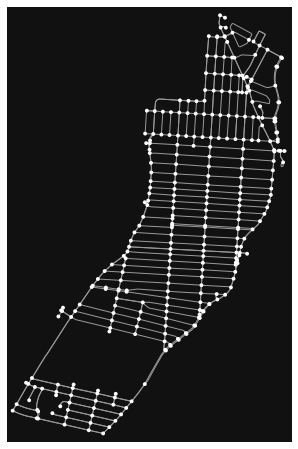

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


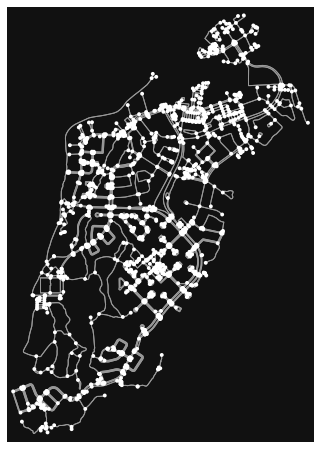

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
LaSalle, Montreal, Canada


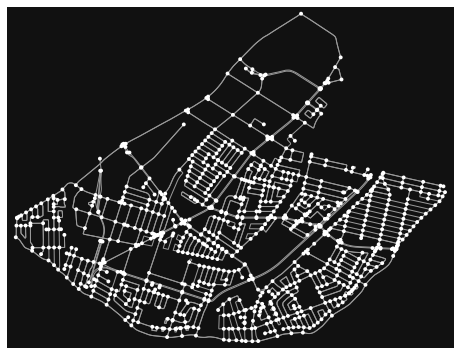

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


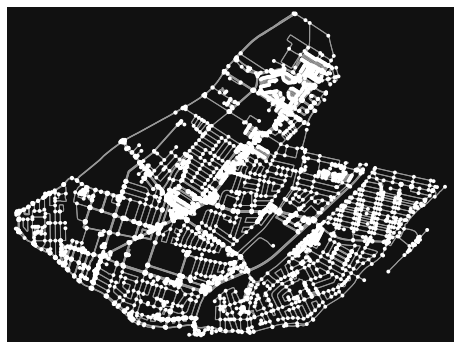

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Borough of Lachine, Montreal, Canada


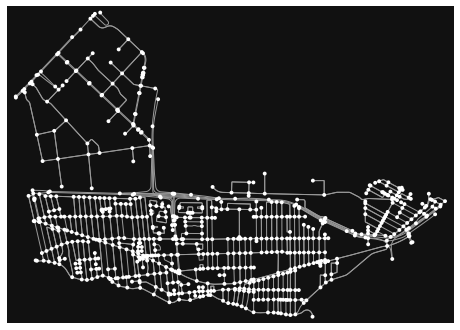

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


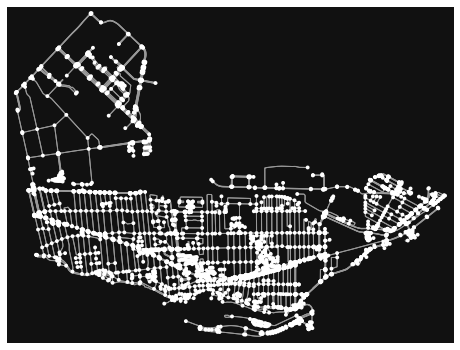

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Saint-Laurent, Montreal, Canada


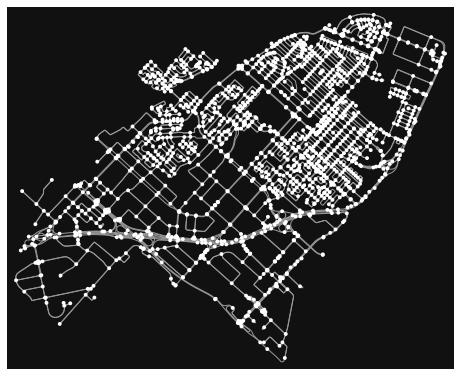

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


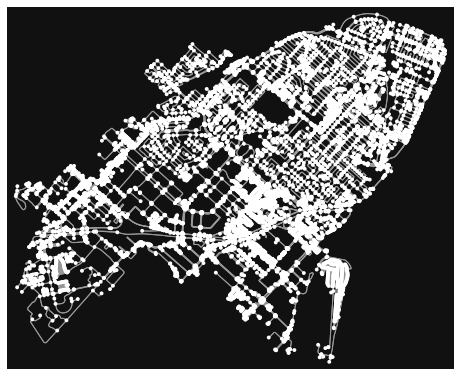

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Le Sud-Ouest, Montreal, Canada


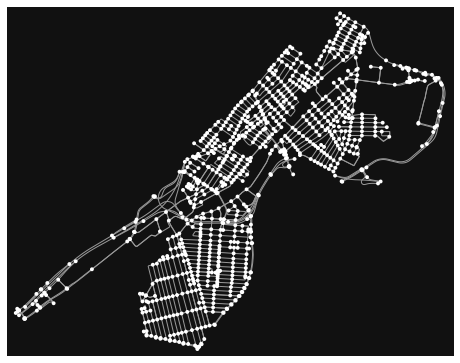

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


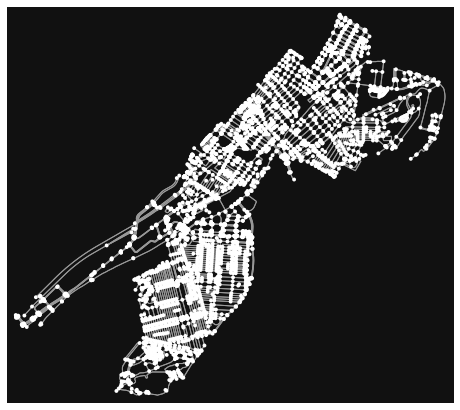

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Côte-des-Neiges-Notre-Dame-de-Grâce, Montreal, Canada


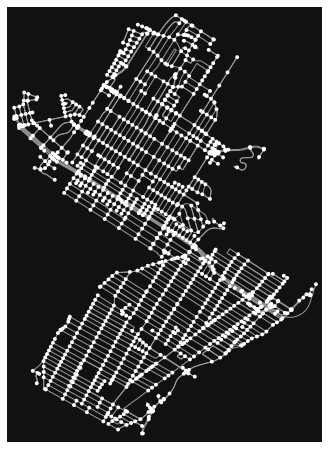

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


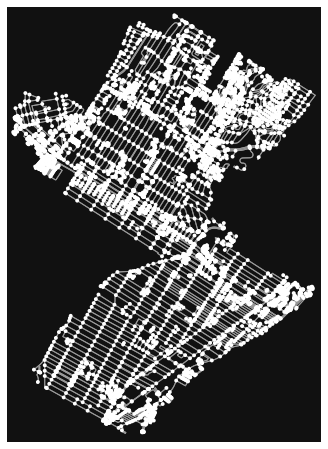

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Ville-Marie, Montreal, Canada


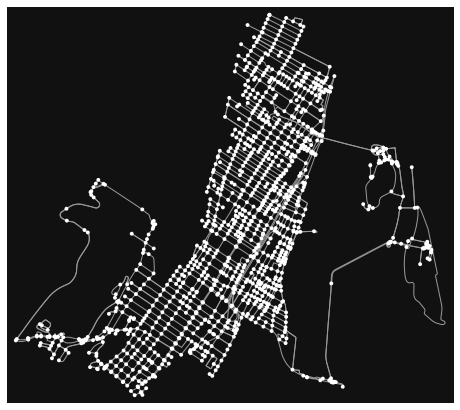

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


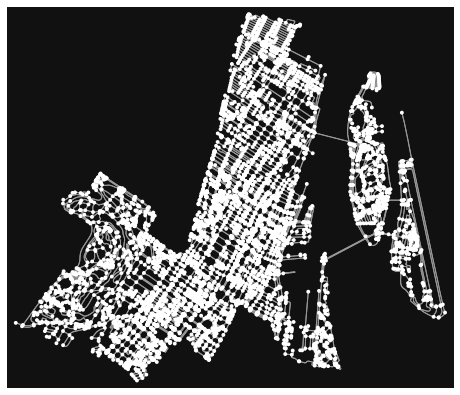

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Outremont, Montreal, Canada


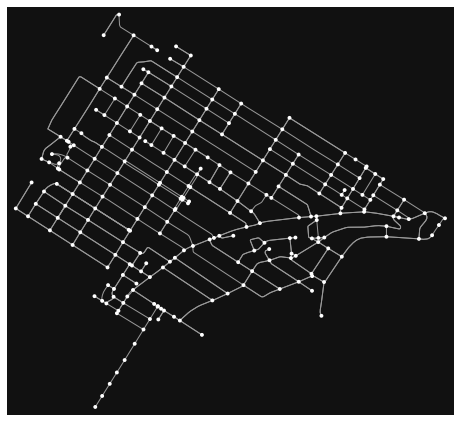

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


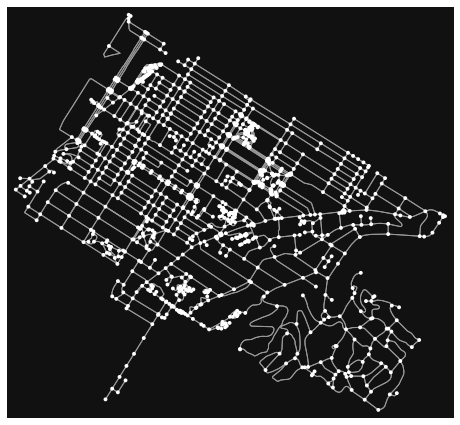

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Le Plateau-Mont-Royal, Montreal, Canada


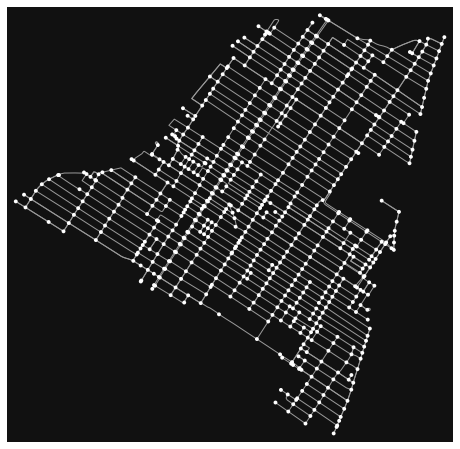

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


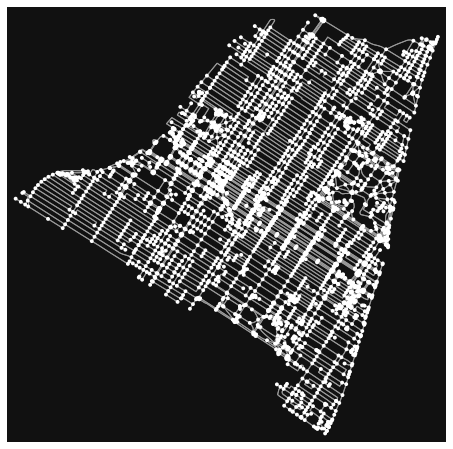

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Rosemont-La Petite-Patrie, Montreal, Canada


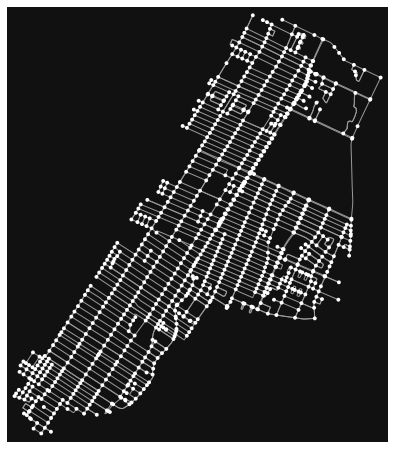

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


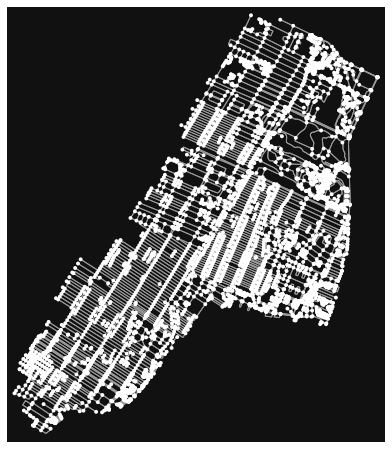

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Hochelaga, Montreal, Canada


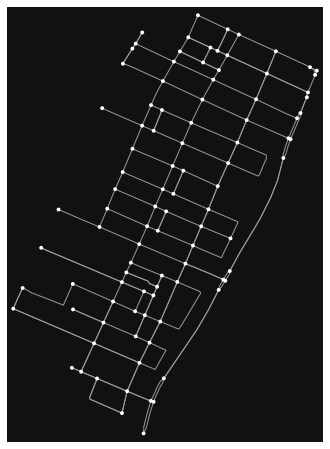

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


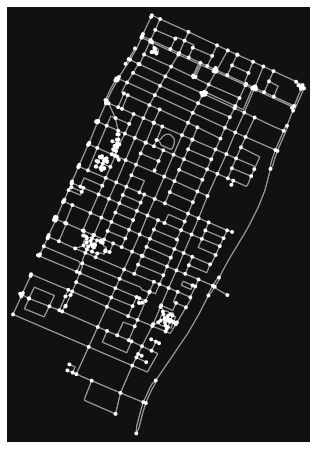

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Maisonneuve, Montreal, Canada


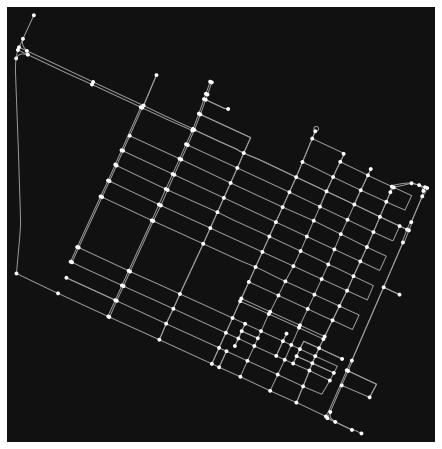

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


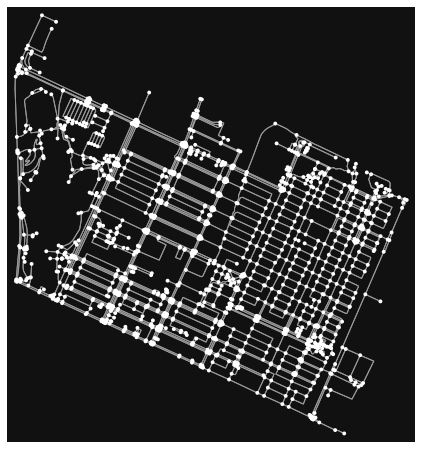

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Anjou, Montreal, Canada


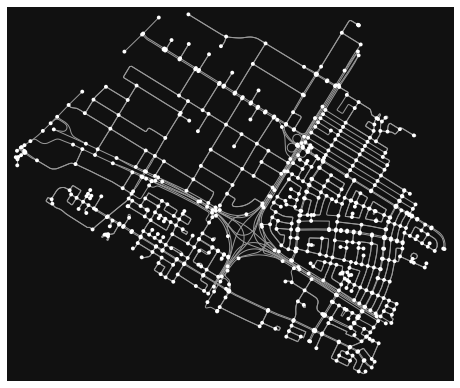

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


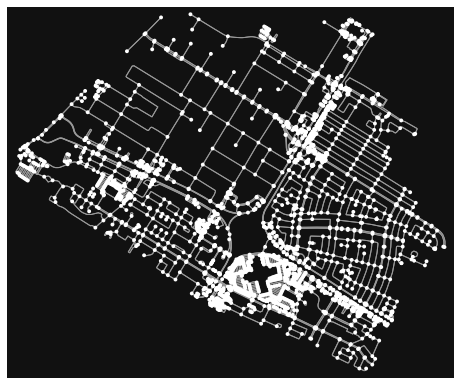

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Rivière-des-Prairies, Montreal, Canada


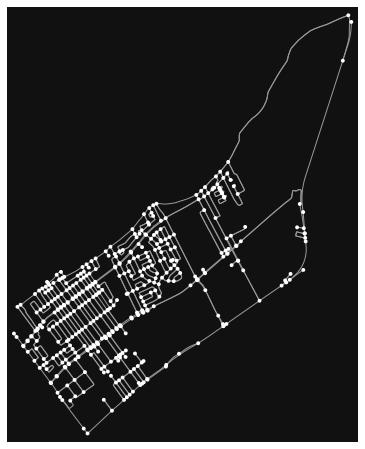

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


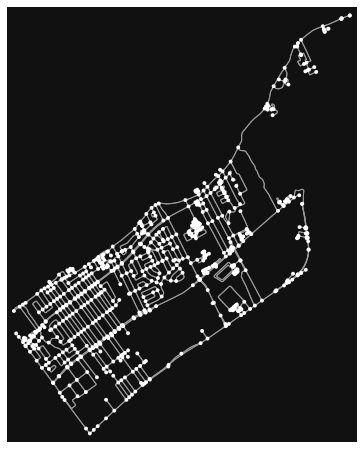

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Pointe-aux-Trembles, Montreal, Canada


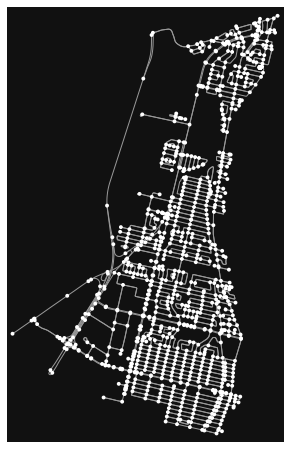

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


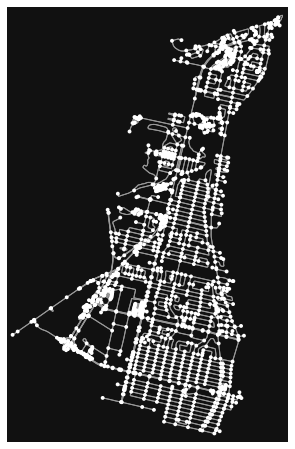

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Montréal-Nord, Montreal, Canada


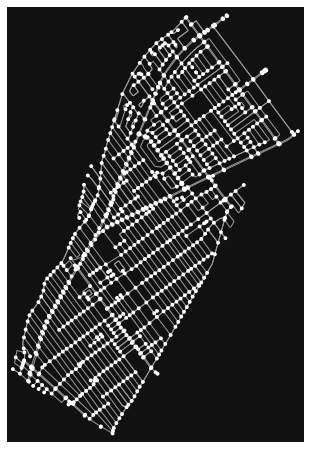

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


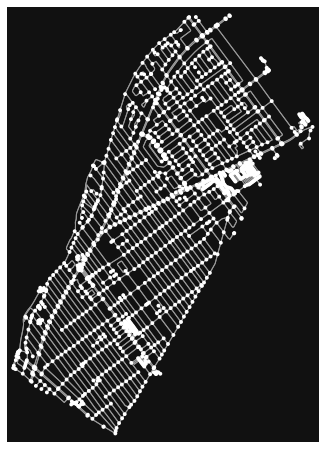

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Saint-Léonard, Montreal, Canada


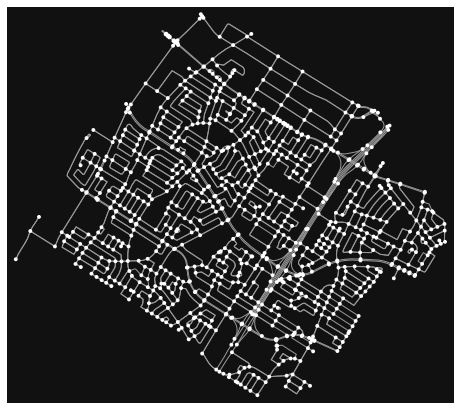

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


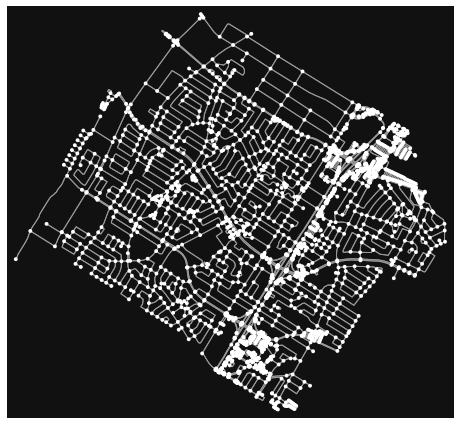

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Villeray-Saint-Michel-Parc-Extension, Montreal, Canada


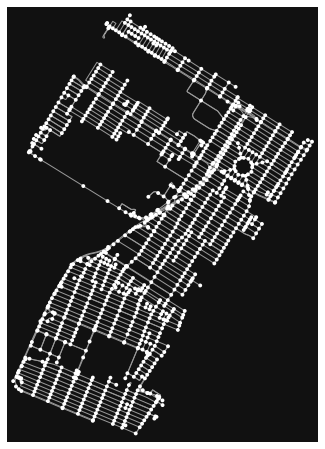

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


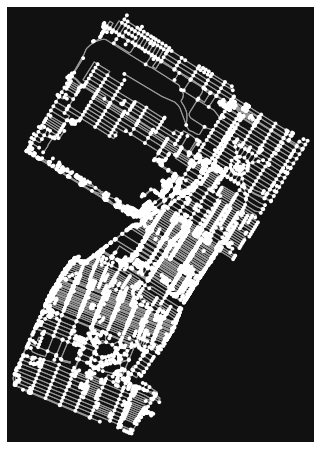

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Ahuntsic, Montreal, Canada


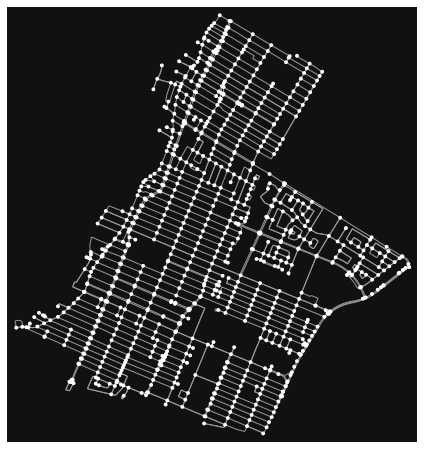

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


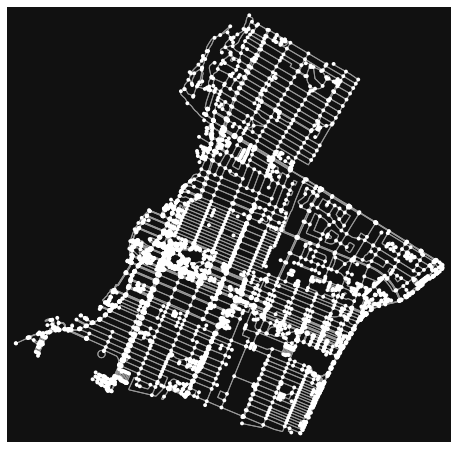

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Cartierville, Montreal, Canada


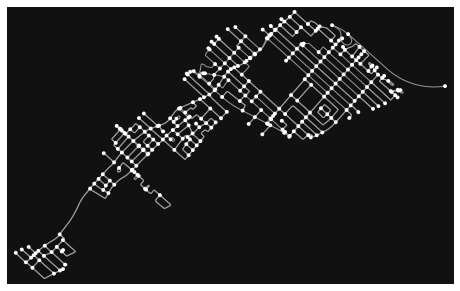

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


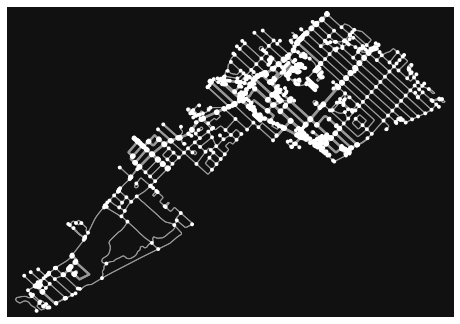

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
Pierrefonds-Roxboro, Montreal, Canada


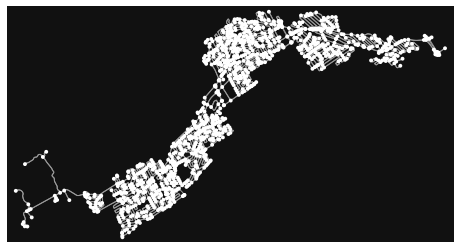

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


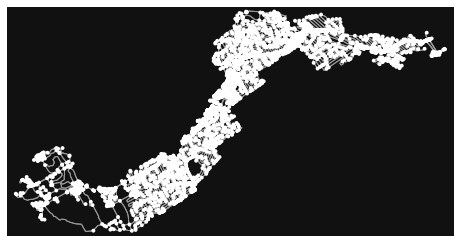

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
L'île-Bizard-Sainte-Geneviève, Montreal, Canada


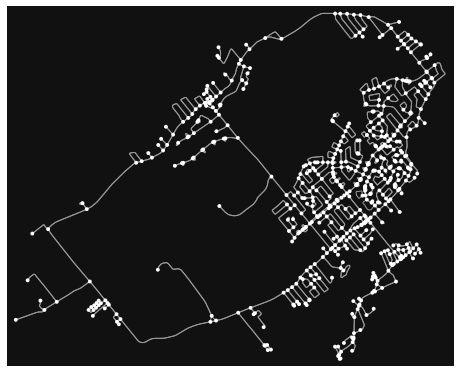

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


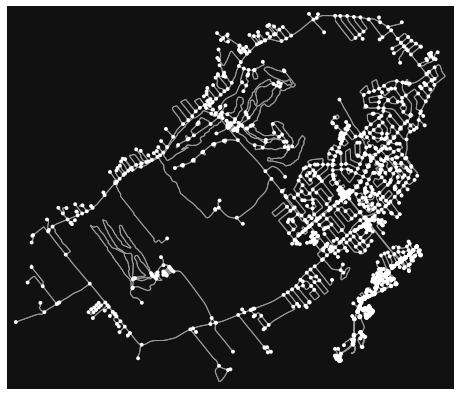

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)


In [10]:
graphs = pull_all_graph(listofquarter)

## Puis on calcule leur taille

In [11]:
(graph_drive, graph_walk) = graphs

drive = find_size_of_each_quarter(listofquarter, graph_drive)
walk  = find_size_of_each_quarter(listofquarter, graph_walk)

Verdun, Montreal, Canada
103030.82699999987
LaSalle, Montreal, Canada
327102.20599999966
Borough of Lachine, Montreal, Canada
266243.77900000056
Saint-Laurent, Montreal, Canada
601857.605999998
Le Sud-Ouest, Montreal, Canada
272056.6470000001
Côte-des-Neiges-Notre-Dame-de-Grâce, Montreal, Canada
359709.7689999996
Ville-Marie, Montreal, Canada
273484.6549999998
Outremont, Montreal, Canada
73699.052
Le Plateau-Mont-Royal, Montreal, Canada
170335.16299999977
Rosemont-La Petite-Patrie, Montreal, Canada
279994.9649999991
Hochelaga, Montreal, Canada
22798.042000000005
Maisonneuve, Montreal, Canada
47705.07299999999
Anjou, Montreal, Canada
238484.23500000016
Rivière-des-Prairies, Montreal, Canada
176728.16299999994
Pointe-aux-Trembles, Montreal, Canada
330629.6569999991
Montréal-Nord, Montreal, Canada
242483.67400000012
Saint-Léonard, Montreal, Canada
319198.91800000076
Villeray-Saint-Michel-Parc-Extension, Montreal, Canada
301796.68999999954
Ahuntsic, Montreal, Canada
247607.03900000005
Cart

## Enfin on calcule l'itenèraire de chaque quartier et chaque deneigeuse

In [12]:
import math

def resolve_function(listofquarter, nb_snowplot, speed_snowplot, drive, walk):
    

    (a_drive, b_drive) = drive
    (a_walk, b_walk) = walk

    speed_deneigeuse = 15

    allsuperficy = a_drive + a_walk
    snowplot_walk = math.floor((nb_snowplot * a_walk) / allsuperficy)
    snowplot_drive = math.floor((nb_snowplot * a_drive) / allsuperficy)

    array_of_quarter_snowplot = divide_nb_snowplot_by_quarter(b_drive, a_drive, snowplot_drive)
    array_of_quarter_snowplot_walk = divide_nb_snowplot_by_quarter(b_walk, a_walk, snowplot_walk)

    show_road_for_each_snowplot(array_of_quarter_snowplot, listofquarter, graph_drive, speed_snowplot)
    show_road_for_each_snowplot(array_of_quarter_snowplot_walk, listofquarter, graph_walk, speed_snowplot)

Verdun, Montreal, Canada : 12
LaSalle, Montreal, Canada : 38
Borough of Lachine, Montreal, Canada : 31
Saint-Laurent, Montreal, Canada : 71
Le Sud-Ouest, Montreal, Canada : 32
Côte-des-Neiges-Notre-Dame-de-Grâce, Montreal, Canada : 42
Ville-Marie, Montreal, Canada : 32
Outremont, Montreal, Canada : 8
Le Plateau-Mont-Royal, Montreal, Canada : 20
Rosemont-La Petite-Patrie, Montreal, Canada : 33
Hochelaga, Montreal, Canada : 2
Maisonneuve, Montreal, Canada : 5
Anjou, Montreal, Canada : 28
Rivière-des-Prairies, Montreal, Canada : 21
Pointe-aux-Trembles, Montreal, Canada : 39
Montréal-Nord, Montreal, Canada : 28
Saint-Léonard, Montreal, Canada : 38
Villeray-Saint-Michel-Parc-Extension, Montreal, Canada : 35
Ahuntsic, Montreal, Canada : 29
Cartierville, Montreal, Canada : 11
Pierrefonds-Roxboro, Montreal, Canada : 58
L'île-Bizard-Sainte-Geneviève, Montreal, Canada : 25
[12, 38, 31, 71, 32, 42, 32, 8, 20, 33, 2, 5, 28, 21, 39, 28, 38, 35, 29, 11, 58, 25]
Verdun, Montreal, Canada : 23
LaSalle,

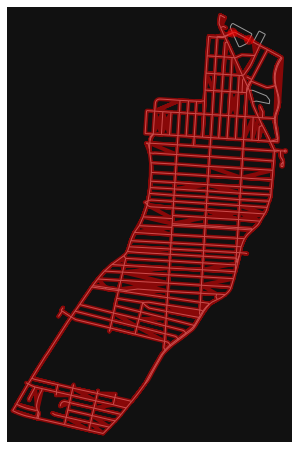

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
[32659924, 4518898500, 1241292882, 4513612526, 32661105, 4513612526, 1241292882, 32661157, 1700518228, 1700518227, 1700518226, 5688217988, 32671564, 32671594, 32661121, 1700518227, 1700518223, 1700518222, 1700518221, 4333637002, 4333637007, 4333637002, 1429448537, 797776010, 797776012, 615101580, 797776012, 615101580, 32661713, 1700534187, 1700534185, 1764284111, 1700525650, 1700525647, 1700525640, 32661253, 32661252, 1700518203, 1700518204, 1700518203, 1700518202, 1700518199, 1700518198, 1700518196, 1700518198, 32661226, 32661227, 1700518199, 1700518202, 32661251, 1700525617, 1700525620, 267966844, 267966817, 1700525645, 1700525649, 1700525656, 32661143, 32661035, 32661036, 207717147, 32661038, 8595141328, 32661735, 1700518225, 1700518228, 32661157, 1241292882, 4518898500, 32659924]


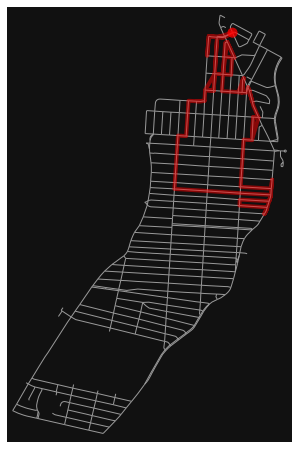

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 8863
time : 35.452 minutes
[32659924, 4518898500, 1241292882, 32661157, 1700518228, 1700518225, 32661735, 8595141328, 32661038, 207717147, 32661036, 32661035, 32661143, 1700525656, 1700525649, 1700525645, 267966817, 267966844, 1700525620, 1700525615, 32661450, 32661453, 618066319, 32661454, 32661477, 32661476, 32661481, 32661482, 1700525594, 1700525610, 1700518194, 1700518193, 1700525594, 1700525584, 1700525592, 1700525582, 1700525580, 1700525578, 1700525576, 1700525573, 32661547, 32661552, 32661553, 32661546, 32661553, 32661554, 32661608, 4333603971, 4333603970, 4333603971, 1700518182, 1700518181, 1700534178, 1700525571, 1700534177, 1700518176, 1700518171, 1700483931, 1700534176, 1700518168, 1700483932, 1700483934, 32661674, 1700518168, 1700483929, 1700483927, 4407950860, 615035069, 4520455505, 1700483902, 4520455505, 615035069, 32661693, 1700483924, 32661679, 32661666, 32661184, 4407950876, 32661183, 32661182, 32661

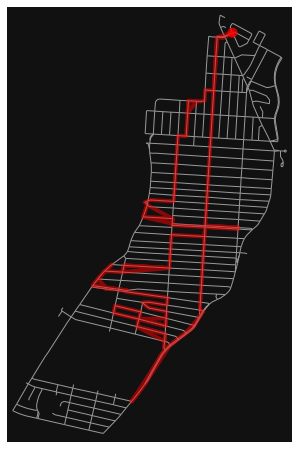

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13924
time : 55.696 minutes
[32659924, 4518898500, 1241292882, 32661157, 1700518228, 1700518225, 32661160, 32661142, 32661161, 32661162, 32661163, 32661164, 207713268, 1700525617, 32661167, 32661168, 32661169, 1700525613, 1700525610, 1700525594, 1700525584, 32661174, 1700534183, 32661176, 32661177, 32661178, 32661179, 32661180, 32661181, 32661182, 32661183, 4407950876, 32661184, 32661666, 32661679, 4520455509, 4520455478, 4520455486, 4520455496, 4520455486, 4520455496, 615035069, 4520455505, 1700483902, 1700483901, 1700483902, 1764284086, 5661984741, 1764284086, 1699728632, 1764284086, 1764284089, 1764284091, 1764284089, 1699718519, 1764284089, 1764284085, 1764284088, 1764284091, 1699714855, 1764284091, 1700534174, 32662151, 1700534174, 1700534173, 1764284090, 1700534173, 1700534172, 1700534173, 1764284088, 1764284084, 1764284082, 1764284084, 1764284081, 1764284084, 1764284080, 1764284076, 5037962584, 1764284076, 1764

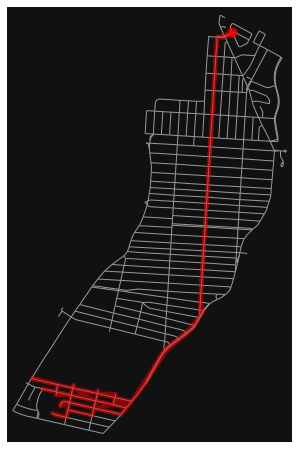

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 14825
time : 59.3 minutes
[32659924, 4518898500, 1241292882, 32661157, 1700518228, 1700518225, 32661160, 32661142, 32661161, 32661162, 32661163, 32661164, 207713268, 1700525617, 32661167, 32661168, 32661169, 1700525613, 1700525610, 1700525594, 1700525584, 32661174, 1700534183, 32661176, 32661177, 32661178, 32661179, 32661180, 32661181, 32661182, 32661183, 4407950876, 32661184, 32661666, 32661679, 1700483924, 32661693, 615035069, 4520455505, 1700483902, 1700483901, 1700483899, 1700457652, 1700457624, 1700457652, 1764284078, 1764284075, 1700457624, 1700457617, 1700457622, 1764284075, 1764284076, 32662184, 1700457622, 32662184, 32662185, 1764259778, 32666877, 32666862, 3713199524, 32662191, 1764259778, 32662185, 32666877, 32666862, 1764284090, 1764284092, 1699728628, 1764284092, 32662156, 1764233569, 32662156, 3713199524, 32662156, 32662151, 1669418209, 615028249, 615035051, 615028249, 248511841, 32764413, 248511841, 615

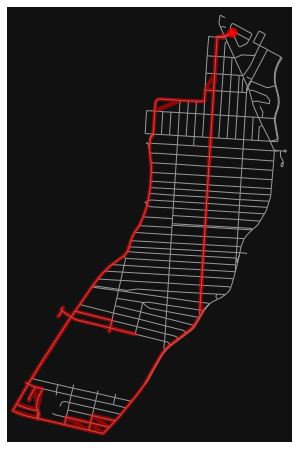

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 15355
time : 61.42 minutes
[32659924, 4518898500, 1241292882, 32661157, 1700518228, 1700518225, 32661735, 8595141328, 32661038, 207717147, 4304495146, 32661716, 615035109, 615035107, 1734380596, 8640521372, 32661355, 32661426, 32661434, 32661435, 32661443, 32661444, 32661453, 32661454, 32661477, 32661491, 32661495, 32661522, 32766750, 32661533, 32661544, 32661546, 32661553, 32661554, 32661608, 32661619, 32661671, 32661674, 32661684, 1700483929, 32661661, 4407950860, 32661693, 615035069, 32661693, 1700483924, 4520455478, 4520455509, 4520455478, 4520455486, 32661693, 1700483924, 1700483927, 1700534176, 32661679, 1700483924, 32661679, 32661666, 32661679, 4520455509, 4520455490, 4520455488, 4520455490, 32661666, 32661184, 4407950876, 32661184, 1700518171, 1700534177, 32661183, 1700518170, 32661183, 4407950876, 4520455476, 4520455491, 4520455476, 4520455488, 32661184, 32661666, 1700483931, 1700483932, 1700518176, 32661659,

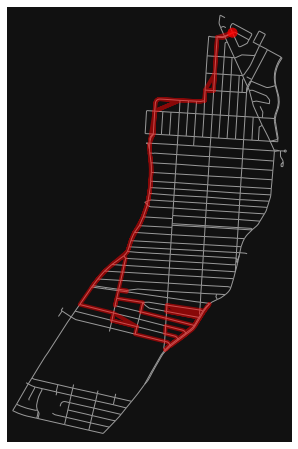

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13127
time : 52.508 minutes
[32659924, 4518898500, 1241292882, 32661157, 1700518228, 1700518225, 32661735, 8595141328, 32661038, 207717147, 4304495146, 32661716, 615035109, 615035107, 1734380596, 8640521372, 32661355, 32661426, 32661434, 32661435, 32661443, 32661444, 32661453, 32661454, 32661477, 32661491, 32661495, 32661522, 32766750, 32661533, 32661544, 32661543, 32661547, 32661552, 32661556, 1700518182, 1700518181, 1700518180, 1700525571, 32661182, 32661183, 4407950876, 4520455491, 32661630, 5037962609, 4407950885, 2201729311, 5037962609, 32661630, 32661182, 32661181, 1700518180, 1700518186, 32661556, 1700518182, 32661622, 4333603970, 32661619, 32661608, 32661554, 32661556, 32661552, 32661551, 1700518186, 32661180, 32661181, 2201729311, 4407950885, 1700518185, 32661550, 1700518185, 32661180, 32661179, 32661550, 32661549, 32671971, 32672036, 1764298494, 32672204, 32662122, 1764298494, 32661535, 32672036, 32671971, 3

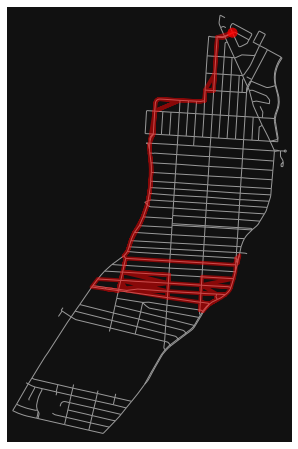

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 14010
time : 56.04 minutes
[32659924, 4518898500, 1241292882, 32661157, 1700518228, 1700518225, 32661735, 8595141328, 32661038, 207717147, 4304495146, 32661716, 615035109, 615035107, 1734380596, 8640521372, 32661355, 32661426, 32661434, 32661435, 32661443, 32661444, 32661453, 32661454, 32661477, 32661491, 32661495, 32661522, 32766750, 32661533, 32661544, 32661546, 32661544, 32661543, 32661544, 32661533, 32766750, 1700525580, 1700534183, 1700518190, 1700518191, 1387494164, 1700518191, 32661524, 32661493, 32661524, 32661493, 32661478, 1700518193, 32661221, 1700525584, 32661174, 1700525582, 32661522, 32661495, 1700525592, 1700525593, 32661491, 1700525593, 32661482, 32661481, 1700525610, 1700525613, 32661475, 32661476, 32661475, 32661458, 32661454, 32661453, 32661444, 1700525615, 32661167, 1700525617, 207713268, 267966844, 1700525620, 32661443, 32661435, 267966844, 267966817, 32661434, 32661426, 32661434, 32661426, 326613

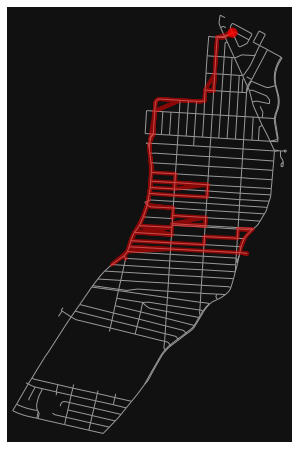

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13684
time : 54.736 minutes
[32659924, 4518898500, 1241292882, 32661157, 1700518228, 1700518225, 32661735, 8595141328, 32661038, 207717147, 4304495146, 32661716, 615035109, 615035107, 1734380596, 8640521372, 32661355, 32661426, 32661434, 32661435, 32661443, 32661444, 32661453, 32661454, 32661477, 32661491, 32661495, 32661522, 32766750, 32661533, 1700525578, 32661176, 32661535, 1700518190, 32661220, 32661524, 1700518191, 32662122, 32672204, 32661549, 32661178, 1700525573, 32661551, 32661179, 32661178, 32661177, 32661176, 1700534183, 32661174, 32661220, 32661221, 32661493, 32661478, 1700518195, 32661478, 1700518194, 32661224, 1700518195, 1700518196, 32661225, 32661226, 32661168, 32661450, 32661458, 32661169, 1700525613, 32661224, 32661225, 32661169, 32661168, 32661167, 1700525617, 207713268, 32661164, 32661163, 32661162, 32661161, 32661142, 32661160, 1700518225, 1700518228, 32661157, 1241292882, 4518898500, 32659924]


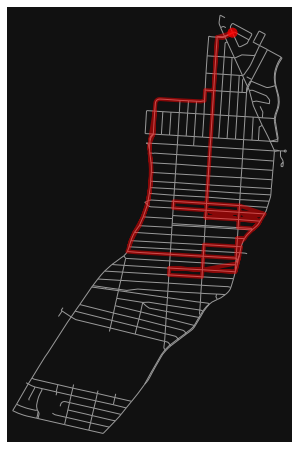

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 11583
time : 46.332 minutes
[32659924, 4518898500, 32671594, 32671564, 32661774, 4333637007, 32661260, 1429448537, 32661256, 1764284111, 1700525650, 1700525647, 1700525640, 32661253, 32661252, 32661251, 32661227, 32661251, 32661252, 207713268, 32661164, 267966817, 1700525645, 1700525649, 32661355, 8640521372, 8640521401, 1734380596, 8640521372, 32661355, 32661426, 1700525645, 32661163, 1700525640, 1700518205, 1700518206, 1700525647, 32661162, 32661163, 32661164, 32661253, 1700518204, 1700518205, 1700518206, 615101629, 32661193, 615101629, 8567460063, 615101635, 1063436042, 1063436042, 615101635, 8567460062, 8567460062, 615101635, 8567460063, 615101632, 32661140, 5230243171, 4333593189, 248413588, 4333593189, 4333592488, 207249223, 4333592488, 5230243171, 615030570, 32661140, 32661136, 32661713, 615101580, 797776012, 797776010, 32661260, 4333637007, 32661774, 32671564, 32671594, 4518898500, 32659924]


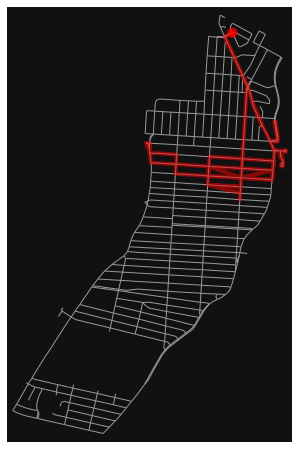

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 9509
time : 38.035999999999994 minutes
[32659924, 4518898500, 32671594, 32671564, 32661774, 4333637007, 32661260, 797776010, 797776012, 615101580, 32661713, 32661136, 1700518211, 32661136, 1700518211, 1700534185, 1700534187, 32661256, 1764284111, 1764291994, 1700518214, 1764291994, 32661129, 32661256, 1429448537, 32661260, 615101597, 207249254, 207249241, 207249254, 615101663, 267969149, 615101663, 248413240, 32661266, 32661263, 1411570354, 32661263, 615101597, 797776010, 32661260, 4333637007, 32661774, 32661131, 1700518221, 32661129, 1700518216, 1700518222, 1700518226, 32661131, 32661774, 32671564, 32659930, 32661774, 32659930, 32659931, 9170658219, 32659931, 32661266, 248413240, 248413711, 267969149, 248413592, 248413589, 32661715, 32661714, 32661713, 615101580, 797776012, 797776010, 32661260, 4333637007, 32661774, 32671564, 32671594, 4518898500, 32659924]


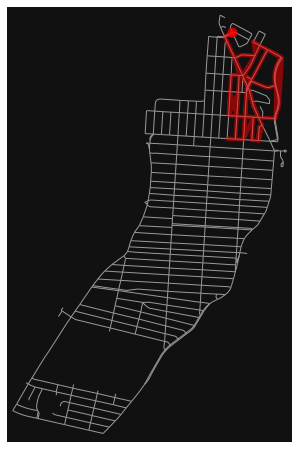

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 9320
time : 37.28 minutes
[32659924, 4518898500, 32671594, 32671564, 32661774, 4333637007, 32661260, 615101597, 207249254, 207249241, 248413592, 207249241, 32661715, 248413589, 248413588, 207249223, 32661715, 32661714, 615101577, 32661714, 32661713, 32661136, 32661140, 615101632, 32661193, 1700525650, 32661161, 32661142, 32661160, 32661118, 1700518216, 1700518214, 32661117, 32661142, 32661100, 32661142, 32661117, 32661118, 1700518223, 1700518225, 32661735, 8595141328, 32661101, 32661100, 32661040, 32661041, 32661161, 32661162, 1700525649, 1700525656, 1734380596, 615035107, 615035109, 615035107, 615035109, 5342978418, 1764298498, 32661716, 4304495146, 207717147, 4304495146, 4304495144, 32661036, 207717147, 32661038, 8595141328, 32661735, 1700518225, 1700518228, 32661157, 1241292882, 4518898500, 32659924]


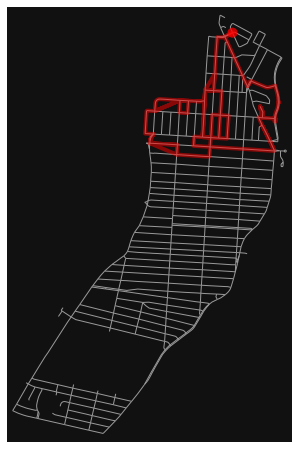

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 8962
time : 35.848 minutes
[32659924, 4518898500, 1241292882, 32661157, 1700518228, 1700518225, 32661735, 8595141328, 32661038, 207717147, 32661036, 207717147, 32661038, 8595141328, 32661038, 32661039, 32661040, 32661035, 32661040, 32661041, 1700525656, 32661143, 5422994804, 32661031, 5422994804, 32661033, 32661032, 32661716, 615035109, 32661031, 32661032, 32661033, 4304495144, 32661143, 32661035, 32661036, 32661039, 32661101, 32661160, 1700518225, 1700518228, 1700525677, 32661735, 1700525677, 32661105, 32661157, 32661121, 5688217988, 32661121, 32671594, 4518898500, 1411570408, 1411570220, 1691949953, 1691955325, 1691949953, 1411570220, 1411570418, 1411570220, 1411570408, 32661156, 1241292882, 4518898500, 32659924]


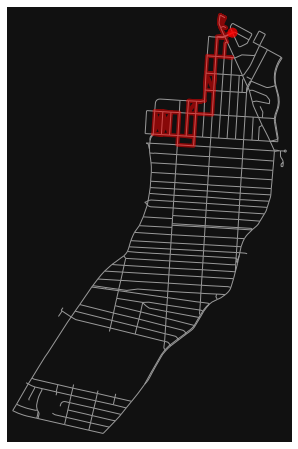

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 7210
time : 28.84 minutes
====================== LaSalle, Montreal, Canada =======================
The graph is eulerian : True
[32662002, 1763614941, 1700308937, 1700308942, 1700308945, 9813465893, 1700268685, 1700268686, 9838796576, 1700268686, 5277798976, 1700268686, 1700308951, 1763614964, 1700308951, 1700308948, 1700268685, 1763614975, 1700268685, 9813465893, 32733797, 9813465893, 32733797, 5139980420, 9534569856, 4059882019, 4488600990, 4059882019, 9534569856, 9534570035, 612002133, 9534616009, 4059882019, 4488600990, 9534569834, 9535891379, 9535902829, 9535891379, 9535902979, 1209147513, 9535902829, 286442627, 286442699, 286442627, 286442699, 286442620, 286444110, 286442603, 286442620, 286444312, 286444294, 9535902861, 9535891363, 9535902861, 4753144411, 1209147513, 248512064, 286442603, 286444110, 286443580, 9534570035, 612002133, 4059882019, 1209147560, 290748904, 290749417, 290748904, 290747828, 290748490, 2

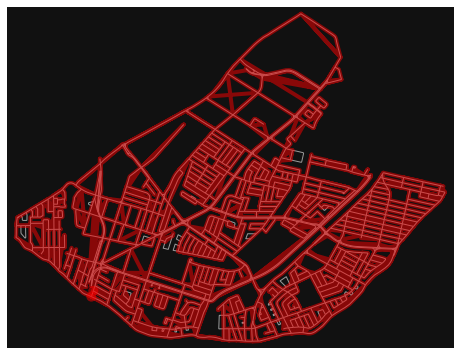

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
[32662002, 1763614941, 1700308937, 1700308942, 1700308945, 9813465893, 1700268685, 1700268686, 9838796576, 1700268686, 5277798976, 1700268686, 1700308951, 1763614964, 1700308951, 1700308948, 1700268685, 1763614975, 1700268685, 9813465893, 32733797, 9813465893, 32733797, 5139980420, 9534569856, 4059882019, 4488600990, 4059882019, 9534569856, 9534570035, 612002133, 9534616009, 4059882019, 4488600990, 9534569834, 9535891379, 9535902829, 9535891379, 9535902979, 1209147513, 9535902829, 286442627, 286442699, 286442627, 286442699, 286442620, 286444110, 286442603, 286444110, 286443580, 9534570035, 612002133, 4059882019, 1209147560, 290748904, 290747828, 32761809, 32772261, 32772101, 32662002]


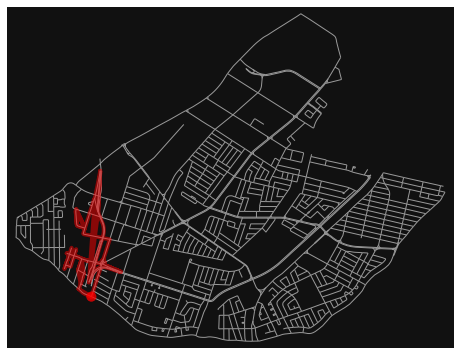

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 9247
time : 36.98799999999999 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 612002133, 9534570035, 286443580, 248512751, 286444312, 286442620, 286444312, 286444294, 9535902861, 9535891363, 9535902861, 4753144411, 1209147513, 248512064, 286442603, 286444110, 286443580, 9534570035, 612002133, 4059882019, 1209147560, 290748904, 290749417, 290748904, 290747828, 290748490, 290747828, 290748904, 1209147560, 9534569856, 5139980420, 290740172, 5139980420, 290740058, 9535087433, 290740058, 4326571705, 290740058, 5139980420, 32733797, 1700308942, 290740172, 290739844, 9534963890, 290739844, 1700308937, 1763614941, 1700308916, 1700308945, 1700308916, 1700268623, 1700308948, 1700268623, 1700308916, 1763614941, 32662002]


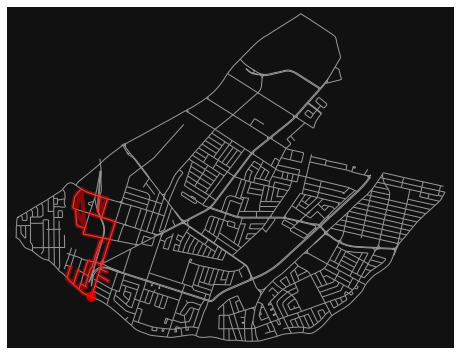

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 8619
time : 34.476 minutes
[32662002, 1763614941, 1700308916, 1700268623, 1700268636, 286267928, 286267929, 286268319, 286267929, 286266908, 286267929, 286267645, 286267259, 286267928, 286266201, 286267928, 1700268636, 5015619232, 1700228921, 5015619232, 286267259, 286266523, 286266522, 286266293, 286266522, 286264075, 286266192, 286266189, 286266192, 286266523, 1700228921, 1700228922, 286265768, 1700228922, 5015611570, 285902342, 8618978129, 248512387, 5580840649, 248512387, 248512388, 285902386, 248512388, 285902386, 248512389, 286264628, 286264636, 286264628, 286264073, 286264075, 286266192, 286265768, 1700228922, 1700228921, 5015619232, 1700268636, 1700268623, 1700308916, 1763614941, 32662002]


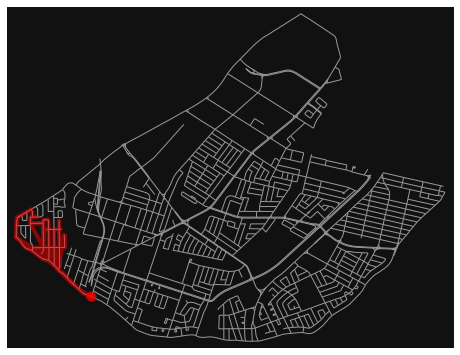

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 8383
time : 33.532 minutes
[32662002, 1763614941, 1700308916, 1700268623, 1700268636, 5015619232, 1700228921, 1700228922, 286265768, 285902517, 285902532, 285902516, 285902342, 285902516, 285902532, 285902517, 286264073, 286264075, 286266522, 286267645, 4732239486, 4732239488, 4732239488, 4732239486, 286268602, 286267941, 286268314, 286268702, 286268601, 286268387, 286268702, 286268314, 286768348, 286267262, 286267492, 286264447, 286264636, 286264772, 248512389, 286264772, 286264447, 286267492, 286268602, 286267941, 286268387, 286268601, 286267262, 286768348, 248511987, 612002376, 3833422939, 248511997, 612002381, 612002382, 612002381, 286270655, 286271657, 286270655, 248512104, 248512103, 286445094, 4526362273, 248512070, 248512751, 286443580, 9534570035, 612002133, 4059882019, 1209147560, 290748904, 290747828, 32761809, 32772261, 32772101, 32662002]


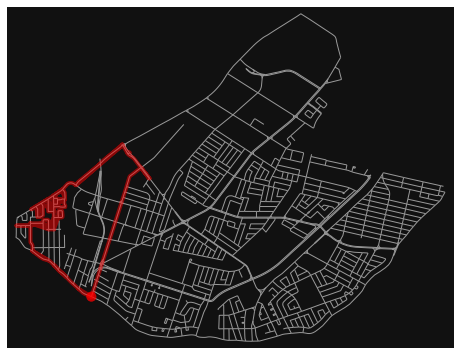

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 9911
time : 39.644 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 612002133, 9534570035, 286443580, 248512751, 248512070, 4526362273, 286445094, 248512103, 248512104, 286270655, 286271657, 286444697, 286445128, 286444697, 9824030929, 286444697, 286271657, 248512109, 248512113, 248512109, 612002382, 5135728178, 612002386, 5135728178, 248511998, 612002386, 32821570, 612002386, 3833422945, 248511998, 248511997, 612002376, 248511987, 248512064, 1209147513, 4753144411, 9535902947, 4203554371, 9535902947, 9535891363, 9534570145, 32771539, 9534615956, 290735866, 4488600990, 290735866, 290735827, 4375720438, 290735829, 1764233540, 1764233536, 1764233540, 1764233561, 32733137, 1764233561, 1763614953, 1763614970, 1763614969, 1763614956, 1763614944, 1763614953, 1764233561, 32733137, 1763614954, 1763614960, 290735827, 290735866, 4488600990, 4059882019, 1209147560, 290748904, 2907478

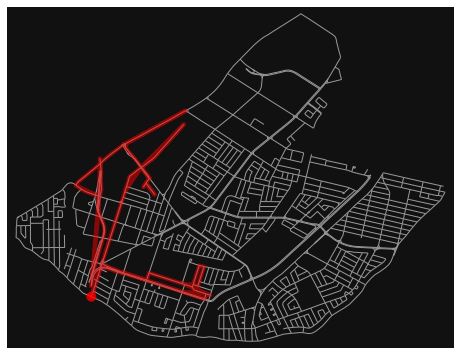

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 16430
time : 65.72 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 4488600990, 290735866, 290735827, 1763614960, 1763614954, 1763614971, 1763614970, 1763614969, 1763614967, 1763614955, 1763614967, 1763614966, 1763614952, 1763614966, 1764233567, 1763614963, 1764233567, 1763614949, 1763614952, 1763614955, 1763614956, 1763614944, 1763614953, 1763614970, 1763614971, 1763614971, 1763614954, 1763614960, 291682228, 1763614960, 1763614954, 32733137, 4375720438, 290732133, 32733896, 1763626789, 1763626789, 32733896, 32733872, 1763626794, 1763626794, 32733872, 32733825, 1764233556, 1763626781, 1764233556, 1763626774, 1763626772, 1764233546, 1763626781, 1763626772, 1764233546, 1764233544, 1763626782, 1764233544, 1764233546, 1763626772, 1763626774, 1763626766, 1763614928, 1763626751, 1700338630, 1700338632, 5015624885, 32662002]


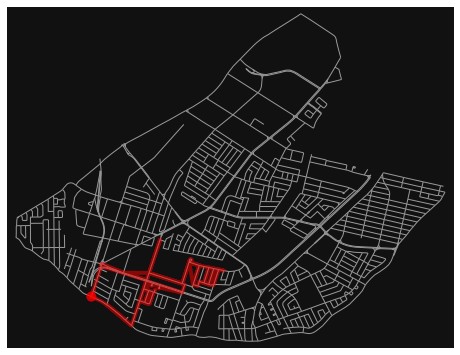

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 10784
time : 43.136 minutes
[32662002, 5015624885, 1700338632, 1700338630, 1763626751, 1763614928, 1763626766, 1763626774, 1763626772, 1764233546, 1764233544, 1763626780, 1763626779, 1763626778, 1763626779, 1763626767, 1763626780, 1763626767, 1763626778, 32733134, 1763626761, 1763626760, 1763626761, 1763626752, 1763626761, 32733134, 290732133, 290733840, 32733801, 1704424019, 1704424056, 1764233495, 1764233505, 1763626758, 1764233505, 1763626750, 1763626758, 1763626760, 1764233526, 1763626775, 1764233526, 32731985, 1764233495, 32731985, 290733840, 290735829, 1700544992, 612762778, 612761406, 612762778, 612762780, 558662424, 1669418056, 9824110654, 1669418030, 1699956974, 3713187330, 1699956976, 1699956978, 1699956976, 3713187330, 1699956974, 371751987, 558665203, 286460147, 618066213, 371751959, 371751950, 286459820, 2155510779, 371751078, 371756066, 248513377, 371756076, 371756083, 612002343, 1427593080, 612002335, 6

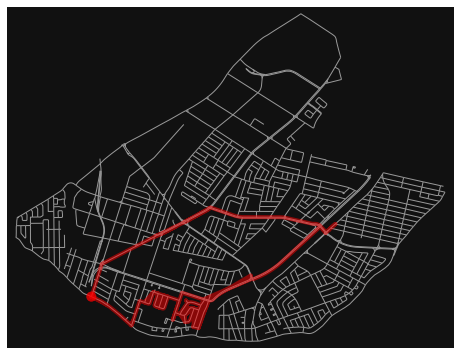

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13012
time : 52.048 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002211, 612002209, 3709797034, 612002218, 612002236, 612002235, 612002245, 612002276, 612002338, 612002335, 1427593080, 612002343, 371756083, 371756076, 248513377, 371756066, 371751078, 2155510779, 286459820, 371751950, 371751959, 618066213, 286460147, 558665203, 371751987, 1699956974, 3713187330, 1699956976, 1699956978, 1699956981, 1699956985, 1699956987, 1699956985, 1699956983, 1699956980, 1699956981, 1699956978, 1699956977, 1699956980, 618066275, 1763615000, 1764291954, 1764291956, 1764291958, 1700457565, 1700457561, 1764291956, 1763615003, 1763615000, 1763614987, 1700457554, 1764291954, 1700457558, 1427796281, 1700457558, 1700457561, 1700457565, 1700457568, 3713199523, 1700457568, 32662338, 1764291

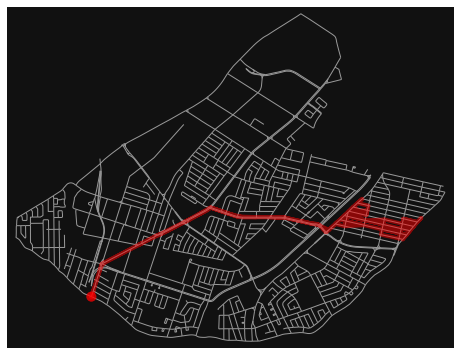

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 14435
time : 57.74 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002211, 612002209, 3709797034, 612002218, 612002236, 612002235, 612002245, 612002276, 612002338, 612002335, 1427593080, 612002343, 371756083, 371756076, 248513377, 371756066, 371751078, 2155510779, 286459820, 371751950, 371751959, 618066213, 286460147, 558665203, 371751987, 1699956974, 3713187330, 1699956976, 1699956978, 1699956981, 1699956985, 1699956987, 1764291960, 32662335, 618066277, 32662337, 32662338, 32662331, 32662332, 618066278, 618066279, 618066285, 32662325, 32662312, 32662325, 32662326, 618066279, 32662328, 1764291962, 1764291964, 1764284058, 1764284063, 1764284058, 3713199519, 1700457603, 3713199519, 1700457598, 1700457586, 1764291962, 32662331, 3713199523, 1700457586, 1700457598, 17642919

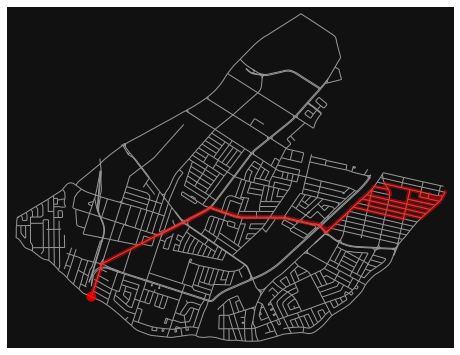

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 17595
time : 70.37999999999998 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002211, 612002209, 3709797034, 612002218, 612002236, 612002235, 612002245, 612002276, 612002338, 612002335, 1427593080, 612002343, 371756083, 371756076, 248513377, 371756066, 371751078, 2155510779, 286459820, 371751950, 371751959, 618066213, 286460147, 558665203, 371751987, 1699956974, 3713187330, 1699956976, 1699956978, 1699956981, 1699956985, 1699956987, 1764291960, 32662335, 32662334, 32662326, 32662325, 32662312, 3713187332, 32662278, 32662201, 5359473352, 32662198, 32662199, 1764284070, 1764284062, 1764284073, 1699668388, 1764284073, 1764284074, 32662194, 1764284074, 1764284070, 1764284062, 1764284059, 1700457610, 1764284059, 1764284060, 1764284061, 1764284070, 32662199, 32664655, 17636

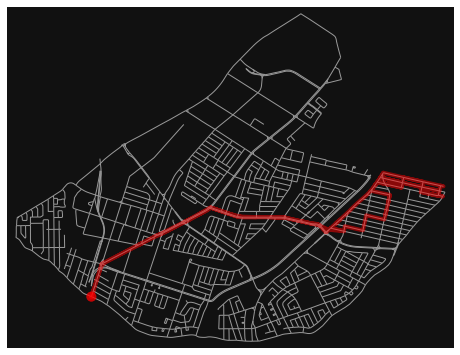

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 15554
time : 62.216 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002211, 612002209, 3709797034, 612002218, 612002236, 612002235, 612002245, 612002276, 612002338, 612002335, 1427593080, 612002343, 371756083, 371756076, 248513377, 371756066, 371751078, 2155510779, 286459820, 371751950, 371751959, 618066213, 286460147, 558665203, 371751987, 1699956974, 5413935313, 5413935314, 5413935310, 1669418006, 5413935314, 1669418030, 1669418008, 9824110654, 1669418056, 371751987, 4371514297, 618066294, 4504080414, 9337725680, 9337725672, 4504080414, 618066290, 32821585, 618066290, 9337725672, 286457747, 286457988, 286457747, 286458282, 1432318678, 1432318678, 286458282, 286457743, 286458514, 286458485, 286457742, 286458485, 286457743, 286458514, 286458321, 9301150625, 286458321, 

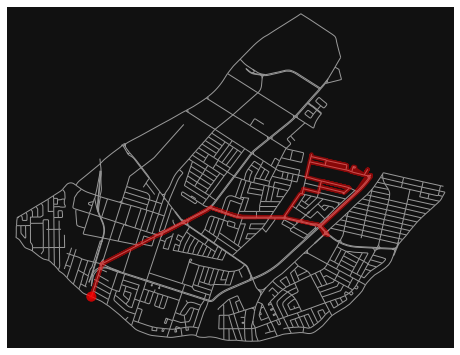

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 15099
time : 60.396 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002211, 612002209, 3709797034, 612002218, 612002236, 612002235, 612002245, 612002276, 612002338, 612002335, 1427593080, 612002343, 371756083, 371756076, 248513377, 371756066, 371751078, 2155510779, 286459820, 371751950, 371751959, 618066216, 5414078806, 286461778, 5414078810, 5414078813, 5414078816, 286461551, 286460694, 618066271, 286459819, 286460219, 3709575829, 286460219, 3709575829, 32821585, 2155510803, 2155510801, 286461691, 286461717, 286461641, 286461717, 286461641, 286461551, 5414078816, 5414078813, 5414078810, 5414078813, 5414078816, 286461551, 286460694, 618066271, 618066269, 286459819, 618066269, 286461691, 2155510801, 8274083703, 286461778, 5414078810, 5414078808, 5414078806, 286461778, 5

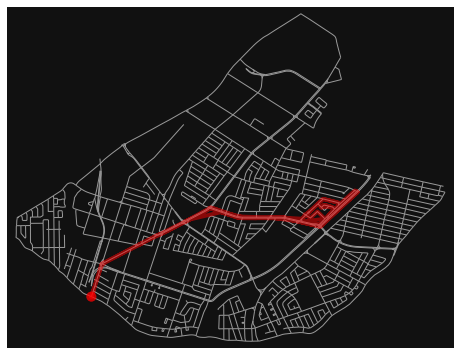

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13896
time : 55.583999999999996 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002211, 612002209, 3709797034, 612002218, 612002236, 612002235, 612002245, 612002276, 612002338, 286455648, 286455329, 286455481, 248513376, 286455833, 4502307438, 32822010, 2704423269, 1382176517, 618066212, 286460834, 1382176514, 286460859, 1382176514, 286460834, 618066210, 618066212, 618066210, 286461068, 286461032, 286460886, 286461032, 286460867, 286461068, 286460867, 286460886, 286460859, 1700545026, 32764514, 1700545026, 286454975, 558665203, 371751987, 1699956974, 5413935313, 4526270686, 4526270687, 4526270684, 32664522, 4526270684, 371764551, 618066252, 618066254, 371773129, 1700457553, 371774154, 1669417960, 1669417962, 618066258, 1669417960, 4526330145, 1387513132, 1427796324, 14

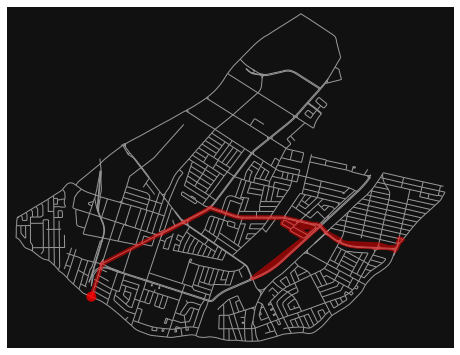

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 15389
time : 61.556 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002211, 612002209, 3709797034, 612002218, 612002236, 612002235, 612002245, 612002276, 612002338, 612002335, 1427593080, 612002343, 371756083, 371756076, 248513377, 371756066, 371751078, 2155510779, 286459820, 371751950, 371751959, 618066213, 286460147, 558665203, 371751987, 1699956974, 3713187330, 1699956976, 1699956975, 618066272, 32663000, 32663001, 1387513127, 32663001, 32663000, 618066252, 32663000, 618066272, 1857942218, 618066272, 618066273, 1763614987, 32663000, 618066272, 1699956975, 4526270687, 32664522, 4526270686, 32664522, 2260946161, 1669418006, 5413935310, 5413935822, 1669418008, 5413935822, 618066206, 2251119435, 2260946074, 1699956970, 1699956961, 248513218, 1699956961, 1699956957, 1764

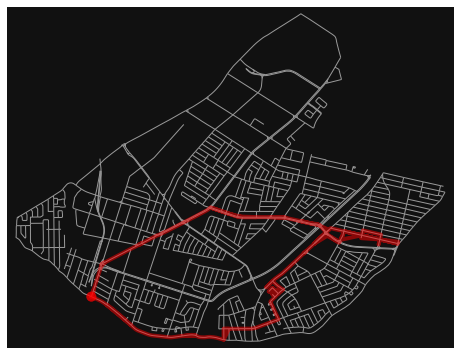

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13265
time : 53.06000000000001 minutes
[32662002, 5015624885, 1700338632, 1700338630, 1700549619, 5015624905, 32662023, 5015624911, 1700105812, 32663142, 32663010, 32663056, 1700105813, 1700228887, 32663072, 1700105816, 1700228893, 1700105828, 1700105830, 1764259716, 1764259719, 1764259716, 1700105830, 1700105828, 1700228893, 1700105816, 1700228893, 1700105828, 1700105830, 1700105834, 1700228901, 1700105848, 1700228901, 1699956953, 1764284043, 1764259766, 1764259769, 1764259773, 1764259776, 1764259766, 1764284043, 1699956954, 1700105834, 1764284019, 1764298487, 1764284019, 32663243, 1764284025, 1764284020, 1764284025, 1764284026, 1764284027, 1764284022, 1764259705, 1764259707, 1764259715, 1764259707, 1764259715, 32663266, 32664043, 5015630493, 5015688566, 5015630493, 1764284021, 1764284026, 1700105848, 1700105852, 1763572591, 1700105852, 1700105848, 1700228901, 1700105834, 1700105830, 1700105828, 1700228893, 170010581

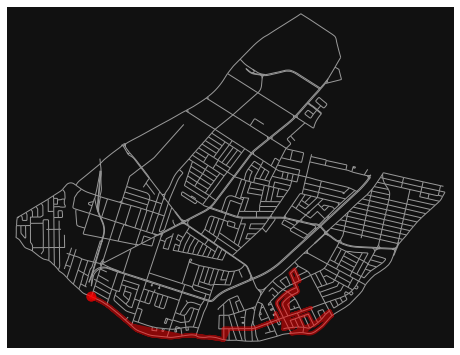

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 12443
time : 49.772 minutes
[32662002, 5015624885, 1700338632, 1700338630, 1700549619, 5015624905, 32662023, 5015624911, 1700105812, 32663142, 32663010, 32663056, 1700105813, 1700228887, 32663072, 1700105816, 1700228893, 1700105828, 1700105830, 1700105834, 1700228901, 1700105848, 1700105852, 1764259737, 1700105873, 1764259737, 1700105859, 1700105864, 1700105859, 1700105873, 1699956953, 1699956954, 1699956957, 1764259759, 1764259762, 1764259759, 1764259762, 1764259766, 1764259776, 1669417935, 1699956970, 2260946074, 618066208, 2251119435, 618066206, 618066208, 2260946062, 2260946101, 32664455, 2260946101, 32664457, 1764284055, 1764284054, 1764284053, 32664451, 1857942185, 32664209, 32664199, 32664209, 1764284050, 32664203, 1857942185, 32664207, 1764284048, 32664206, 1763567144, 32664574, 32664664, 32664574, 32664664, 32664096, 32664082, 32664079, 32663484, 6376146251, 32670824, 32663482, 32663481, 32663480, 32663479, 1

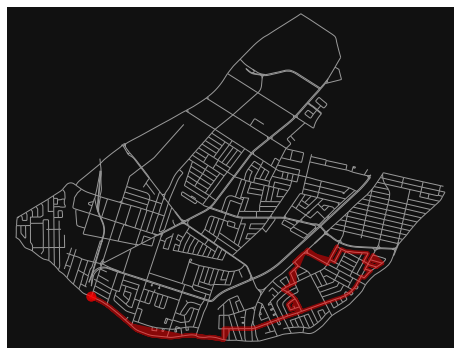

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 12652
time : 50.608 minutes
[32662002, 5015624885, 1700338632, 1700338630, 1700549619, 5015624905, 32662023, 5015624911, 1700105812, 32663142, 32663010, 32663056, 1700105813, 1700228887, 32663072, 1700105816, 1700228893, 1700105828, 1700105830, 1700105834, 1700228901, 1700105848, 1700105852, 1763572591, 32663479, 32663480, 32663481, 32663482, 32670824, 6376146251, 32663484, 32664079, 32664082, 32664096, 1764259758, 1764259763, 32664042, 1764259763, 1764259767, 32664041, 1764259767, 1764284045, 1764259770, 1764259764, 1764259770, 32664094, 32664093, 32664094, 32664222, 32664088, 32664223, 1764259758, 32664096, 32664082, 32664079, 32664082, 32664079, 32663484, 6376146251, 32663484, 6376146251, 32670824, 32663482, 32670824, 1764284034, 1764284031, 1764284034, 32663482, 32663481, 1764284031, 32663480, 32663481, 32663480, 32663479, 32664042, 32664041, 1764259757, 1764259761, 1764259757, 32664039, 1764259769, 1764259766, 17

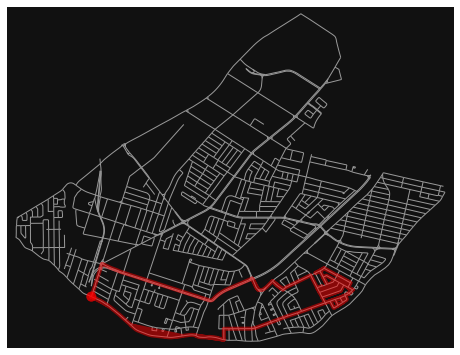

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13108
time : 52.432 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 4488600990, 290735866, 290735827, 4375720438, 290735829, 1700544992, 612762778, 612762780, 558662424, 248513118, 248513218, 1699956961, 1699956957, 1764259759, 1764259762, 1764259766, 1764259769, 1764259773, 32664036, 1669417935, 32664036, 32664039, 32664093, 1764259761, 1764259764, 1764284045, 32664088, 32664222, 2260946062, 32664462, 32664157, 32664457, 1764284055, 32664455, 2260946161, 1669417965, 618066235, 1669417965, 1669417964, 1387513135, 618066256, 1669417964, 371764551, 618066254, 371773129, 371774154, 1387513132, 4526330145, 32662079, 32662066, 32662079, 618066258, 1669417962, 618066256, 1387513135, 618066235, 32664199, 1764284050, 32664203, 1764284048, 32664207, 32664206, 32664495, 32664451, 1764284053, 1764284054, 1764284055, 32664455, 2260946161, 1669418006, 5413935314, 1669418030, 982411065

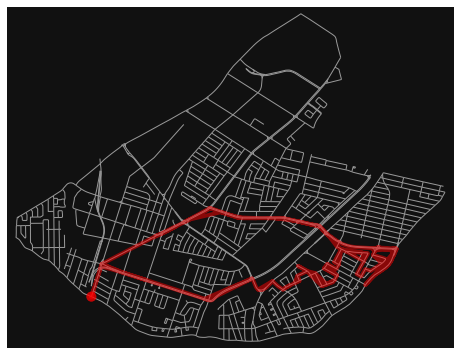

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 14488
time : 57.952 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002211, 612002209, 3709797034, 612002218, 612002236, 612002235, 612002245, 612002276, 612002338, 286455648, 286455329, 286455481, 248513376, 286455833, 4502307438, 32822010, 2704423269, 1382176517, 618066212, 286460834, 1382176514, 286454975, 1669418056, 9824110654, 1669418030, 5413935314, 1669418006, 2260946161, 32664455, 1764284055, 1764284054, 32664452, 1764284049, 32664464, 1764284049, 32664465, 32664466, 32664465, 32664158, 32664495, 32664451, 32664452, 1764284054, 32664464, 32664466, 32664157, 32664158, 1764284047, 32664101, 1764284047, 32664087, 32664462, 32664087, 32664088, 32664223, 32664101, 1763567144, 32662066, 32664043, 32663266, 32663479, 1763572591, 1764259705, 1764284022, 1764284018, 17

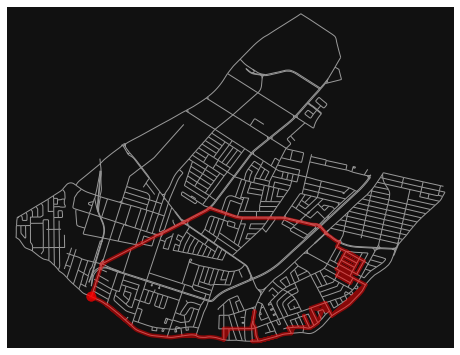

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13973
time : 55.892 minutes
[32662002, 5015624885, 1700338632, 1700338630, 1700549619, 5015624905, 32662023, 5015624911, 1700105812, 1700105838, 32663011, 32663623, 1764259721, 32663621, 32663064, 1764259735, 1700549631, 1700228916, 1700549631, 1700549630, 1700228897, 1700228887, 1700228879, 1700228878, 5015625526, 1700228878, 1700105813, 3709964057, 32663061, 3709964057, 32663061, 1700105835, 1700105836, 1700105835, 32663064, 1764259735, 32663064, 32663621, 1764259721, 32663621, 32663497, 32663054, 32663497, 1764259721, 32663623, 32663054, 32663619, 1764233493, 32663619, 1700105838, 1700105812, 1700105838, 32663011, 32663623, 32663056, 5015625526, 5015625521, 32663010, 32663011, 32663010, 5015625521, 32662032, 32663142, 1700105812, 5015624911, 32662023, 5015624905, 1700549619, 1700338630, 1700338632, 5015624885, 32662002]


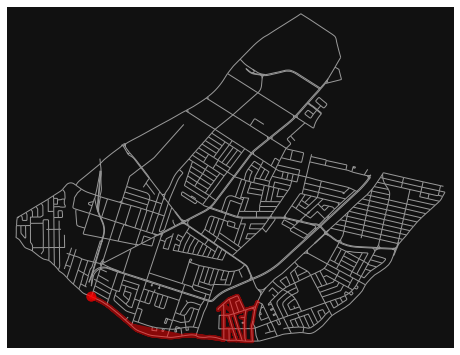

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 10619
time : 42.476 minutes
[32662002, 5015624885, 1700338632, 1700338630, 1700549619, 5015624905, 32662023, 5015624911, 1700105812, 5015624911, 32662023, 1704424019, 1704424056, 1704424053, 1704424046, 1704424053, 1704424046, 1704424022, 1704424046, 1763626750, 1763626752, 1704424106, 1704424109, 1704424109, 1704424106, 1704424004, 1704424006, 1704424008, 8540810779, 1704424008, 1704424006, 8540810779, 1704424022, 5015624905, 1700549619, 1704424004, 1704424011, 1704424013, 1704424011, 1704424013, 1704424037, 1704424059, 1704424037, 1704424059, 1763626749, 1763626766, 1763626749, 1763626751, 1700338630, 1763626751, 1763614928, 1763626766, 1763626774, 1763626777, 1763614930, 1763626777, 1763614930, 1763614934, 32761807, 32771497, 32772262, 1763567139, 5015624885, 32662002]


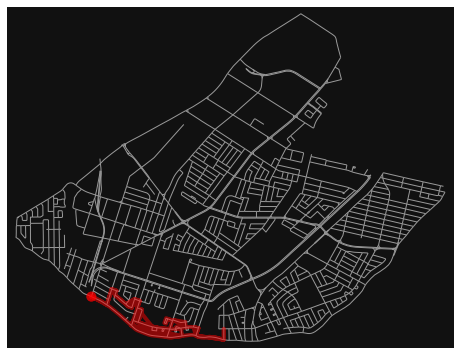

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 8093
time : 32.372 minutes
[32662002, 5015624885, 1763567139, 32772262, 32771497, 32761807, 1763614950, 1763614943, 1764233552, 1763614943, 1764233552, 1763614958, 32762453, 9534615956, 32771539, 32771497, 32772262, 32772261, 32772262, 1763567139, 5015624885, 32662002, 5015624885, 1700338632, 1700338636, 1700338632, 1700338630, 1700549619, 5015624905, 32662023, 5015624911, 32662032, 32663142, 32663010, 32663056, 1700105813, 1700228887, 32663072, 1700105816, 32665040, 1764259700, 32665040, 32663227, 32662041, 32663227, 1700228893, 32664444, 1764259710, 1764259722, 1764259710, 1764259722, 1764259733, 32664435, 32664444, 32664435, 32663225, 1700228916, 1700549631, 1764259735, 32663064, 32663621, 1764259721, 32663623, 32663011, 1700105838, 1700105812, 5015624911, 32662023, 5015624905, 1700549619, 1700338630, 1700338632, 5015624885, 32662002]


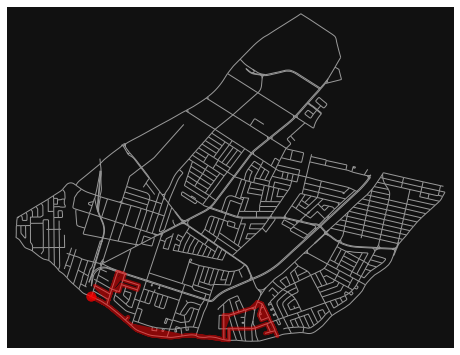

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 10663
time : 42.652 minutes
[32662002, 5015624885, 1700338632, 1700338630, 1700549619, 5015624905, 32662023, 5015624911, 1700105812, 1700105838, 32663011, 32663623, 1764259721, 32663621, 32663064, 1764259735, 1700549631, 1700228916, 32663225, 1764259733, 32663225, 1700228916, 1700228918, 1700228919, 1700228918, 248513118, 248513218, 1700228919, 248513118, 558662424, 32764514, 612762780, 612761406, 612002329, 4502579369, 612002318, 612762770, 4975112798, 32822287, 4975112798, 32822362, 32822173, 636142432, 612002309, 612002310, 612002313, 1700549640, 1700549634, 1700549640, 1700549644, 32822357, 1700549644, 1700549645, 1700549635, 1700549636, 1700549637, 1700549649, 1763614977, 1700549649, 1700549650, 1700549638, 1700549637, 1700549638, 1700549639, 1700549641, 1700549646, 1763567162, 32822233, 1700549652, 1700549653, 612002262, 612002236, 612002218, 3709797034, 612002209, 612002211, 1543768655, 3650916052, 612002184, 2

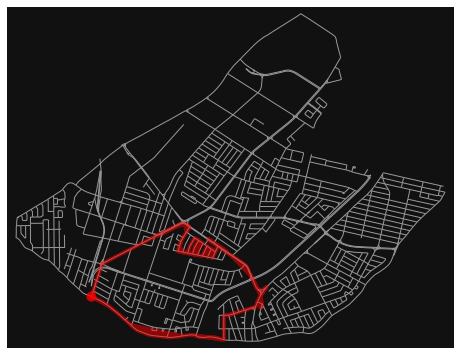

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 9467
time : 37.868 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002211, 612002209, 3709797034, 612002218, 612002236, 612002262, 1700549653, 1700549652, 32822233, 1763567162, 1700549646, 1700549641, 1700549639, 32822298, 1700549650, 32822298, 1700549652, 32822233, 1763567162, 32822233, 1700549652, 1700549653, 1700549654, 32822021, 1763567174, 1764326013, 1763567172, 1764326013, 1764326007, 1763567167, 1763567172, 1763567174, 32822021, 1700549654, 612002269, 612002276, 612002269, 612002245, 612002276, 612002338, 612002335, 1427593080, 612002343, 1427593080, 1427593062, 609404660, 1427593062, 612002335, 277670314, 286450122, 286450003, 286450004, 286450118, 286450004, 286450118, 286450003, 286450122, 286451084, 286450122, 277670314, 612002274, 248513125, 612002244, 370

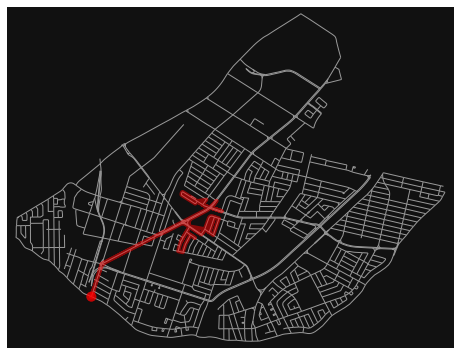

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 9829
time : 39.316 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002195, 612002206, 32733828, 3709797825, 612002244, 248513125, 612002274, 277670314, 286450122, 286451084, 48570679, 286450997, 286450875, 286450997, 286451082, 286451120, 286451188, 286451131, 286451188, 286451187, 286450825, 286451187, 286451186, 286451318, 286451189, 286451132, 286451186, 286451120, 286451085, 286451058, 286451082, 286451131, 48570679, 286451084, 48570677, 286450875, 286451058, 286451085, 286451132, 286451189, 286450980, 58852602, 286452855, 1764336827, 1764336825, 1764336827, 1764336830, 286453276, 286453046, 1764326120, 286450720, 286452974, 286453327, 286453279, 286453277, 286453278, 286453327, 286452974, 286451404, 286452855, 58852602, 48570677, 48570675, 277670314, 612002274, 24

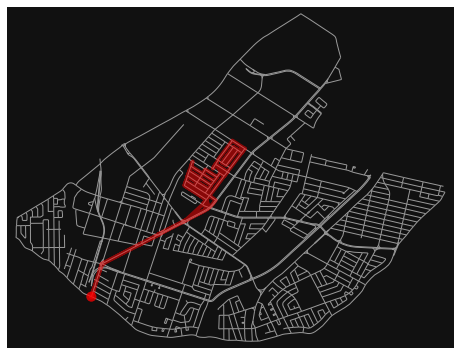

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 11758
time : 47.032 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002195, 612002206, 32733828, 3709797825, 612002244, 248513125, 612002274, 277670314, 48570675, 48570677, 58852602, 286452855, 286451404, 286453279, 286451404, 286452855, 277670312, 48570675, 48570677, 58852602, 286450980, 1764336825, 286451040, 1764336828, 286451040, 286451318, 286450825, 286451319, 286449131, 612002299, 32821661, 612002299, 612002293, 290776461, 286445351, 286444958, 1543768657, 1543768644, 32821661, 1543768644, 248513128, 286448567, 248512074, 248513128, 286449131, 286451319, 58852604, 1764336828, 1764336832, 286451884, 1764336832, 286452970, 58852604, 286452970, 286451412, 286453132, 286453198, 286453231, 32821673, 286453231, 286453198, 286453132, 286451412, 286452970, 58852604, 286

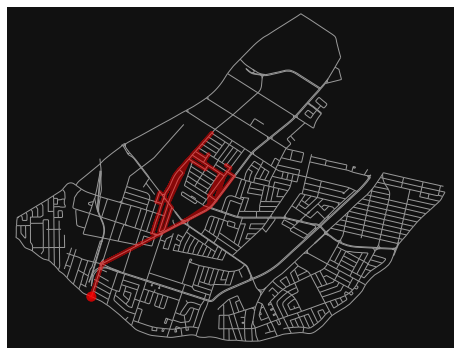

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 12176
time : 48.704 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 612002192, 1543768642, 9819927803, 248512073, 286444958, 1543768657, 32821661, 612002299, 286449131, 286451319, 58852604, 286452970, 286451412, 286453132, 286453198, 286453231, 286453203, 286453041, 286453203, 286453166, 286453198, 286453166, 286453130, 286452997, 286453130, 286453132, 286451412, 286451884, 286452997, 286453276, 1764336830, 286453277, 286453278, 286453046, 286453041, 32821673, 32821574, 4526384241, 248512003, 4526384241, 32821570, 248512003, 32821596, 611541486, 32821761, 611541591, 8761217456, 8761218030, 8761217444, 8761217456, 611541591, 248512024, 316170000, 301299322, 614996213, 615007135, 614991298, 615007135, 615007133, 615007147, 3794512357, 615007147, 6657105802, 301299322, 614996213, 615007

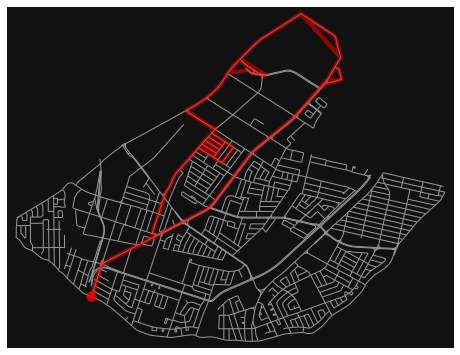

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 16314
time : 65.256 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002195, 612002206, 32733828, 3709797825, 612002244, 248513125, 612002274, 277670314, 48570675, 277670312, 32821576, 609404803, 32821598, 614983230, 32821762, 614983276, 277670298, 615001764, 614991298, 615007135, 614996213, 3794512357, 615007133, 614991297, 615001759, 615001764, 9846279439, 8761218034, 611541528, 8761218034, 612002414, 8761217444, 8761218030, 614991298, 615001764, 614991298, 614991297, 615001759, 9308893301, 614991270, 614983294, 1700539681, 1700539681, 614983294, 2140361849, 1762313115, 2140361849, 614983295, 1700539692, 1700539692, 614983295, 614983294, 614983295, 9308893301, 277670298, 614983276, 277670298, 615001764, 9846279439, 611541528, 32821674, 614983236, 614983230, 614983236,

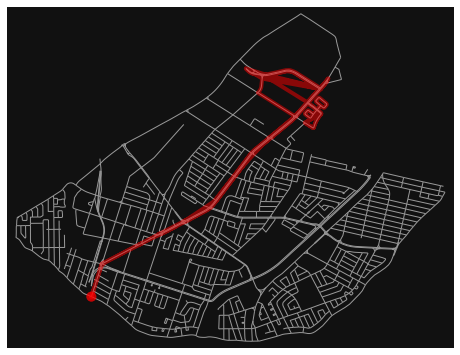

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 16790
time : 67.16 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002211, 612002209, 3709797034, 612002218, 612002236, 612002235, 612002245, 612002276, 612002338, 612002335, 1427593062, 609404660, 609404669, 609404676, 4487174671, 609404793, 609404806, 614983232, 614983249, 614983232, 614983229, 614983249, 1762313115, 614983228, 9337696622, 614983228, 2316599857, 3475311477, 1762313105, 3475311477, 4747867990, 9337696659, 4747867990, 9337696659, 2316599857, 609404795, 609404806, 609404795, 609404793, 609404806, 614983232, 32821762, 614983230, 32821598, 609404785, 609404803, 609404785, 1700549655, 1700549656, 1700549655, 32821597, 32821674, 32821761, 611541486, 611541485, 32821596, 611541485, 32821597, 32821574, 1764326120, 286450720, 32821576, 609404803, 32821598, 609

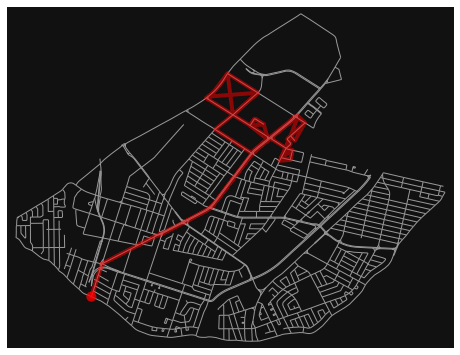

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 15269
time : 61.076 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002211, 612002209, 3709797034, 612002218, 612002236, 612002235, 612002245, 612002276, 612002338, 612002335, 1427593062, 609404660, 609404669, 609404676, 4487174669, 4487174671, 609404676, 4487174669, 1762313103, 1762313096, 1762313103, 1764326109, 32821964, 1764326109, 1764326107, 1764326097, 1764326053, 32821973, 1764326053, 1763629803, 286456269, 286456473, 286456422, 286456264, 286456422, 286456187, 1763629803, 286456187, 1764326044, 32821962, 32821964, 1764326097, 1764326107, 1764326103, 32821971, 1764326103, 32821973, 32821971, 1762313073, 1762313076, 1764326051, 1764326047, 1764326058, 1762313077, 1764326058, 1762313079, 1764326105, 2316599858, 1764326105, 1762313079, 1764326051, 1764326047, 1764

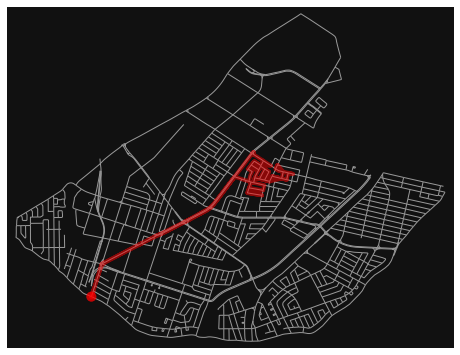

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 11919
time : 47.676 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002211, 612002209, 3709797034, 612002218, 612002236, 612002235, 612002245, 612002276, 612002338, 612002335, 1427593080, 612002343, 371756083, 371756076, 248513377, 371756066, 371751078, 2155510781, 286455812, 286456527, 32822009, 286456809, 32822008, 1763567191, 1763567192, 1763567191, 32822008, 1763567191, 1764326040, 286456624, 1764326040, 32821791, 1762313073, 1762313076, 1764326105, 1762313096, 1762313105, 2316599858, 286457189, 1762313077, 1763567192, 286457189, 1764326055, 286460224, 286460255, 286460218, 286460219, 286459819, 618066271, 286460694, 286459950, 286461820, 286462206, 286461820, 286462216, 286461802, 286462216, 286462235, 286461826, 1764309494, 286461791, 1764309494, 286460179, 28646

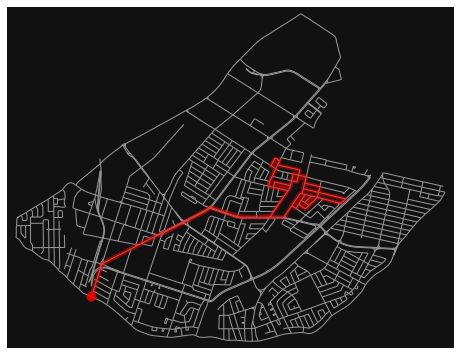

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13075
time : 52.3 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002211, 612002209, 3709797034, 612002218, 612002236, 612002235, 612002245, 612002276, 612002338, 612002335, 1427593080, 612002343, 371756083, 371756076, 248513377, 371756066, 371751078, 2155510779, 286459820, 371751950, 371751959, 618066216, 5414078806, 5414078808, 286461822, 286461791, 1382176510, 371751950, 1382176510, 286459820, 371751950, 371751959, 286460834, 618066212, 1382176517, 2704423269, 1382176517, 286459820, 2155510779, 2155510781, 2155510779, 371751078, 2155510781, 286455812, 286456527, 32822009, 286456809, 286456641, 286456809, 32822008, 286456641, 286456624, 286456600, 1763629802, 286456600, 32822009, 286456527, 286456474, 286456431, 1763629802, 32821791, 286456269, 286456473, 286456264, 

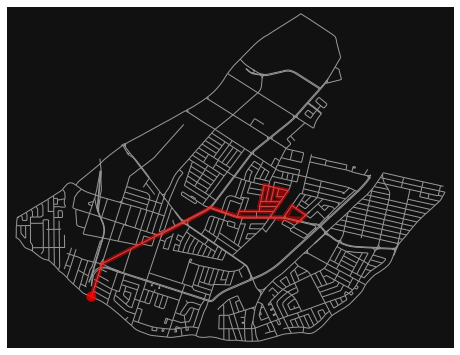

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 11332
time : 45.328 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002211, 612002209, 3709797034, 612002218, 612002236, 612002235, 612002245, 612002276, 612002338, 612002335, 1427593080, 612002343, 371756083, 371756076, 286455730, 286455903, 286455842, 371756066, 286455833, 4502307438, 2155510770, 2704423264, 2704423260, 1763567176, 2704423264, 2155510770, 32822010, 4502307438, 286455833, 248513376, 286455481, 371756076, 371756083, 1763567178, 286455730, 371756076, 248513377, 248513376, 248513377, 371756066, 371751078, 32822010, 2704423269, 1763567176, 2704423260, 2704423255, 2704423251, 2704423255, 2704423251, 1763567159, 248513342, 1763567159, 1763567157, 32822014, 1763567157, 32822174, 1764332424, 1764332421, 1764332424, 32822027, 32822138, 561662145, 32822138, 561

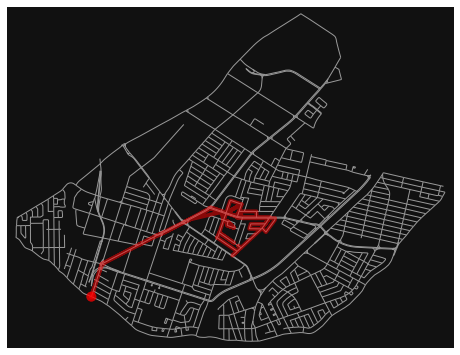

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 11484
time : 45.936 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002211, 612002209, 3709797034, 612002218, 612002236, 612002235, 612002245, 612002276, 612002338, 286455648, 286455329, 32822027, 32822138, 561662145, 32822162, 1764332421, 248513342, 248513369, 32822162, 248513369, 248513376, 286455481, 286455329, 371756083, 612002343, 286455648, 612002338, 277670314, 612002274, 612002255, 612002219, 612002244, 612002235, 612002262, 612002236, 612002262, 1700549653, 612002279, 612002309, 612002279, 32822021, 636142432, 32822173, 32822362, 612002313, 612762770, 612761396, 612002318, 4502579369, 32822014, 32763538, 32764514, 558662424, 32733801, 1700544992, 1764233536, 1763614940, 1763614944, 1763614940, 1763614949, 1763614946, 1763614962, 1763614961, 1763614959, 1763614

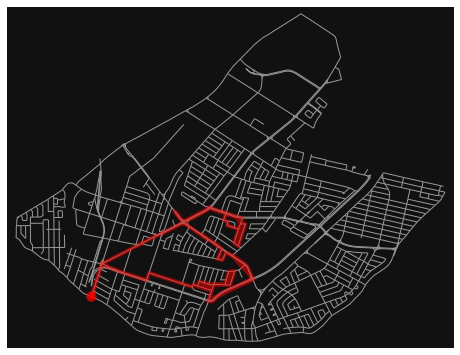

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 11692
time : 46.768 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 4488600990, 290735866, 290735827, 1763614960, 1763614954, 32733137, 1764233561, 1763614953, 1763614944, 1763614956, 1763614955, 1763614952, 1763614949, 1763614946, 1763614959, 1763614961, 1763614963, 1763614959, 1763614961, 1763614959, 1763614946, 1763614962, 612761410, 612761398, 612761410, 612002329, 32763538, 32822014, 32822287, 612002318, 612761396, 1700549634, 32822357, 1700549635, 1700549636, 1763614977, 612002162, 1700549645, 612002162, 612002309, 612002310, 32822173, 32822174, 1763567167, 1764326007, 32822027, 286455329, 286455648, 612002343, 609404667, 609404675, 32821951, 32821962, 1764326044, 286456011, 286456010, 286455966, 609404667, 286455966, 286455639, 1763567178, 286455730, 286455903, 286455730, 371756076, 371756083, 612002343, 1427593080, 612002335, 612002338, 612002276, 612002245, 61200

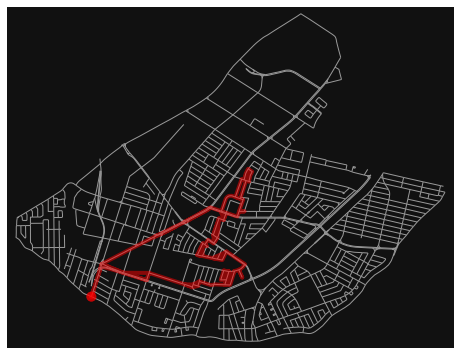

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 10580
time : 42.32 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002211, 612002209, 3709797034, 612002218, 612002236, 612002235, 612002245, 612002276, 612002338, 612002335, 1427593080, 612002343, 609404667, 286455966, 286456010, 286455483, 286455639, 286455483, 286456010, 286456011, 32821951, 609404675, 609404669, 609404676, 32821576, 277670312, 609404669, 609404660, 48570675, 277670314, 612002274, 248513125, 612002245, 612002235, 612002236, 612002218, 3709797034, 9819927678, 612002209, 612002211, 612002206, 612002195, 1543768642, 9819927803, 286445353, 286445950, 286446555, 5414463936, 286446555, 286446522, 286446414, 286446522, 248512072, 286445950, 286445952, 290772534, 290772440, 290772534, 286443580, 248512751, 286444312, 286444294, 4526362270, 248512070, 248512

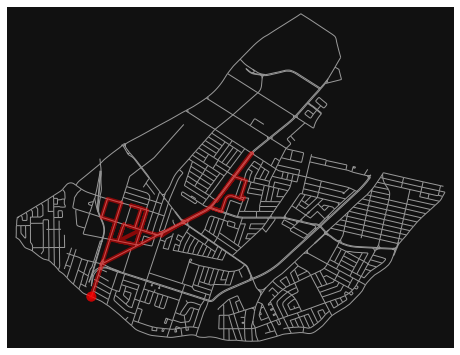

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 10786
time : 43.144 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 612002133, 9534570035, 286443580, 248512751, 248512070, 4526362273, 4526362270, 248512070, 248512751, 290772440, 286446509, 5414463936, 286446509, 286446414, 1543768656, 248512070, 1543768656, 248512070, 4526362273, 286445094, 286445099, 286444907, 286445351, 286445352, 286445353, 9819927803, 248512073, 286445352, 248512072, 286445099, 286445094, 248512103, 248512104, 286444907, 248512103, 248512104, 286270655, 248512109, 286271657, 290776461, 612002293, 32821661, 1543768657, 286444958, 248512073, 248512074, 286448567, 612002219, 612002255, 248513125, 612002244, 3709797825, 286449631, 3709797825, 32733828, 612002206, 612002195, 1543768655, 3650916052, 612002184, 286446104, 286446309, 286443556, 612002157, 277670318, 9534616009, 4059882019, 1209147560, 290748904, 290747828, 32761809, 32772261, 32772101, 32

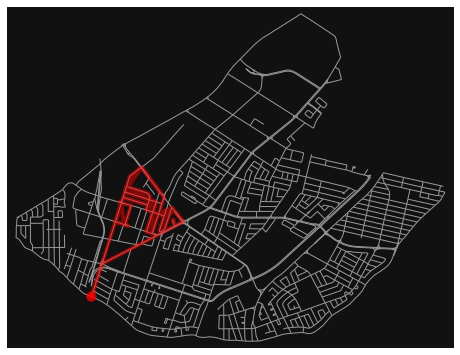

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 9801
time : 39.204 minutes
[32662002, 32772101, 32772261, 32761809, 290747828, 290748904, 1209147560, 4059882019, 9534616009, 277670318, 612002157, 286443556, 286446309, 286446104, 612002184, 3650916052, 1543768655, 612002195, 612002206, 32733828, 3709797825, 32733828, 3709797825, 612002218, 3709797034, 612002209, 32733828, 612002206, 32733828, 612002206, 612002211, 612002203, 9819927678, 612002203, 291682228, 291682336, 291682314, 291682218, 291682314, 291682336, 291682228, 612002203, 612002211, 1543768655, 612002195, 1543768642, 612002192, 1543768655, 3650916052, 612002192, 3650916052, 612002184, 286446104, 612002184, 286446309, 286446104, 286446309, 286443556, 286445952, 612002157, 286443556, 612002157, 277670318, 9534616009, 277670318, 290735866, 290735827, 1763614960, 290735827, 290735866, 4488600990, 4059882019, 1209147560, 290748904, 290747828, 32761809, 32772261, 32772101, 32662002]


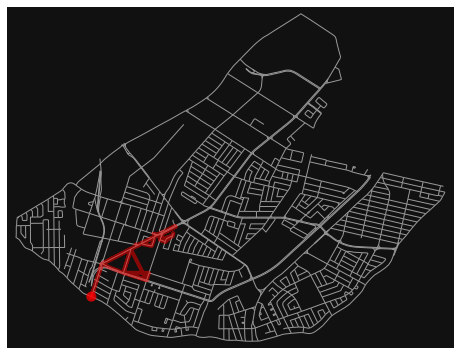

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 7322
time : 29.288 minutes
====================== Borough of Lachine, Montreal, Canada =======================
The graph is eulerian : True
[95871978, 4198102066, 4198101823, 9779742614, 606287557, 606287550, 4331915461, 4331913400, 4331915461, 4331915462, 4331913401, 4331913400, 4331912439, 4331914151, 4331914152, 4331912440, 4331914152, 606287588, 606287581, 606287568, 606287566, 606287568, 606287539, 8762209332, 245474329, 116383726, 245474329, 8762209332, 606287539, 245488217, 606287532, 606287515, 606287532, 606287534, 244964008, 244964035, 1659607974, 1659608096, 1659607974, 606287403, 606287456, 8762953770, 8762872440, 98356331, 8762953740, 1659607980, 606287450, 1659607980, 606287446, 606287352, 606287446, 8762953740, 606287350, 8762953740, 98356331, 8762872440, 98356322, 245488217, 606287539, 606287568, 606287581, 606287549, 606287548, 606287549, 606287581, 606287588, 4331914151, 4331912439, 4331912440, 43319

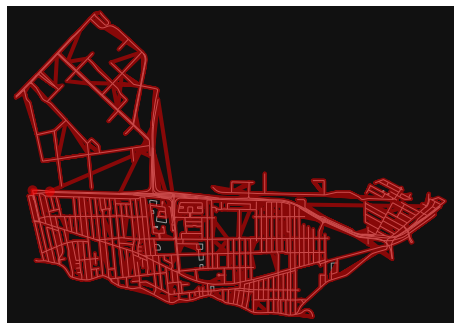

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
[95871978, 4198102066, 4198101823, 9779742614, 606287557, 606287550, 4331915461, 4331913400, 4331915461, 4331915462, 4331913401, 4331913400, 4331912439, 4331914151, 4331914152, 4331912440, 4331914152, 606287588, 606287581, 606287568, 606287566, 606287568, 606287539, 8762209332, 245474329, 116383726, 245474329, 8762209332, 606287539, 245488217, 606287532, 606287515, 606287532, 606287534, 244964008, 244964035, 1659607974, 1659608096, 1659607974, 606287403, 606287456, 8762953770, 8762872440, 98356331, 8762953740, 1659607980, 606287450, 8762953770, 244964006, 244964008, 606287534, 606287516, 606287526, 606287519, 606287543, 606287542, 606287544, 606287549, 606287551, 606287550, 606287557, 9779742614, 4198101823, 4198102066, 95871978]


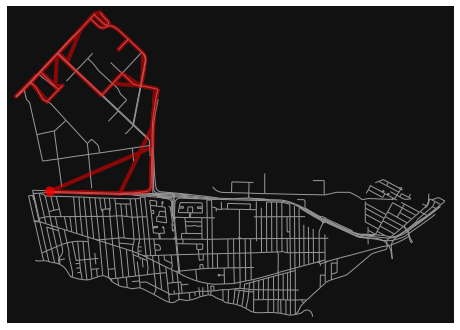

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 16051
time : 64.204 minutes
[95871978, 4198102066, 4198101823, 9779742614, 606287557, 606287550, 606287551, 606287549, 606287544, 606287542, 606287543, 606287519, 606287526, 606287516, 606287534, 244964008, 244964006, 8762953770, 606287450, 1659607980, 606287450, 1659607980, 606287446, 606287352, 606287446, 8762953740, 606287350, 8762953740, 98356331, 8762872440, 98356322, 245488217, 606287539, 606287568, 606287581, 606287549, 606287548, 606287549, 606287581, 606287588, 4331914151, 4331912439, 4331912440, 4331913401, 4331915462, 606287551, 4331914046, 9803824750, 9803824749, 4331914045, 4331914046, 9803824750, 606287426, 606287425, 9803824809, 606287425, 606287426, 606287420, 606287542, 606287543, 606287421, 606287543, 606287519, 606287526, 606287519, 606287543, 606287542, 606287544, 606287549, 606287551, 606287550, 606287557, 9779742614, 4198101823, 4198102066, 95871978]


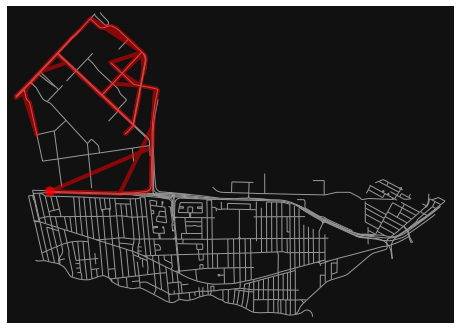

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 20715
time : 82.86 minutes
[95871978, 4198102066, 4198101823, 9779742614, 606287557, 606287550, 606287551, 606287549, 606287544, 606287542, 606287543, 606287519, 606287526, 1659608168, 606287526, 606287527, 606287520, 606287519, 606287520, 606287542, 606287544, 606287549, 606287551, 606287550, 4331914045, 9803824749, 606287427, 1659607567, 1659607536, 1659607567, 1659607562, 606287425, 1659607562, 1659607529, 606287411, 1659607529, 1659607536, 606287411, 606287412, 606287408, 606287412, 4330833778, 4330833776, 4330833778, 606287388, 606287390, 606287388, 606287385, 606287383, 606287365, 606287383, 606287394, 606287396, 606287394, 606287352, 606287333, 606287383, 606287385, 606287388, 4330833778, 606287412, 606287411, 1659607536, 1659607567, 606287427, 9803824749, 4331914045, 606287550, 606287557, 9779742614, 4198101823, 4198102066, 95871978]


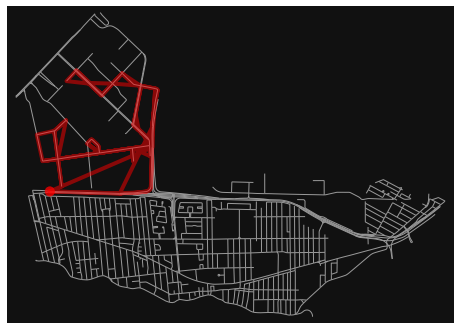

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 19475
time : 77.9 minutes
[95871978, 4198102066, 4198101823, 9779742614, 606287557, 606287550, 4331914045, 9803824749, 606287427, 1659607567, 1659607536, 606287411, 606287412, 4330833778, 606287388, 606287385, 606287366, 606287385, 606287390, 606287396, 606287403, 606287456, 606287450, 8762953770, 244964006, 244964035, 244964006, 244964008, 606287534, 606287516, 606287526, 606287516, 606287515, 606287527, 606287531, 606287536, 606287531, 606287544, 606287420, 606287426, 606287427, 606287425, 4330686513, 4330686512, 4330686513, 606287421, 606287420, 606287544, 606287549, 606287551, 606287550, 606287557, 9779742614, 4198101823, 8746884197, 8746834287, 8746834268, 8746834287, 4513516145, 4513516148, 274293746, 4513516148, 4513516145, 4198101820, 4198102077, 4198101995, 116408681, 4198102066, 95871978]


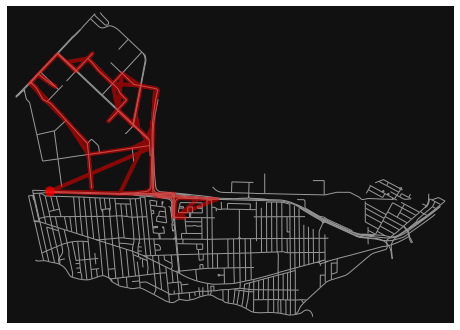

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 19891
time : 79.564 minutes
[95871978, 4198102066, 116408681, 4198101995, 4198102077, 4198101820, 4513516145, 4513516148, 4513516146, 4513516137, 4513516146, 4513516145, 4198101820, 8746834282, 8746884225, 9781714939, 8485269584, 8755699390, 8756271584, 5427619728, 243077466, 4221549637, 612002089, 8756271603, 2089525553, 8756253373, 8756253369, 8755699383, 8756253348, 612002089, 8756271603, 2565600070, 2565600071, 2565600070, 609404690, 612683940, 612002367, 6836090469, 612002367, 248513139, 612002375, 272903038, 272903335, 3740564938, 272903335, 272903314, 272903315, 272903314, 272903313, 3740564938, 243077460, 243077459, 243077460, 3740564938, 272903335, 272903038, 612002375, 243077462, 243077463, 8756253308, 272901269, 272900827, 8756253321, 2089527314, 8755699390, 8485269584, 9781714939, 8746884225, 116408681, 4198102066, 95871978]


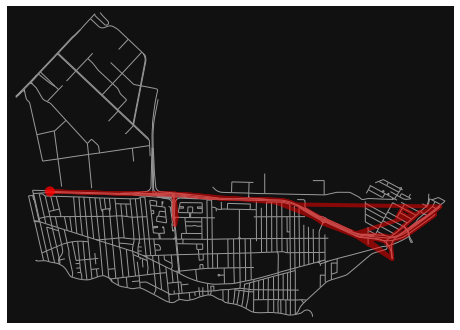

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 20678
time : 82.712 minutes
[95871978, 4198102066, 116408681, 8746884225, 9781714939, 8485269584, 8755699390, 2089527314, 8756253321, 272900827, 272901269, 8756253308, 243077463, 243077462, 612002375, 272903038, 272903335, 3740564938, 243077460, 272903274, 272903275, 272903274, 272903313, 272901596, 272903134, 272904045, 272904101, 272903945, 272904101, 272904028, 272903984, 272904028, 272904005, 272843676, 272904045, 272903134, 272903315, 272903038, 612002375, 286270645, 612683940, 286270647, 286270680, 286269940, 248513137, 612002367, 248513137, 286270647, 248512280, 609404690, 8756253308, 272901269, 272903625, 272904483, 272904502, 2565561069, 272904502, 2565561070, 272904502, 272904483, 272900827, 272901269, 272903625, 272904483, 272900827, 8756253321, 2089527314, 8755699390, 8485269584, 9781714939, 8746884225, 116408681, 4198102066, 95871978]


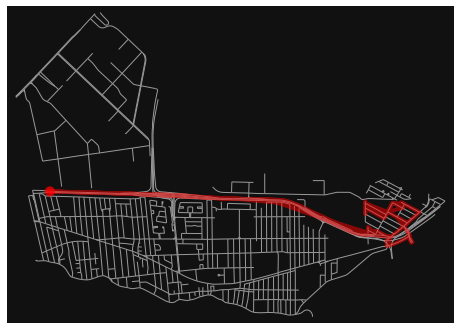

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 15478
time : 61.912 minutes
[95871978, 4198102066, 116408681, 8746884225, 9781714939, 8485269584, 8755699390, 2089527314, 8756253321, 272900827, 272904483, 272903625, 272903882, 272903566, 272903882, 272903984, 272903952, 272902103, 272903952, 272903566, 243077463, 243077462, 612002375, 272843676, 272904005, 272902103, 243077462, 243077463, 8756253308, 286270645, 248513139, 243077472, 8151510415, 8151511518, 243077485, 8151511518, 243077470, 243077469, 243077485, 243077481, 612002394, 276459268, 243077474, 243077481, 243077474, 243077469, 243077474, 276459268, 9848120636, 224618515, 243077475, 9848120702, 243077475, 276465588, 243077475, 224618515, 243077459, 243077460, 3740564938, 272903335, 272903038, 612002375, 243077462, 243077463, 8756253308, 272901269, 272900827, 8756253321, 2089527314, 8755699390, 8485269584, 9781714939, 8746884225, 116408681, 4198102066, 95871978]


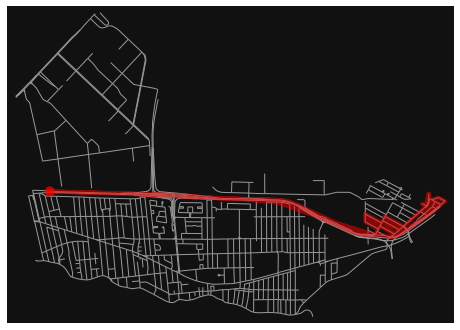

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 16280
time : 65.12 minutes
[95871978, 4198102066, 116408681, 8746884225, 9781714939, 8485269584, 8755699390, 2089527314, 8756253321, 272900827, 272901269, 8756253308, 286270645, 248513139, 243077472, 243077470, 243077472, 8151510415, 243077466, 5427619728, 8756271584, 8756271598, 8756253321, 272900827, 8756253321, 2089527314, 8755699390, 8485269584, 272908020, 9781714939, 272908020, 272907081, 272907272, 272907278, 272907272, 272907299, 272907338, 272907299, 272907081, 272906300, 272907853, 272906300, 258833140, 2565561066, 3740557299, 2565561066, 3740557299, 258831116, 3740557299, 258829686, 258829687, 258829686, 258831468, 258831550, 273135514, 273135593, 273135514, 258831529, 258831528, 258831550, 258831468, 258829686, 3740557299, 2565561066, 258833140, 272906300, 272907081, 272908020, 9781714939, 8746884225, 116408681, 4198102066, 95871978]


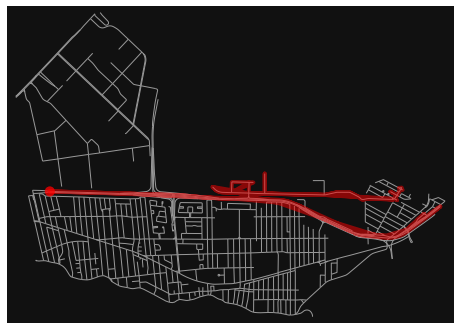

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 22325
time : 89.3 minutes
[95871978, 4198102066, 116408681, 8746884225, 9781714939, 272908020, 272907081, 272906300, 258833140, 2565561066, 3740557299, 258829686, 258831468, 258831550, 258831528, 258831597, 258831578, 258831597, 6126799026, 258831526, 6126799026, 258831578, 258831468, 258829686, 258829685, 258830400, 258830761, 258830400, 258829681, 258829685, 258829686, 3740557299, 2565561062, 258831117, 258831121, 1778736476, 1778736468, 1778736472, 1778736468, 3946174759, 4039251626, 3946174759, 258831223, 258831122, 258831223, 258831122, 1778736476, 258831121, 258831117, 2565561062, 2565561066, 258833140, 272906673, 258833140, 272906300, 272907081, 272908020, 9781714939, 8746884225, 116408681, 4198102066, 95871978]


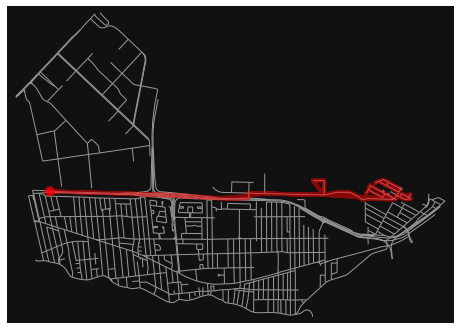

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 14475
time : 57.9 minutes
[95871978, 4198102066, 116408681, 8746884225, 8746834282, 4198101882, 116346914, 4198101882, 4198101995, 4198101999, 116386236, 4198101999, 7700699953, 116392129, 7700699953, 8746884197, 4198101823, 4198102066, 116408681, 4198102066, 116408681, 4198101995, 4198102077, 4198101820, 4198102077, 116392129, 4513516138, 8755439413, 4513516139, 276630419, 276630453, 278030039, 276630453, 276630559, 279118400, 279118440, 276632288, 276632470, 276631502, 276631511, 276632006, 276632228, 276632021, 276632011, 276632021, 276632011, 276632228, 276632006, 276631511, 276631502, 276632470, 276632288, 279118440, 279118400, 276630559, 276630453, 278030039, 275330503, 275330828, 275331139, 275330504, 275330506, 275330509, 275330510, 276634538, 276634542, 9802859377, 6157562108, 276634614, 274301727, 8255988343, 276634968, 276635145, 276611326, 276648763, 276648143, 276611327, 276611328, 276628885, 4506528521, 

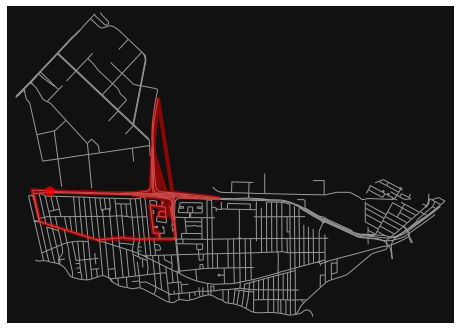

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 18017
time : 72.068 minutes
[95871978, 276643316, 244863860, 276640488, 244863864, 4506528521, 276628885, 276611328, 276611327, 276648143, 276648763, 276611326, 276635145, 276634968, 8255988343, 274301727, 276634614, 6157562108, 9802859377, 276634542, 276634538, 275330510, 275330509, 275330506, 275330504, 275331139, 275330828, 275330503, 278030039, 276630453, 276630559, 279118400, 279118440, 276632288, 276632470, 276631502, 276631511, 276632006, 276633026, 276633026, 276632006, 276631511, 276631502, 276632470, 276632288, 279118440, 279118400, 276630559, 276630440, 276630933, 276630933, 276630440, 276630419, 4513516139, 4198102081, 8755439413, 4513516138, 277976170, 277976243, 277976243, 277976170, 3880588378, 277976170, 4513516138, 4513516137, 4198101813, 4198102085, 274302378, 4198102085, 4198102084, 273555901, 274295909, 611962866, 1350936730, 274301744, 6262327970, 611962866, 274292033, 274284076, 274295737, 274298

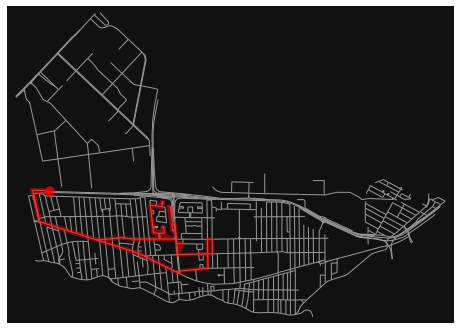

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 11619
time : 46.476 minutes
[95871978, 276643316, 244863860, 276640488, 244863864, 4506528521, 276628885, 276611328, 276611327, 276648143, 276648763, 276611326, 276635145, 276634968, 8255988343, 274301727, 276634614, 6157562108, 274301546, 276634517, 276634452, 276634440, 276646139, 274301545, 274301544, 274301543, 5355696615, 274301357, 274355993, 274355369, 274354074, 275334976, 274354357, 274284077, 274354004, 4198102082, 116415774, 116418282, 274298469, 274295737, 274284076, 274292033, 611962866, 274295909, 273555901, 274294262, 274294616, 274294262, 274294616, 274302378, 274302376, 274293545, 1350936730, 274290996, 274293420, 274293764, 274293852, 274293867, 274293837, 274293764, 274293420, 274290186, 274292566, 274292567, 275335984, 275335775, 275335460, 275335438, 274292681, 275335438, 275335460, 275335775, 275335984, 274292567, 274292681, 274292828, 274292566, 274292828, 274292814, 274290186, 274292814, 274293

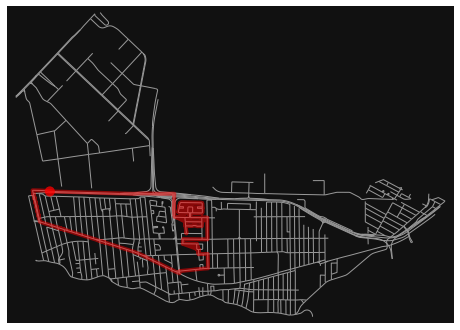

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 11570
time : 46.28 minutes
[95871978, 4198102066, 116408681, 4198101995, 4198102077, 4198101820, 4513516145, 4513516146, 4513516137, 4198101813, 274293703, 274293760, 274293569, 274293852, 274293569, 274293545, 274302376, 274293703, 4198101813, 4198102081, 116415771, 275335046, 275335080, 277978349, 274355623, 277978349, 275335046, 275335080, 275334976, 274354074, 275334976, 274354357, 274354241, 274354242, 275320590, 1768238726, 275320590, 274354248, 275322271, 5116306561, 248512559, 3742085829, 274353399, 3742085829, 274354013, 274355324, 274353400, 275323576, 248512553, 275323576, 606287038, 606287037, 606287038, 634772109, 275329040, 275329517, 274301545, 276646139, 276634440, 276634452, 276634517, 274301546, 6157562108, 276634614, 274301727, 8255988343, 276634968, 276635145, 276611326, 276648763, 276648143, 276611327, 276611328, 276628885, 4506528521, 244863864, 276640488, 244863860, 276643316, 95871978]


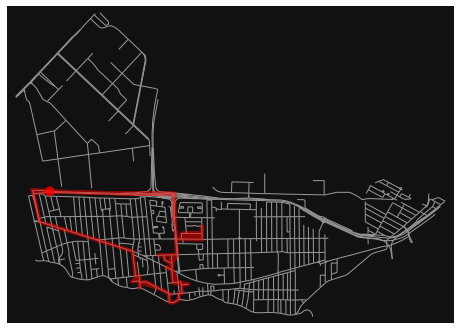

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 10024
time : 40.096 minutes
[95871978, 276643316, 244863860, 276640488, 244863864, 4506528521, 276628885, 276611328, 276611327, 276648143, 276648763, 276611326, 276635145, 276634968, 8255988343, 274301727, 276634614, 6157562108, 274301546, 276634517, 276634452, 276634440, 276646139, 274301545, 275329517, 275333216, 275327785, 275327908, 275327785, 275327955, 275328928, 275327955, 275327462, 275324705, 275324829, 275324828, 274355369, 274355993, 275334573, 274295304, 275334573, 275334946, 9802676183, 3663918246, 275330828, 275331139, 4330778011, 4330778014, 4330778011, 606287370, 606287367, 606287370, 606287369, 606287368, 606287369, 274301544, 275333216, 275329517, 274301545, 276634438, 276634435, 276634438, 275330504, 275331139, 276628498, 276627740, 276627418, 276636377, 276637466, 276637465, 276637464, 276628501, 276634539, 276634543, 276634676, 276634878, 276634930, 276635287, 276635185, 276628502, 276629001, 2766

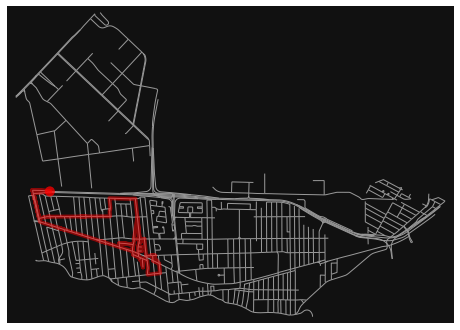

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 8586
time : 34.344 minutes
[95871978, 276643316, 244863860, 276640488, 244863864, 276628884, 276628706, 276647130, 276629001, 276628502, 276635185, 276635287, 276634930, 276634878, 276634676, 276634543, 276634539, 276637173, 4508145563, 5349124946, 276637545, 276637592, 276637545, 276637809, 276637465, 276637464, 276637465, 276637466, 276636377, 276636390, 276636438, 276636588, 276636380, 276636588, 276636448, 276628500, 276636438, 276636390, 276633942, 276628501, 276637464, 276637809, 276637545, 5349124946, 4508145563, 5349124946, 5349124942, 276637180, 276637592, 276637180, 276638624, 276638646, 276638649, 276638646, 276634676, 276634614, 6157562108, 9802859377, 276634542, 276634543, 276638624, 276637180, 5349124942, 4508145554, 276637173, 4508145554, 276637173, 276634539, 276634543, 276634676, 276634878, 276634930, 276635287, 276635185, 276628502, 276629001, 276647130, 276628706, 276628884, 244863864, 276640488, 24

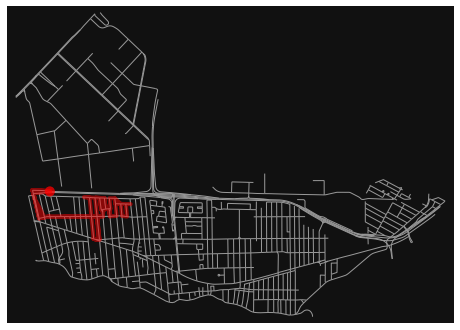

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 8187
time : 32.748 minutes
[95871978, 276643316, 244863860, 276640488, 244863864, 276628884, 276628706, 276647130, 276629001, 276628502, 276635185, 276635287, 276634930, 276634878, 276634676, 276634543, 276634539, 276637173, 4508145563, 276637173, 276634539, 276634543, 276634676, 276634878, 276638649, 276638656, 276638664, 276635287, 276635185, 276635145, 276635185, 276628502, 276629001, 276629000, 276629027, 276629028, 276629027, 276629050, 276627419, 276629050, 276628960, 276629000, 276628960, 276638664, 276638656, 276634930, 8255988343, 276634968, 8255988343, 274301727, 276634878, 276634930, 276635287, 276634968, 276635145, 276611326, 276648763, 276648912, 276648428, 276649335, 276646690, 276646725, 276646721, 276646625, 4506528521, 244863864, 276640488, 244863860, 276643316, 95871978]


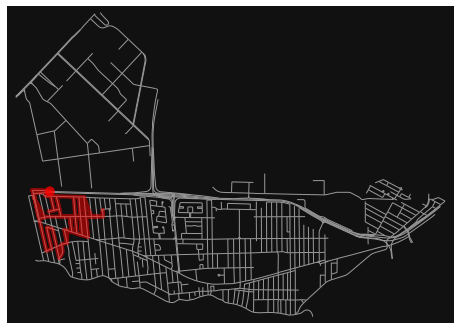

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 9652
time : 38.608 minutes
[95871978, 276643316, 244863860, 276640488, 244863864, 4506528521, 276628885, 276611328, 276646725, 276646690, 276648428, 276648518, 276648143, 276648763, 276611326, 276628502, 276629001, 276647130, 276628706, 276629028, 276627419, 276628833, 276628884, 276628885, 4506528521, 8750179507, 276639721, 8750179515, 8750179516, 3662369635, 4506528521, 276628885, 276611328, 276646725, 276648518, 276648143, 276611327, 276647130, 276611327, 276611328, 276628706, 276628884, 244863864, 4506528521, 276646625, 276649074, 2281495881, 276649074, 2281495883, 5415911289, 245550429, 5415911289, 2281495883, 276646559, 276646625, 4506528521, 244863864, 276640488, 244863860, 276643316, 95871978]


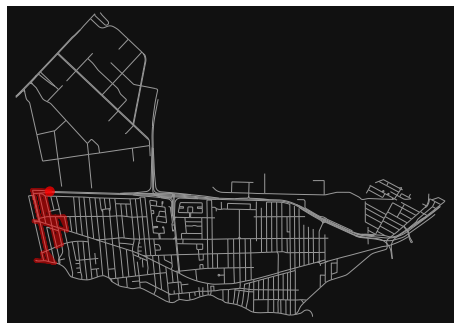

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 7102
time : 28.408 minutes
[95871978, 276643316, 244863860, 276640091, 9801332660, 611962852, 3662369635, 8750179507, 276639721, 8750179507, 3662369635, 611962852, 9801332660, 611962852, 244863864, 276640488, 276640091, 276640488, 244863860, 276640091, 9801332660, 276640087, 8750179516, 276639721, 276646559, 276646625, 276646721, 2281495881, 276644050, 276649335, 276651307, 276651409, 276651307, 276644050, 276644040, 276644038, 276644040, 276648912, 276650289, 276650311, 276650289, 276650036, 276650311, 276650343, 276650350, 276650343, 276650344, 276650036, 276651654, 276651694, 276651654, 276651700, 276651741, 276651700, 276651654, 276650036, 276650289, 276648912, 276648763, 276648143, 276611327, 276611328, 276628885, 4506528521, 244863864, 276640488, 244863860, 276643316, 95871978]


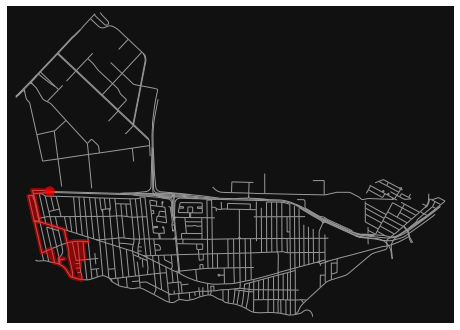

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 8766
time : 35.064 minutes
[95871978, 276643316, 244863860, 276640488, 244863864, 4506528521, 276628885, 276611328, 276611327, 276648143, 276648763, 276648912, 276650289, 276650036, 276651654, 276651700, 276650935, 276651833, 276650935, 276644038, 276644037, 276644035, 3610008146, 276649862, 3610008146, 276652069, 276652070, 276652069, 276644033, 276644031, 276644033, 276644035, 276644037, 276650344, 276649862, 277957952, 277957953, 277957952, 277957951, 277957952, 277957874, 277957952, 276649862, 276650350, 274301727, 276634614, 6157562108, 274301546, 9802859377, 274301546, 276634542, 276634538, 276634517, 276634452, 277961582, 277961437, 277961582, 276646017, 4690177188, 4690178089, 276644028, 277961437, 276634517, 274301546, 6157562108, 276634614, 274301727, 8255988343, 276634968, 276635145, 276611326, 276648763, 276648143, 276611327, 276611328, 276628885, 4506528521, 244863864, 276640488, 244863860, 276643316, 958

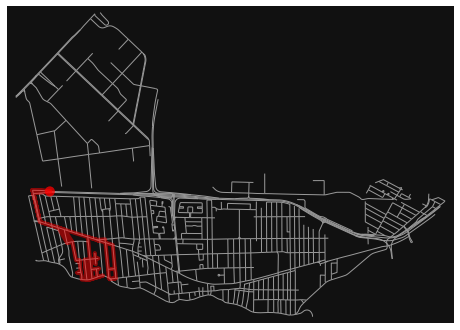

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 8450
time : 33.8 minutes
[95871978, 276643316, 244863860, 276640488, 244863864, 4506528521, 276628885, 276611328, 276611327, 276648143, 276648763, 276611326, 276635145, 276634968, 8255988343, 274301727, 276634614, 6157562108, 274301546, 276634517, 277961437, 276644028, 4690178089, 276644027, 4690178089, 276644028, 276644031, 274301546, 276634517, 277961437, 276644028, 4690177188, 276644027, 277965623, 277965535, 276646017, 277965535, 276646098, 277964985, 276646153, 276646139, 276634440, 276634452, 275330510, 276634538, 276634539, 276628501, 275330510, 275330509, 276633942, 276628500, 275330506, 276628500, 276636448, 276628499, 276636380, 276627418, 276627740, 276627501, 276628419, 276627501, 275330829, 276628419, 275330503, 275334946, 9802676183, 9802676182, 5355696615, 274301543, 274301544, 274301545, 276646139, 276634440, 276634452, 276634517, 274301546, 6157562108, 276634614, 274301727, 8255988343, 276634968, 2766

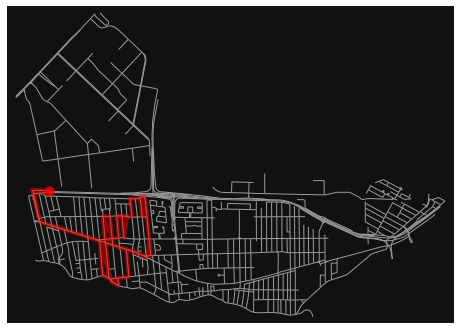

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 12018
time : 48.072 minutes
[95871978, 276643316, 244863860, 276640488, 244863864, 4506528521, 276628885, 276611328, 276611327, 276648143, 276648763, 276611326, 276635145, 276634968, 8255988343, 274301727, 276634614, 6157562108, 274301546, 276634517, 276634452, 276634440, 276646139, 274301545, 274301544, 274301543, 3663918246, 9802676182, 274301357, 5355696615, 274301543, 274301544, 274301545, 276646139, 276646153, 275329040, 634772109, 275323405, 634772109, 275324705, 275327462, 274301357, 274355993, 275324829, 274353400, 248512556, 274353400, 274355324, 275324828, 275324566, 274354073, 275324566, 274354074, 274355369, 274355623, 274295304, 275334936, 275334944, 275334936, 275334944, 278030039, 275330503, 275330828, 275330829, 276628498, 276628499, 275330504, 275330506, 275330509, 276634435, 275330509, 275330510, 276634538, 276634542, 9802859377, 6157562108, 276634614, 274301727, 8255988343, 276634968, 276635145, 276

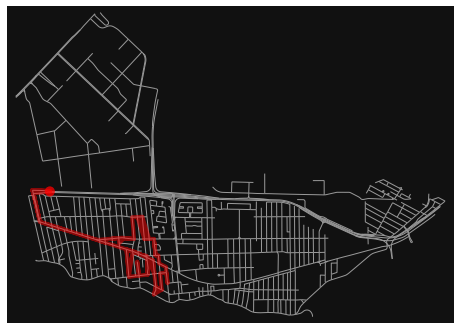

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 9942
time : 39.768 minutes
[95871978, 276643316, 244863860, 276640488, 244863864, 4506528521, 276628885, 276611328, 276611327, 276648143, 276648763, 276611326, 276635145, 276634968, 8255988343, 274301727, 276634614, 6157562108, 274301546, 276634517, 276634452, 276634440, 276646098, 277964985, 248512549, 277965623, 248512549, 248512553, 248512556, 248512559, 5116306561, 5116306575, 274337303, 274354248, 274337303, 274337302, 276614089, 274337302, 611962834, 611962837, 611962834, 274352757, 274352758, 274352757, 274337300, 5116306589, 248512571, 274352757, 611962834, 248512570, 5116306575, 248512570, 248512571, 5116306589, 5116306522, 275319027, 611962847, 274342563, 274337296, 248512582, 274337296, 1770135241, 4903766586, 1770135241, 5123388567, 1770135116, 5123388567, 1770135241, 274337296, 274342563, 611962847, 275319027, 274337300, 248512681, 248512679, 116415774, 4198102082, 274354004, 274284077, 274354357, 2753349

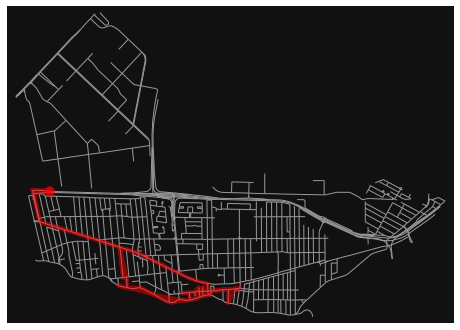

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 11028
time : 44.112 minutes
[95871978, 276643316, 244863860, 276640488, 244863864, 4506528521, 276628885, 276611328, 276611327, 276648143, 276648763, 276611326, 276635145, 276634968, 8255988343, 274301727, 276634614, 6157562108, 274301546, 276634517, 276634452, 276634440, 276646139, 274301545, 274301544, 274301543, 5355696615, 274301357, 274355993, 274355369, 274354074, 275334976, 274354357, 274284077, 274354004, 4198102082, 116415774, 248512679, 248512681, 274337300, 5116306589, 5116306522, 248512579, 248512582, 248512583, 248512584, 1770135116, 1770135176, 1770135107, 618151150, 274343339, 5116306738, 5015745844, 1769154353, 1769154356, 248512595, 1769154356, 1769154321, 618151760, 618151124, 5139737145, 5139737148, 5549119380, 274338718, 274339207, 1770135107, 4903766586, 248512686, 274284085, 274297019, 274284084, 274296379, 274284084, 1960942872, 274284084, 248512688, 248512687, 274297019, 274297101, 274297103, 2

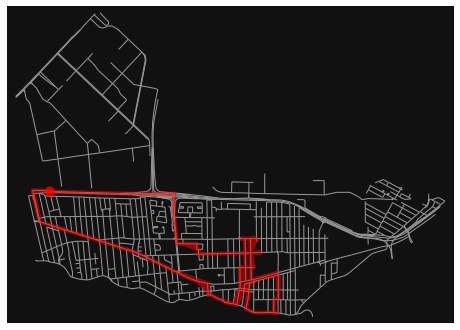

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13699
time : 54.796 minutes
[95871978, 4198102066, 116408681, 4198101995, 4198102077, 4198101820, 4513516145, 4513516146, 4513516137, 4198101813, 4198102085, 274302378, 274294616, 274294262, 273555901, 274295909, 611962866, 6262327970, 274296392, 274296580, 274296593, 274296761, 274297101, 274296761, 274296593, 274296583, 274296567, 274296580, 274296593, 274296594, 274296581, 274296594, 274288125, 274287375, 274296761, 274284085, 274296583, 248512685, 248512683, 248512685, 248512686, 248512687, 248512688, 5549119380, 274338718, 274339207, 618151150, 618151148, 618151145, 618151137, 618151127, 618151134, 618151124, 618151125, 618151129, 274337789, 274344197, 274338008, 274344263, 274338008, 618151125, 274337851, 274337669, 618151129, 618151128, 5116306556, 275322672, 5116306556, 618151128, 618151129, 618151125, 618151124, 618151134, 618151127, 618151137, 618151145, 618151148, 618151150, 1770135107, 4903766586, 24851268

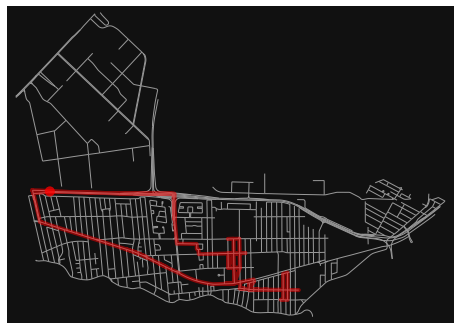

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13492
time : 53.968 minutes
[95871978, 276643316, 244863860, 276640488, 244863864, 4506528521, 276628885, 276611328, 276611327, 276648143, 276648763, 276611326, 276635145, 276634968, 8255988343, 274301727, 276634614, 6157562108, 274301546, 276634517, 276634452, 276634440, 276646139, 274301545, 274301544, 274301543, 5355696615, 274301357, 274355993, 274355369, 274354074, 275334976, 274354357, 274284077, 274354004, 4198102082, 116415774, 248512679, 248512681, 248512683, 248512685, 248512686, 4903766586, 1770135107, 618151150, 618151148, 618151145, 618151137, 618151127, 618151134, 618151124, 618151125, 618151129, 618151128, 5116306556, 274280260, 5116306556, 5116306789, 5116306765, 5580840652, 5116306765, 5116306796, 5116306782, 4333622280, 4333624013, 273424047, 274280158, 9807580487, 274280158, 6157659083, 5359473349, 6157659083, 9807570739, 5359473342, 9807570739, 5116303916, 5359473349, 4508204608, 248512696, 4508204

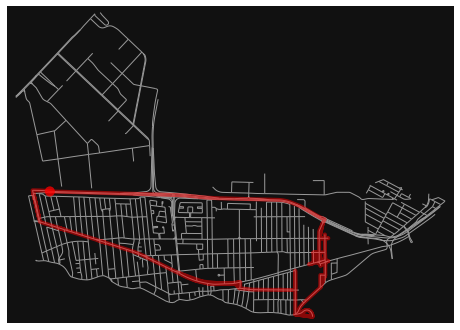

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 14898
time : 59.592 minutes
[95871978, 4198102066, 116408681, 8746884225, 9781714939, 8485269584, 8755699390, 2089527314, 609403687, 8756253373, 273425225, 273555100, 273555905, 1223827950, 4690266555, 4690266558, 7411151264, 6373245424, 6373245425, 5134195845, 6373245425, 6373245424, 7411151264, 248512280, 5134195845, 248512356, 4333624013, 248512356, 4333622280, 5116306782, 276619779, 5116306796, 276619779, 5116306789, 274337649, 274337789, 274344197, 5116306744, 248512596, 274344263, 618151760, 248512595, 248512596, 5116306744, 248512600, 5116306765, 248512600, 274337649, 618151128, 274336342, 274337669, 274337851, 5139737145, 274338080, 618151134, 1769154321, 1769154291, 1769154353, 5015745844, 274337653, 274343104, 274343339, 1770135176, 1770135116, 5123388567, 1770135241, 274337296, 274342563, 611962847, 275319027, 274337300, 248512681, 248512679, 116415774, 4198102082, 274354004, 274284077, 274354357, 275334976

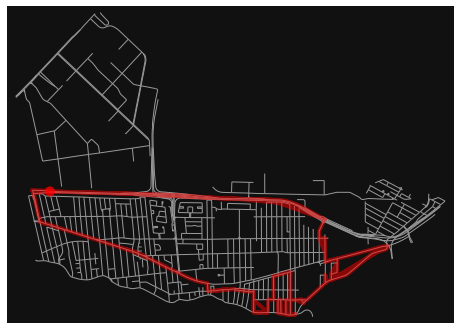

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 16480
time : 65.92 minutes
[95871978, 276643316, 244863860, 276640488, 244863864, 4506528521, 276628885, 276611328, 276611327, 276648143, 276648763, 276611326, 276635145, 276634968, 8255988343, 274301727, 276634614, 6157562108, 274301546, 276634517, 276634452, 276634440, 276646139, 274301545, 274301544, 274301543, 5355696615, 274301357, 274355993, 274355369, 274354074, 275334976, 274354357, 274284077, 274354004, 4198102082, 116415774, 248512679, 248512681, 274337300, 275319027, 611962847, 274342563, 274337296, 1770135241, 5123388567, 1770135116, 1770135176, 274343339, 274343104, 274337653, 274338682, 274337652, 274338682, 618151145, 274338584, 274338370, 618151137, 274337652, 1769154291, 618151127, 274338237, 274338080, 274338237, 274338370, 274338584, 274338718, 618151148, 274343104, 274337653, 274343104, 274343339, 1770135176, 248512586, 5116306738, 248512586, 248512584, 248512583, 5123388567, 248512583, 248512582, 

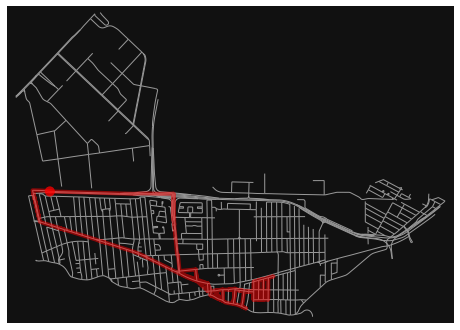

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 12520
time : 50.08 minutes
[95871978, 276643316, 244863860, 276640488, 244863864, 4506528521, 276628885, 276611328, 276611327, 276648143, 276648763, 276611326, 276635145, 276634968, 8255988343, 274301727, 276634614, 6157562108, 274301546, 276634517, 276634452, 276634440, 276646139, 274301545, 274301544, 274301543, 5355696615, 274301357, 274355993, 274355369, 274354074, 275334976, 274354357, 274284077, 1768238725, 274284077, 1768238725, 4198102082, 274354004, 274354242, 275322271, 4331961771, 4330681693, 4331961771, 274353399, 274354013, 274354073, 274354241, 274354357, 274284077, 274354004, 4198102082, 116415774, 248512679, 248512681, 248512683, 2589944278, 2589944279, 2589944279, 2589944278, 274297687, 274296567, 274297687, 274296565, 274296392, 274296565, 274284049, 274292033, 274284049, 6262327970, 274296392, 274296580, 274296581, 274301744, 274289981, 1350936634, 274289981, 274290996, 274284369, 274289981, 2742909

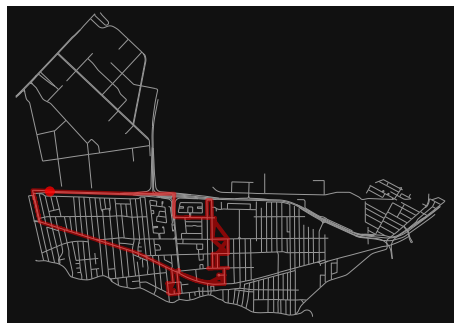

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 11262
time : 45.048 minutes
[95871978, 4198102066, 116408681, 4198101995, 4198102077, 4198101820, 4513516145, 4513516148, 274293746, 274292814, 274290186, 274293420, 274290996, 274289981, 274284369, 274284366, 274285340, 274284366, 274284362, 274285502, 274284362, 611965477, 611965483, 611965477, 274287395, 274287356, 274287357, 274287375, 274287356, 274288125, 274287356, 274287395, 611965483, 274284350, 612002059, 274284350, 273557817, 273558129, 273558130, 273558246, 273558016, 273558129, 273557596, 273558129, 273557817, 274283456, 273557817, 273557818, 273558016, 273557597, 273557539, 273558246, 618150992, 273558288, 5111996569, 5111996572, 273555904, 5111996572, 273558303, 273558288, 618150992, 273558246, 273558016, 273557818, 274282517, 274297103, 274287357, 274287375, 274288125, 274296594, 274296581, 274301744, 1350936730, 274293545, 274293569, 274293760, 274293867, 274293837, 274293746, 4513516148, 4513516145, 

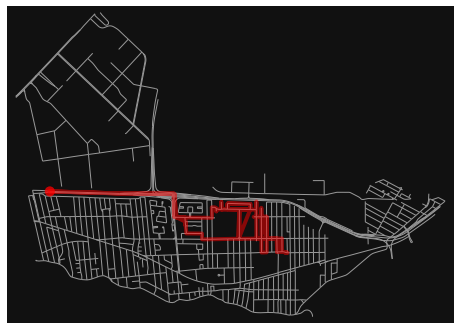

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13631
time : 54.524 minutes
[95871978, 4198102066, 116408681, 4198101995, 4198102077, 4198101820, 4513516145, 4513516148, 274293746, 274293837, 274293867, 274293760, 274293569, 274293545, 1350936730, 274301744, 274296581, 274296594, 274288125, 274287375, 274287357, 274297103, 274282517, 273557818, 273558016, 273558246, 618150992, 273558288, 273558303, 273558288, 273558132, 5116306546, 273557494, 273558130, 273558131, 273558132, 273558134, 273558303, 273558329, 273558368, 273558406, 273558136, 273558135, 273558136, 273556831, 273558136, 273557924, 612002083, 273557924, 273556792, 273557924, 273556793, 273558406, 618151075, 618151077, 618151078, 273556190, 5116306535, 5116306536, 5116306535, 273556188, 5116306535, 273556566, 273556793, 618151077, 248512694, 248512695, 618151078, 273556566, 273556221, 273556566, 273556793, 273558406, 273558368, 273558329, 273558303, 273558288, 618150992, 273558246, 273558016, 273557818, 

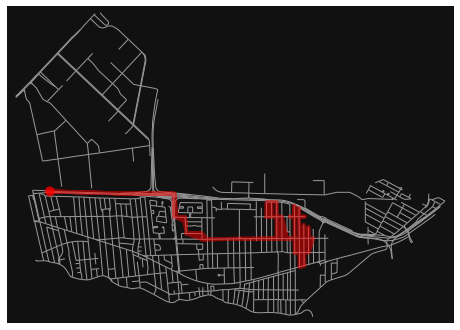

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 14840
time : 59.36 minutes
[95871978, 4198102066, 116408681, 4198101995, 4198102077, 4198101820, 4513516145, 4513516148, 274293746, 274293837, 274293867, 274293760, 274293569, 274293545, 1350936730, 274301744, 274296581, 274296594, 274288125, 274287375, 274287357, 274297103, 274282517, 273557818, 273558016, 273558246, 618150992, 273558288, 273558303, 273558329, 273558368, 273558369, 273555904, 273558329, 273558368, 1350936783, 273556972, 1350936783, 273558135, 273557456, 273558135, 273556972, 273558134, 273557456, 5116306546, 273557494, 273558131, 618150992, 273557495, 273557539, 273557495, 5111996569, 5139737148, 248512692, 273558369, 618151075, 248512693, 274280260, 274336342, 248512692, 248512693, 248512694, 248512695, 248512696, 273556190, 273556119, 5116306536, 273556117, 5116306536, 273425225, 8756253373, 609403687, 2089527314, 273425124, 8756253064, 273425124, 2089527314, 8755699390, 8485269584, 9781714939, 874

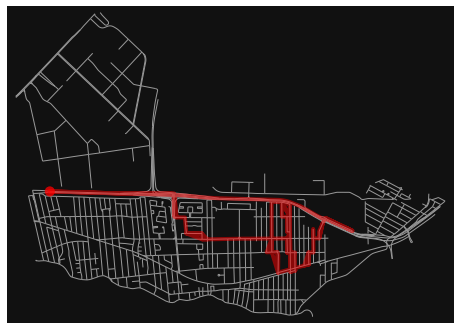

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 15772
time : 63.088 minutes
====================== Saint-Laurent, Montreal, Canada =======================
The graph is eulerian : True
[17052772, 3700802582, 246285256, 246285254, 246285256, 246285265, 246285266, 246285265, 246285263, 486516004, 246285263, 246285252, 246285262, 246285260, 246285262, 246285261, 246285259, 246285260, 246285257, 246285258, 246285259, 246285261, 246285253, 486516004, 246285254, 246285255, 246284660, 246285255, 246284661, 246285275, 246285276, 246285278, 246285269, 246285268, 246285279, 246285268, 246285267, 246285269, 246285278, 246285277, 246285267, 246285277, 246285275, 246284661, 246285271, 246285274, 246285271, 246285274, 246284662, 246285276, 246284662, 246284663, 246285229, 246285215, 246284665, 246285215, 246284664, 4333578874, 4333578873, 4333578874, 4335029150, 4332227370, 4335029150, 4335029148, 4332227369, 4335029148, 4333578873, 246284663, 246284664, 246284665, 246285232, 246

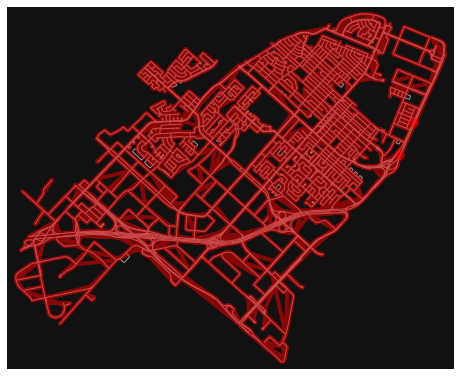

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
[17052772, 3700802582, 246285256, 246285254, 246285256, 246285265, 246285266, 246285265, 246285263, 486516004, 246285263, 246285252, 246285262, 246285260, 246285262, 246285261, 246285259, 246285260, 246285257, 246285258, 246285259, 246285261, 246285253, 486516004, 246285254, 246285255, 246284660, 246285255, 246284661, 246285275, 246285276, 246285278, 246285269, 246285268, 246285279, 246285268, 246285267, 246285269, 246285278, 246285277, 246285267, 246285277, 246285275, 246284661, 246285271, 246285274, 246285271, 246285274, 246284662, 246285276, 246285275, 246284661, 246285255, 246285254, 246285256, 3700802582, 17052772]


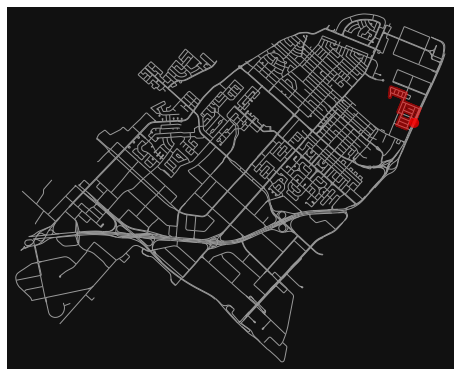

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 6628
time : 26.512 minutes
[17052772, 3700802582, 246285256, 246285254, 246285255, 246284661, 246285271, 246285274, 246284662, 246284663, 246285229, 246285215, 246284665, 246285215, 246284664, 4333578874, 4333578873, 4333578874, 4335029150, 4332227370, 4335029150, 4335029148, 4332227369, 4335029148, 4333578873, 246284663, 246284664, 246284665, 246285232, 246285216, 4332227370, 4332227369, 246285226, 3700802582, 246285226, 246285216, 282041607, 282041604, 6139605437, 246285440, 246285423, 6139605865, 246285428, 246285423, 246285419, 246285428, 246285411, 4344307274, 4344307276, 4344307275, 4344307276, 246285407, 246285416, 476575724, 476575735, 476575724, 246282758, 246282762, 4500365985, 246285416, 246285415, 246285406, 4344307275, 6139605654, 246285412, 246285419, 6139605437, 282041604, 282041607, 246285216, 246285226, 3700802582, 17052772]


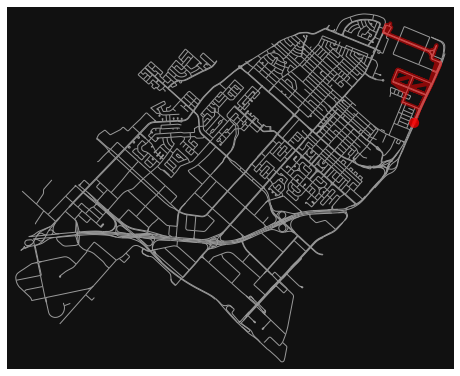

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 11732
time : 46.928 minutes
[17052772, 3700802582, 246285226, 246285216, 282041607, 282041604, 6139605437, 246285419, 246285412, 6139605654, 4344307275, 246285406, 246285415, 246285416, 4500365985, 476569643, 476569670, 9654443365, 476569690, 9654443365, 4500365986, 476569670, 476569656, 476569670, 4500365986, 246285415, 2490486019, 4500347057, 246282785, 4500347057, 2490486023, 2490486019, 2490486023, 4500347058, 3698496211, 246282369, 246285348, 4674585572, 246285346, 246285344, 246285303, 246285340, 246285318, 246285340, 246285338, 246285337, 246285336, 246285335, 246285334, 246285335, 246285313, 246285385, 246285355, 246285385, 246285377, 246285376, 4502313079, 246285375, 4502313079, 4502313087, 4502314589, 4502313085, 486502345, 246282355, 486502345, 246282368, 4502327405, 246285325, 246285323, 246285346, 246282784, 476569690, 9654443365, 4500365986, 246285415, 246285406, 4344307275, 6139605654, 246285412, 246285

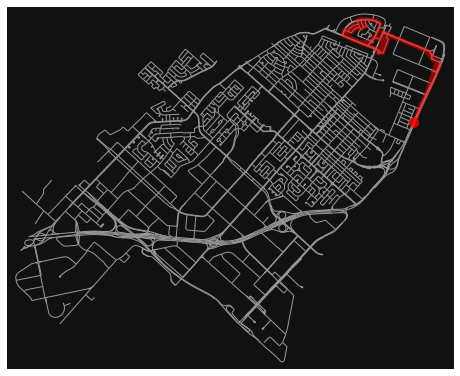

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 10963
time : 43.852 minutes
[17052772, 3700802582, 246285226, 246285216, 282041607, 282041604, 6139605437, 246285419, 246285412, 6139605654, 4344307275, 246285406, 246285415, 4500365986, 9654443365, 476569690, 246282784, 246285346, 246285323, 246285325, 4502327405, 246282368, 486502345, 246282368, 246282356, 4502327406, 246282357, 4502327406, 4502327405, 246285325, 4674585572, 246285348, 246285325, 246285323, 246285325, 472542205, 246285367, 472542205, 246285390, 246285388, 246285390, 246285388, 246285364, 246285353, 246285355, 246285314, 246285336, 246285337, 246285315, 246285359, 246285360, 246285359, 246285360, 246285363, 246285351, 246285363, 246285318, 246285316, 246285318, 246285302, 246285303, 246285344, 246285322, 246285351, 246285353, 246285364, 246285367, 246285377, 246285376, 246285375, 246285312, 246285334, 246285335, 246285313, 246285314, 246285355, 246285353, 246285351, 246285322, 246285323, 246285346, 2

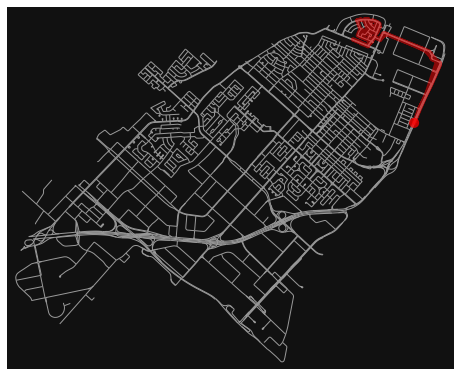

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 11214
time : 44.856 minutes
[17052772, 3700802582, 246285226, 246285216, 282041607, 282041604, 6139605437, 246285419, 246285412, 6139605654, 4344307275, 246285406, 246285415, 4500365986, 9654443365, 476569690, 246282784, 246285346, 246285323, 246285322, 246285351, 246285353, 246285355, 246285314, 246285313, 246285312, 246285310, 246285332, 246285328, 4502313087, 246285310, 246285312, 246285313, 246285314, 246285315, 246285316, 246285338, 246285293, 246285287, 246285332, 246285310, 4502313087, 246285328, 4502313082, 4502313080, 4502313082, 4502313086, 4502314591, 246282354, 246282355, 246282356, 246282368, 4502327405, 246282369, 246282357, 5991808702, 5991808701, 5991808702, 246282358, 3698496211, 246282784, 476569656, 476569647, 8660753697, 476569647, 476569643, 246282762, 4500365985, 246285416, 246285415, 246285406, 4344307275, 6139605654, 4344307274, 6139605654, 246285412, 246285419, 6139605437, 282041604, 282041607

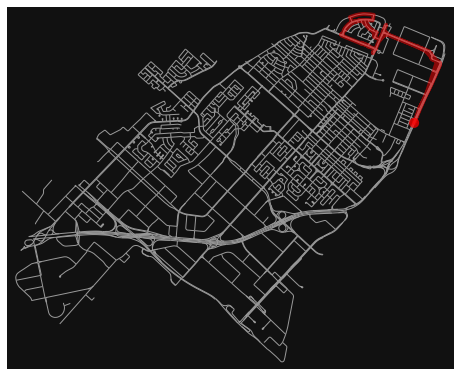

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 10545
time : 42.18 minutes
[17052772, 3700802582, 246285226, 246285216, 282041607, 282041604, 6139605437, 282041604, 282041533, 282043188, 282041533, 282041607, 246285401, 8658742607, 246285402, 246285401, 8658742607, 246285404, 246285412, 246285411, 246285407, 246285406, 246285404, 246285412, 246285419, 246285440, 282043188, 8658774766, 246086844, 3659066778, 3659066745, 17052772, 3700802582, 246285220, 246285221, 246285257, 246285258, 246284659, 5245638587, 246284659, 246284660, 246285253, 246285252, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 4065691425, 4109587564, 5281042258, 473370011, 1843993868, 4810585640, 8632391124, 246285221, 246285220, 3700802582, 17052772]


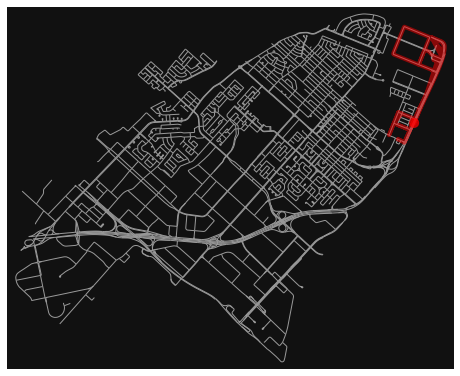

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 12849
time : 51.396 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 5281042258, 4065691415, 4065660814, 4065691415, 3313262022, 3313262006, 3313262007, 8630521161, 2133239441, 8630521161, 246283772, 3622499431, 4065660814, 8632051681, 3313215479, 2133239441, 227778642, 8632051920, 227778642, 32582952, 227778642, 32582952, 98423004, 2133239427, 98423004, 5239457462, 1757220086, 194615667, 194615718, 2063153795, 194615718, 194615667, 1757220086, 5239457462, 98423004, 32582952, 3313262007, 4065691419, 298544001, 4065691419, 4065691418, 3313262006, 3313262022, 31243663, 3622499431, 246283772, 227761294, 581020588, 581020600, 246283750, 581020600, 581020588, 227761294, 246283772, 8630521161, 3313262007, 3313262006, 3313262022, 4065691415, 5281042258, 473370011, 1843993868, 4810585640, 8632391124, 246285221, 246285220, 3700802582, 17052772]


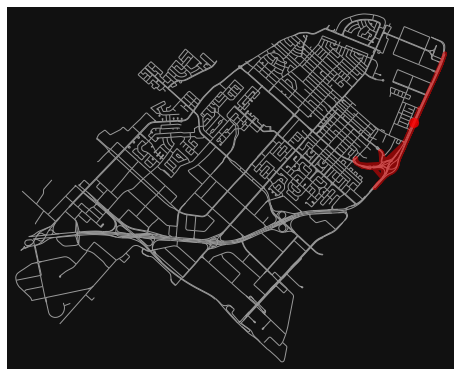

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 17610
time : 70.44 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 5281042258, 4065691415, 3313262022, 3313262006, 3313262007, 8630521161, 246283772, 227761294, 581020588, 581020600, 581020581, 581020588, 227761294, 8632051920, 29217080, 8632051920, 29217080, 215062535, 298140032, 298140033, 298140036, 298140034, 298140032, 298140030, 298140029, 298140030, 298140029, 298140026, 298169962, 298169964, 298169962, 298169964, 298169965, 298169967, 298169965, 298169967, 298169968, 298169970, 298169968, 298169970, 298169952, 298169957, 298169940, 298169941, 298169940, 298169938, 298169937, 298169938, 298169931, 4332066066, 298169909, 4332066066, 4332066065, 298169907, 4332066065, 298177540, 2130282301, 5249511606, 477398846, 5249511606, 2130282301, 298177540, 4332066065, 298169907, 8622075637, 8622075612, 8622075561, 17052778, 17052775, 17052772]


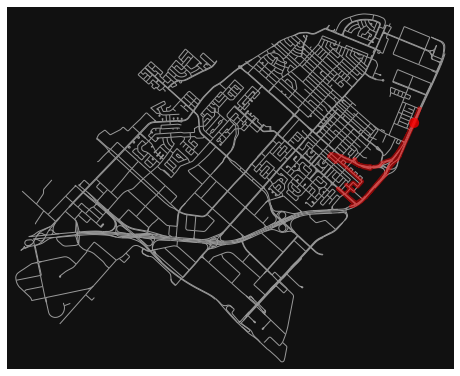

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 10847
time : 43.388 minutes
[17052772, 17052775, 17052778, 8622075561, 8622075612, 8622075637, 298169907, 4332066065, 298177540, 2130282301, 5249511606, 477398846, 2130282096, 2130282101, 2130282097, 477398844, 2130282097, 298169923, 2130282096, 477398846, 298169933, 298169932, 5249511606, 2130282301, 2130282304, 298177538, 298177521, 2130285315, 110756937, 8622075637, 8622075612, 8622075637, 298169907, 298169909, 298169913, 5308862132, 298169913, 298169937, 298169957, 298169952, 298140025, 298140026, 29217080, 215062535, 581020570, 246283622, 246283620, 246283622, 246283621, 246283619, 246283620, 246283622, 581020570, 581020654, 581020642, 581020617, 581020618, 9647399296, 246283596, 581020625, 4502491807, 4502491803, 581020625, 581020618, 581020617, 581020642, 581020654, 581020570, 581020584, 9049452804, 581020581, 581020588, 227761294, 246283772, 8630521161, 3313262007, 3313262006, 3313262022, 4065691415, 528104225

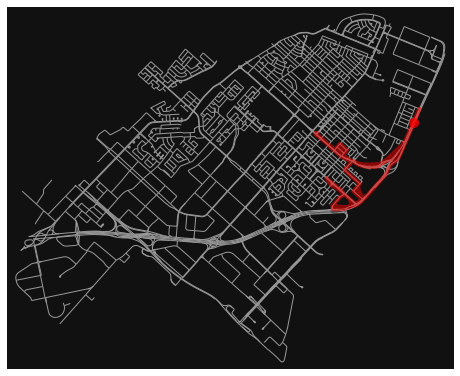

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 12030
time : 48.12 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 5281042258, 4065691415, 3313262022, 3313262006, 3313262007, 8630521161, 246283772, 227761294, 581020588, 581020581, 9049452804, 581020584, 581020570, 581020654, 581020642, 581020617, 581020618, 581020625, 4502491807, 6700781300, 9656053868, 9656053854, 9656109303, 4599909203, 6700781300, 9656053868, 4599545728, 4599545727, 246283595, 4599545728, 658977071, 4502491803, 581020625, 581020618, 4599909203, 9656109303, 215062675, 215062714, 215062709, 246283591, 9656011770, 246283591, 246283587, 246283586, 915136497, 915136518, 7892137091, 915136518, 29217072, 915136518, 215062551, 449080997, 246283584, 580368408, 580368386, 580368405, 915136595, 485767213, 485767100, 485767213, 485767219, 215062619, 485767219, 485767100, 215062560, 485767107, 485767131, 485767107, 215062560, 915136595, 215062614, 33588898,

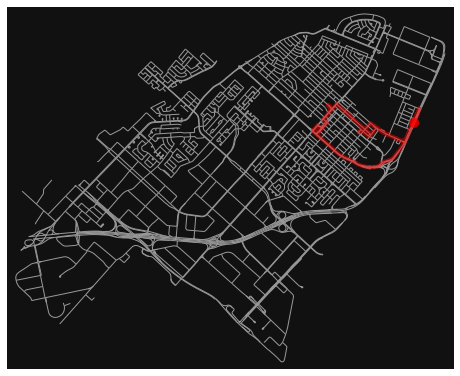

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 9451
time : 37.804 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 246284656, 5245638587, 298544011, 4330900462, 29583134, 33588898, 31243748, 215062609, 215062603, 580368405, 215062563, 3705046812, 3705127905, 215062548, 581020678, 915136521, 215062546, 3705127905, 3705046812, 215062568, 215062556, 246283584, 215062556, 32582567, 449080997, 915136497, 915136520, 581020676, 9656191515, 9649660685, 479079057, 479079021, 215062705, 479079021, 479078986, 479078899, 479078986, 215062668, 215062705, 215062659, 479079057, 9649660685, 33588900, 581020678, 581020676, 9656191515, 9556996479, 215062715, 9556996479, 33588897, 915136520, 32582567, 215062548, 215062568, 580368386, 472502196, 472516614, 472516615, 472516615, 472516614, 472502195, 31243748, 33588898, 29583134, 4330900462, 298544011, 5245638587, 246284656, 4065691422, 4065691425, 

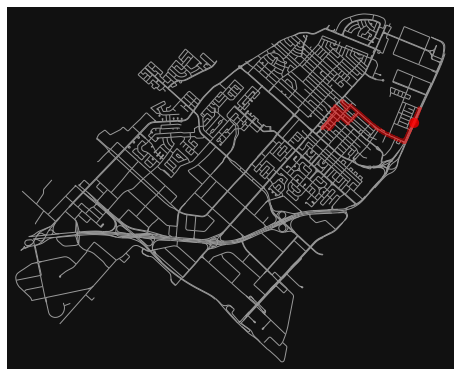

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 9244
time : 36.976 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 246284656, 5245638587, 298544011, 4330900462, 29583134, 33588898, 31243748, 472502195, 476562478, 3705958573, 246283582, 3705958573, 476562478, 246283580, 246283579, 4342881587, 246283524, 246284689, 246283524, 4342881587, 29583132, 246283580, 3705958573, 246283538, 4331898529, 4331898528, 4331898529, 246283537, 246284694, 1344093168, 1344093173, 1344093168, 246284693, 246283550, 246283548, 4330827451, 4330827453, 4330827452, 4330827454, 4330827452, 4330827451, 4330827453, 469065095, 246283481, 469065095, 4330827454, 2972424632, 2972424733, 246284696, 246284695, 246284696, 246283483, 246283550, 246284693, 485797216, 9807062888, 246283537, 4331898529, 246283538, 3705958573, 476562478, 472502195, 31243748, 33588898, 29583134, 4330900462, 298544011, 5245638587, 2462846

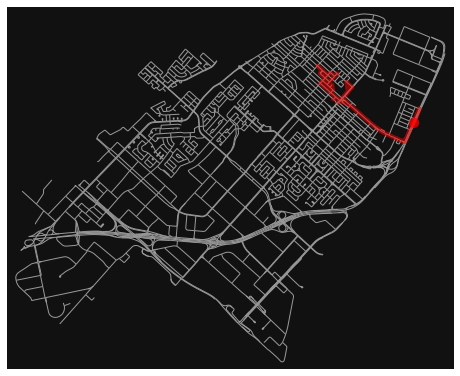

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 9988
time : 39.952 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 246284656, 5245638587, 298544011, 4330900462, 29583134, 33588898, 31243748, 472502195, 476562478, 3705958573, 246283538, 4331898529, 246283537, 246283536, 246283537, 246284694, 29583132, 246283538, 31629083, 4331898528, 246283536, 246283544, 246283541, 246283542, 246283477, 246283542, 3701004349, 246283417, 3701004349, 246283471, 246283541, 246283527, 246283536, 246283544, 246282794, 246283471, 246283530, 3705936594, 246283546, 246283535, 246283547, 246283535, 246283531, 246283530, 246283529, 246283530, 3705936594, 246283460, 3705936594, 246283463, 246283528, 246283383, 246283528, 4365908826, 4365908822, 4365908820, 9648852534, 4365908819, 4365908820, 29217085, 9648994935, 9649232653, 9648994935, 9649232653, 29217075, 581020614, 29217073, 246283590, 246283596, 96473

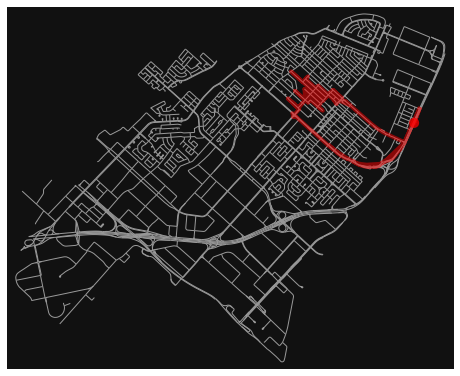

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 14340
time : 57.36 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 5281042258, 4065691415, 3313262022, 3313262006, 3313262007, 8630521161, 246283772, 227761294, 581020588, 581020581, 29217080, 215062535, 29217078, 298140033, 298140036, 298140054, 298140078, 298137784, 298137778, 298137777, 298137793, 298137794, 298137780, 298137779, 477364669, 29598757, 298542185, 298136477, 298542175, 29217082, 29217083, 31242491, 298542218, 298542230, 4365908791, 4365908792, 4365908791, 298541222, 606796428, 298541222, 4365908789, 4365908792, 4365908795, 4365908801, 4365908795, 298542230, 298541217, 298542171, 486838391, 298542182, 486838391, 298542176, 298542198, 298542202, 298542198, 298542176, 298542174, 298542172, 298542218, 4365908801, 31243457, 4365908806, 4332033848, 4332033846, 4332033848, 31242310, 31242490, 298562007, 4592125052, 298562004, 298562000, 298561997, 298561996

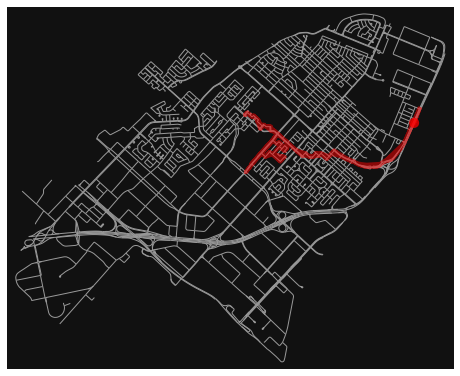

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 15932
time : 63.728 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 5281042258, 4065691415, 3313262022, 3313262006, 3313262007, 8630521161, 246283772, 227761294, 581020588, 581020581, 29217080, 215062535, 29217078, 298140033, 298140036, 298140054, 298140078, 298137784, 298137778, 298137777, 298137793, 298137794, 298137780, 298137779, 477364669, 29598757, 298542185, 298136477, 298542175, 29217082, 29217083, 4365908806, 4332033848, 31242310, 31242490, 298562007, 298562000, 298561997, 298561996, 298561990, 298562004, 31242495, 31242625, 31243109, 29599058, 31243109, 31242628, 29599057, 31242498, 31242497, 31242625, 31242495, 31242497, 298561990, 29217089, 298561990, 298561997, 298562000, 298562007, 31242490, 31242311, 4592125052, 31242495, 31243427, 31243426, 31243427, 31242311, 31242310, 31243426, 4332033846, 31243457, 31242491, 4366364704, 477364679, 477364680, 477364

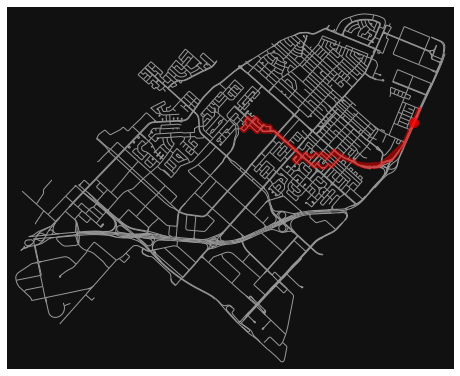

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 14236
time : 56.944 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 5281042258, 4065691415, 3313262022, 3313262006, 3313262007, 8630521161, 246283772, 227761294, 581020588, 581020581, 29217080, 215062535, 298140032, 298140034, 298140052, 298140041, 298140042, 298140063, 298140069, 298140068, 298140065, 298140019, 298176683, 477364675, 477364685, 4592527503, 477364685, 4592527503, 477364684, 298137779, 477364669, 477364802, 477364810, 477364673, 298137805, 298137806, 298137788, 298137806, 298137787, 298137783, 298137788, 477364802, 298137814, 298136466, 298137814, 29598757, 477364669, 477364683, 2130282100, 298542221, 477364682, 29598757, 298542185, 298136477, 298542185, 477364681, 298542184, 298542202, 298542184, 298542182, 298542221, 298174510, 298542221, 2130282100, 477364763, 477364670, 477364671, 298528205, 298541193, 298541236, 479993593, 479993578, 479993593, 2

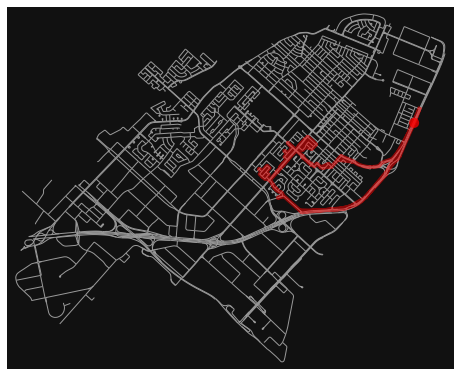

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 14465
time : 57.86 minutes
[17052772, 17052775, 17052778, 8622075561, 8622075612, 8622075637, 110756937, 2130285315, 110756942, 9796317771, 8621966396, 298530302, 606288330, 486848935, 298528179, 298528224, 298528221, 298528201, 477364671, 298528205, 298541193, 298541195, 298541244, 298541236, 298541193, 298541195, 298541197, 298541205, 479993578, 298541213, 298541215, 298541213, 298541222, 4365908789, 4749908596, 606798145, 606802227, 4332065306, 4331917494, 4332065306, 4332065305, 4331917493, 4332065305, 606801045, 606802227, 1843396778, 606288272, 606288267, 4331917494, 4331917493, 606288268, 1843396777, 1843396779, 6151696429, 9780449172, 8622075465, 8604402231, 8622075465, 6151696429, 9780449172, 8622071716, 9796317778, 110756956, 9796317778, 2777811263, 8622071716, 2777811263, 606966278, 4905455046, 606966278, 606785162, 4590890637, 4590890629, 245481313, 606288330, 298530302, 8621966396, 9796317771, 110756942, 

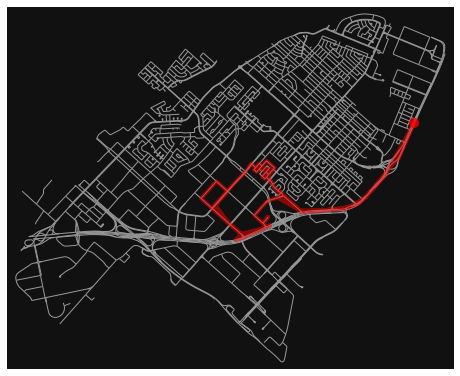

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 16873
time : 67.492 minutes
[17052772, 17052775, 17052778, 8622075561, 8622075612, 8622075637, 110756937, 2130285315, 110756942, 9796317771, 8621966396, 298530302, 606288330, 245481313, 4590890642, 4590890629, 4590890637, 606785162, 5414403439, 245569269, 5414403439, 8629942499, 245569269, 1843396779, 245471080, 110756966, 245471080, 8619271086, 8619276517, 8619276544, 8281251599, 8619293734, 8619284876, 8619293734, 8604370306, 8619276517, 8619271086, 9768147179, 8618142999, 9768147179, 606288203, 8604345229, 17052789, 8604345229, 8604345218, 9770112551, 8604345218, 8604345226, 116346953, 8604345226, 1766876419, 8604420524, 1766876576, 8604420524, 8618066766, 9767985459, 8615970407, 9767985459, 493879835, 8615970407, 9767985450, 9767985449, 9767985450, 8616050638, 9767985450, 8615970407, 9767985459, 8618066766, 6128389411, 9768147181, 8618066776, 9768147178, 110756977, 606288203, 9768147179, 8618142999, 110756966, 860

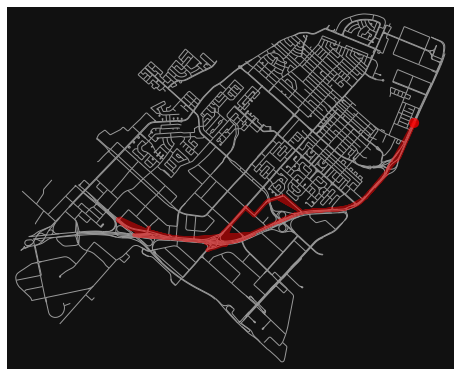

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 26909
time : 107.636 minutes
[17052772, 17052775, 17052778, 8622075561, 8622075612, 8622075637, 110756937, 2130285315, 110756942, 9796317771, 8621966396, 8621966393, 110756949, 110756955, 110756956, 9796317778, 8622071716, 9780449172, 8622075465, 8604402231, 110756966, 8618142999, 9768147179, 606288203, 110756977, 9768147178, 8618066776, 9768147181, 6128389411, 8618066766, 9767985459, 493879835, 493879836, 8616050638, 9767985449, 8617746484, 8617746447, 8617746484, 493879852, 8617746400, 9767985470, 9767959615, 9767985470, 8617746405, 8617746400, 493879852, 8617746447, 493879851, 493879819, 493879851, 493879841, 493879804, 493879808, 493879842, 493879843, 493879842, 493879808, 493879805, 8617746405, 493879805, 493879804, 493879841, 493879855, 5247010703, 298551487, 298551486, 298551487, 298549892, 298551130, 298551131, 298551131, 298551130, 298551120, 298551121, 298551121, 298551120, 298551112, 298551113, 298551113, 2

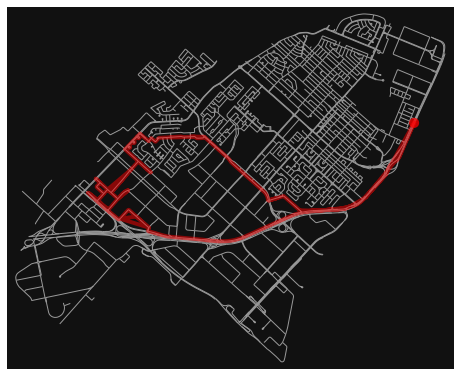

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 22175
time : 88.7 minutes
[17052772, 17052775, 17052778, 8622075561, 8622075612, 8622075637, 110756937, 2130285315, 110756942, 9796317771, 8621966396, 298530302, 606288330, 245481313, 4590890642, 245569282, 245569283, 9659701711, 245569290, 606795747, 606798145, 245569292, 245569294, 716012036, 4053732235, 4332076208, 716012035, 1810272078, 4129030600, 716138633, 716138710, 298547558, 298547560, 5247010748, 298547561, 298551492, 2629942903, 298547536, 4696828967, 298551109, 9522381645, 298551110, 1843396909, 4488952847, 1843396906, 1843396909, 2629942901, 486363622, 486363642, 486363707, 486363707, 486363642, 486363622, 486363555, 9522418014, 486363016, 9522418014, 486363555, 5532163726, 4129056149, 5532163726, 4129030601, 5412324611, 5412324610, 5412324611, 5412324609, 5412324608, 5412324609, 4570061621, 5412324609, 5412324611, 4129030601, 3698439947, 4129030601, 2629942877, 2629942879, 2629942877, 2629942881, 968612

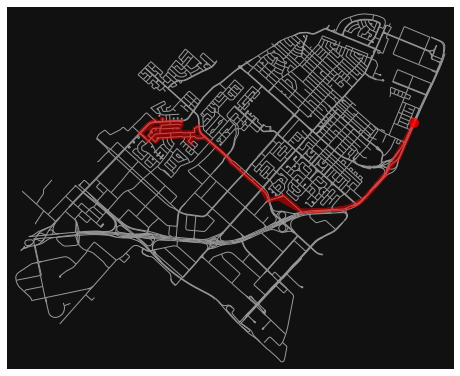

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 20204
time : 80.816 minutes
[17052772, 17052775, 17052778, 8622075561, 8622075612, 8622075637, 110756937, 2130285315, 110756942, 9796317771, 8621966396, 298530302, 606288330, 245481313, 4590890642, 245569282, 245569283, 9659701711, 245569290, 606795747, 606798145, 245569292, 245569294, 716012036, 4053732235, 4332076208, 716012035, 1810272078, 5247010776, 1806698051, 1806698053, 1806698059, 1806698065, 1806698059, 1806698053, 1806698056, 1806698061, 1806698048, 1806698061, 1806698063, 1806698058, 1806698063, 5250453018, 716138727, 5250453018, 716138710, 716138633, 716138710, 298547558, 298547560, 298547550, 298547558, 298547567, 5247010795, 716138633, 4129030600, 1810272078, 716014125, 1228660937, 2095367037, 298560768, 2095367037, 2095367039, 1281879447, 2095367039, 1281879447, 1228660919, 298560774, 1228660919, 298560774, 298560765, 298560749, 3752756430, 298560759, 298560761, 298560763, 298560762, 298560763, 2985607

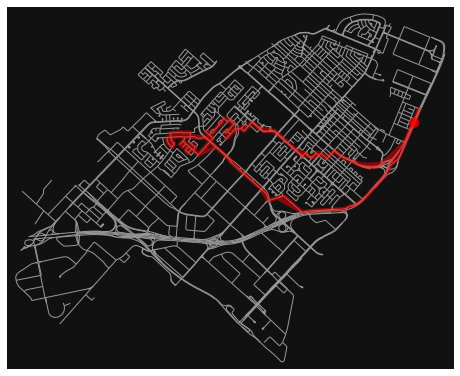

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 18188
time : 72.752 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 5281042258, 4065691415, 3313262022, 3313262006, 3313262007, 8630521161, 246283772, 227761294, 581020588, 581020581, 29217080, 215062535, 29217078, 298140033, 298140036, 298140054, 298140078, 298137784, 298137778, 298137777, 298137793, 298137794, 298137780, 298137779, 477364669, 29598757, 298542185, 298136477, 298542175, 29217082, 29217083, 4365908806, 4332033848, 31242310, 31242311, 4592125052, 31242495, 31242497, 31242625, 31243109, 29599058, 31243405, 3752755908, 31410114, 298560759, 298560761, 298560762, 298560751, 298560752, 298560755, 298560752, 298560755, 31243104, 1766803120, 1766803120, 31243104, 31243105, 298560751, 298560750, 1228660937, 298560750, 298560749, 298560765, 3752756433, 3752756434, 2934336612, 2934336618, 2934336612, 3426884475, 7077707210, 5175739643, 7502057290, 4815907770, 75

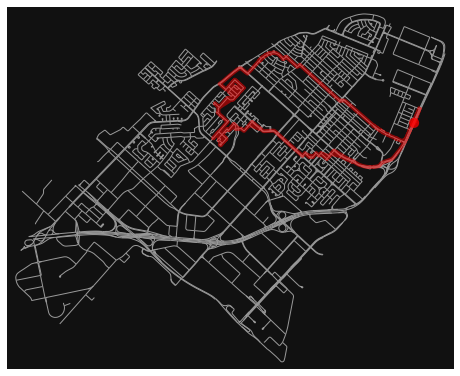

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 17650
time : 70.6 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 5281042258, 4065691415, 3313262022, 3313262006, 3313262007, 8630521161, 246283772, 227761294, 581020588, 581020581, 9049452804, 581020584, 581020570, 581020654, 581020642, 31243749, 215062637, 9647399296, 246283596, 246283590, 29217073, 581020614, 29217075, 9649232653, 29217085, 4365908820, 9648852534, 4331950929, 480455583, 9649000746, 9649048464, 493881793, 5743311159, 298561482, 4376756816, 298561486, 9649048497, 4376756819, 4376741925, 9649048497, 298561498, 298561501, 298561483, 298561501, 298561484, 4376756816, 298561486, 4376741925, 298561486, 4376756819, 298561489, 298561492, 298561491, 298561500, 298561491, 298561490, 298561489, 298561490, 298561500, 298561498, 298561496, 298561494, 298561509, 298561510, 298561493, 298561480, 298561492, 298561494, 298561496, 298561482, 4376756816, 298561484, 2

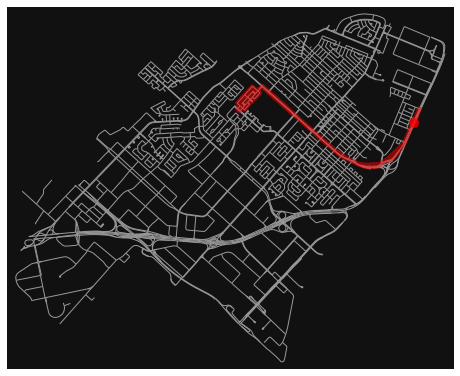

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 14515
time : 58.06000000000001 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 5281042258, 4065691415, 3313262022, 3313262006, 3313262007, 8630521161, 246283772, 227761294, 581020588, 581020581, 9049452804, 581020584, 581020570, 581020654, 581020642, 581020617, 581020618, 581020625, 4502491803, 658977071, 581020620, 581020611, 581020633, 581020638, 4365908822, 4331950930, 1849279244, 1849279245, 2482291518, 9649048471, 2482291518, 9649048464, 493881793, 9649048471, 246283354, 2020684172, 9649053421, 4500104061, 9523114548, 1247647243, 3426884463, 4343394529, 4739777512, 4343394529, 3426884466, 3426884475, 3426884466, 3426884464, 4739777512, 3426884464, 2934336609, 2934336618, 2934336613, 2934336609, 2934336613, 2934336598, 2065449372, 5217235136, 2934336593, 2934336588, 5217235136, 2934336569, 2934336621, 2934336602, 2934336562, 2934336580, 2934336574, 2934336580, 20

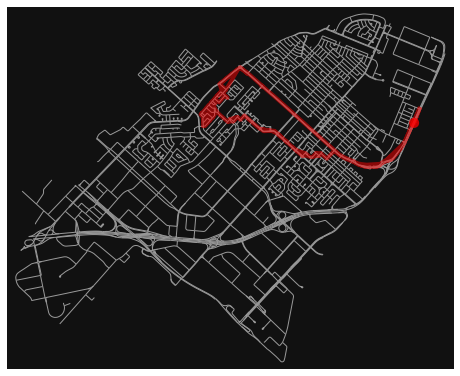

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 16768
time : 67.072 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 5281042258, 4065691415, 3313262022, 3313262006, 3313262007, 8630521161, 246283772, 227761294, 581020588, 581020581, 29217080, 215062535, 29217078, 298140033, 298140036, 298140054, 298140078, 298137784, 298137778, 298137777, 298137793, 298137794, 298137780, 298137779, 477364669, 29598757, 298542185, 298136477, 298542175, 29217082, 29217083, 4365908806, 4332033848, 31242310, 31242311, 4592125052, 31242495, 31242497, 31242498, 59892751, 59892756, 59892770, 31242530, 3752756430, 298560749, 298560765, 3752756433, 298560768, 2065451554, 716014210, 1228660920, 298549924, 486363016, 486363008, 486362955, 486362955, 486363008, 486090591, 5225396377, 5225396374, 5225396377, 486090591, 486363008, 486362817, 486362823, 486362823, 486362817, 486363850, 486363860, 486363860, 486363850, 298549870, 486363593, 486363

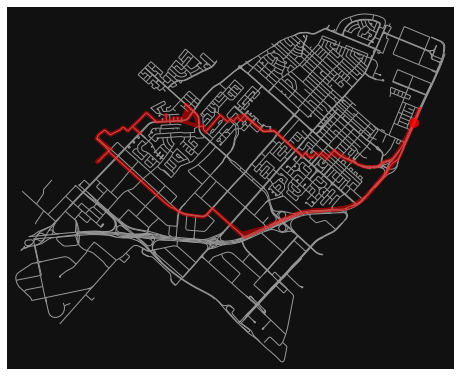

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 21901
time : 87.604 minutes
[17052772, 17052775, 17052778, 8622075561, 8622075612, 8622075637, 110756937, 2130285315, 110756942, 9796317771, 8621966396, 8621966393, 110756949, 110756955, 110756956, 9796317778, 8622071716, 9780449172, 8622075465, 8604402231, 110756966, 8618142999, 9768147179, 606288203, 110756977, 9768147178, 8618066776, 9768147181, 6128389411, 8615091496, 6128389409, 493879821, 493879820, 493879819, 493879851, 493879841, 493879804, 493879808, 493879842, 493879843, 607759155, 607759156, 605207038, 4686563252, 605207032, 4686563252, 605207045, 607759155, 8613560265, 8613560324, 8617779680, 8613560265, 8613560324, 9767959615, 116352308, 116346953, 8604420559, 8604370283, 8604420559, 8604370283, 8604370281, 8604370246, 8604370281, 8604370283, 8613157821, 116443132, 8613157821, 110744798, 9768147172, 606288096, 8604370337, 8621806124, 9780449166, 8621806124, 110744815, 245485107, 9796400250, 245485117, 979

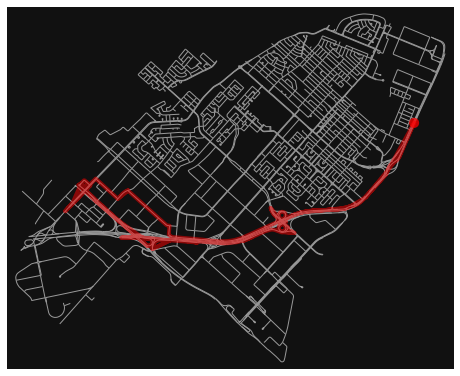

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 27881
time : 111.52400000000002 minutes
[17052772, 17052775, 17052778, 8622075561, 8622075612, 8622075637, 110756937, 2130285315, 110756942, 9796317771, 8621966396, 8621966393, 110756949, 110756955, 110756956, 8621966581, 4590890629, 245481313, 9662865854, 245485094, 9662865854, 1843396775, 245485094, 8621966393, 8621966396, 298530302, 8621966396, 9796317771, 227856404, 8604402243, 110756949, 8621966393, 298530302, 606288330, 245481313, 606288330, 486848935, 298528179, 298528224, 298528221, 298528224, 298528221, 298528201, 298528264, 298528265, 298528173, 298528265, 298528264, 298528201, 477364671, 298528205, 245569271, 245569289, 9659701710, 9659701711, 245569290, 9659701710, 245569289, 606796428, 606795747, 606801045, 31410110, 8629942499, 245569282, 4590890642, 245481313, 606288330, 298530302, 8621966396, 9796317771, 110756942, 2130285315, 110756937, 8622075637, 8622075612, 8622075561, 17052778, 17052775, 17052772]

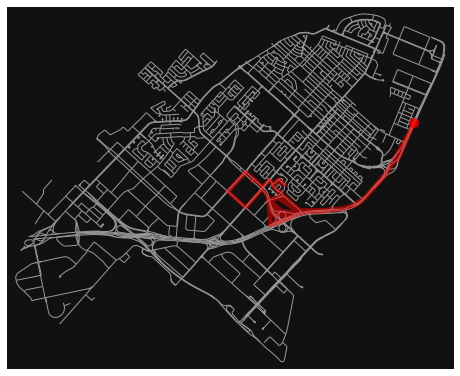

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 18014
time : 72.056 minutes
[17052772, 17052775, 17052778, 8622075561, 8622075612, 8622075637, 110756937, 2130285315, 110756942, 9796317771, 8621966396, 298530302, 606288330, 245481313, 4590890642, 245481313, 8629797570, 4625168023, 8629797570, 245569270, 245569282, 245569283, 9659701711, 245569290, 606795747, 606798145, 245569292, 245569294, 245569293, 9659669646, 3647600917, 9659669646, 716011812, 3647600917, 31243405, 31242531, 31410114, 31242531, 59892756, 59892751, 59892756, 59892770, 3752756430, 31242523, 298561509, 298561480, 298561984, 59892751, 298561984, 29217089, 31242498, 59892751, 298561493, 298561510, 31242523, 3752756430, 31242530, 59892770, 31242530, 31242531, 59892756, 31242627, 29599057, 31242627, 29599057, 31242498, 31242497, 31242495, 4592125052, 31242311, 31242310, 4332033848, 4365908806, 29217083, 29217082, 298542175, 298136477, 298542185, 29598757, 477364669, 298137779, 298137780, 298137794, 298

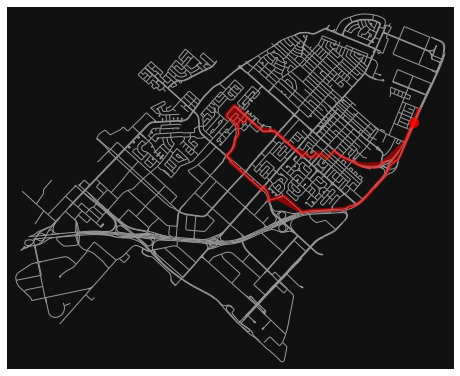

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 15025
time : 60.1 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 5281042258, 4065691415, 3313262022, 3313262006, 3313262007, 8630521161, 246283772, 227761294, 581020588, 581020581, 29217080, 215062535, 29217078, 298140033, 298140036, 298140054, 298140078, 298137784, 298137778, 298137777, 298137793, 298137794, 298137780, 298137779, 477364669, 29598757, 298542185, 298136477, 298542175, 29217082, 29217083, 4365908806, 4332033848, 31242310, 31242311, 4592125052, 31242495, 31242497, 31242625, 31243109, 31242628, 29217092, 31242628, 29217092, 29599058, 31243405, 3752755908, 3647600931, 4332076209, 716011813, 4332076209, 4332076208, 4053732235, 3647600931, 716011812, 716012036, 4053732235, 31410090, 4053732235, 4332076208, 716012035, 1810272078, 5247010776, 1806698051, 1806698053, 1806698056, 1806698048, 1806698051, 5247010776, 716138476, 2629942818, 2386550434, 2386550422

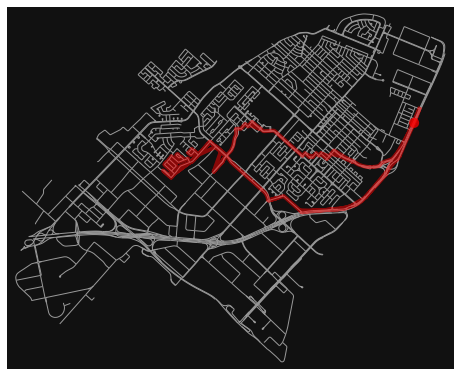

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 19807
time : 79.228 minutes
[17052772, 17052775, 17052778, 8622075561, 8622075612, 8622075637, 110756937, 2130285315, 110756942, 9796317771, 8621966396, 298530302, 606288330, 245481313, 4590890642, 245569282, 245569283, 9659701711, 245569290, 606795747, 606798145, 245569292, 245569294, 716012036, 4053732235, 4332076208, 716012035, 1810272078, 5247010776, 716138476, 716138495, 716138466, 1806698039, 716138466, 298547551, 5247010750, 5247010748, 5247010750, 298547545, 298547539, 298547539, 298547545, 298547552, 298547544, 298547552, 298547551, 298547550, 298547560, 5247010748, 298547561, 298551492, 298547561, 298551492, 2629942903, 298547536, 5247010772, 5247010759, 298547640, 298547642, 298547645, 298547642, 298547645, 298547630, 5247010773, 298547630, 298547638, 298547639, 298547638, 298547639, 298547640, 5247010759, 298547653, 298547661, 298547653, 298547661, 5247010772, 298547536, 4696828967, 298547536, 298547538, 2

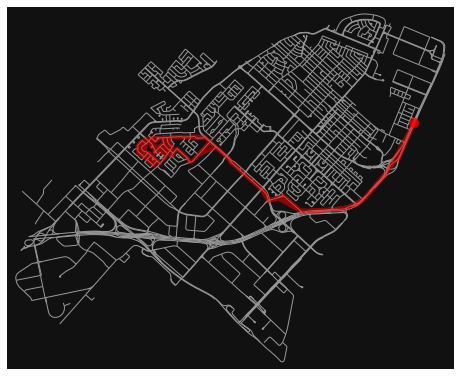

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 20508
time : 82.032 minutes
[17052772, 17052775, 17052778, 8622075561, 8622075612, 8622075637, 110756937, 2130285315, 110756942, 9796317771, 8621966396, 298530302, 606288330, 245481313, 4590890642, 245569282, 245569283, 9659701711, 245569290, 606795747, 606798145, 245569292, 245569294, 716012036, 4053732235, 4332076208, 716012035, 1810272078, 4129030600, 716138633, 716138710, 298547558, 298547560, 5247010748, 5247010750, 298547545, 298547539, 298547541, 298547541, 298547541, 298547543, 298547543, 298547543, 298547544, 5247010773, 2386550418, 2386550422, 2386550418, 298551486, 493879826, 606288152, 606288140, 6671424040, 606288130, 606288140, 606288149, 606288121, 606288130, 245571023, 606288130, 606288140, 606288152, 493879826, 606288152, 493879853, 493879826, 298551486, 245571025, 493879853, 606288114, 606288149, 606288085, 8618066767, 8618066776, 9768147178, 8618066776, 9768147181, 8618066767, 9768147181, 6128389411

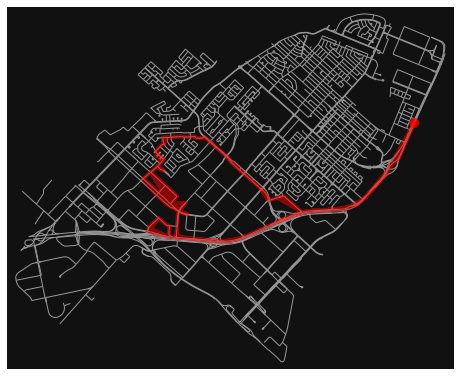

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 23486
time : 93.944 minutes
[17052772, 17052775, 17052778, 8622075561, 8622075612, 8622075637, 110756937, 2130285315, 110756942, 9796317771, 8621966396, 8621966393, 110756949, 110756955, 110756956, 9796317778, 8622071716, 9780449172, 8622075465, 8604402231, 110756966, 8618142999, 9768147179, 606288203, 110756977, 9768147178, 8618066776, 9768147181, 6128389411, 8618066766, 9767985459, 493879835, 493879836, 493879820, 606288114, 245571028, 493879855, 298551140, 493879842, 607759156, 605207038, 605207037, 605207062, 607279608, 607279555, 605207018, 605207062, 607279608, 607279626, 607279632, 8617746330, 8617746345, 9767985486, 8617746345, 9767985487, 8613661436, 9767985487, 8617746330, 607279632, 607279582, 607279584, 607279582, 8613661437, 9767985491, 8613661437, 8613661436, 9767985491, 8604420505, 9768147163, 8604420534, 1766876419, 8604420534, 8604420564, 9767975228, 8615977621, 9767975228, 8604370246, 8604370228, 860

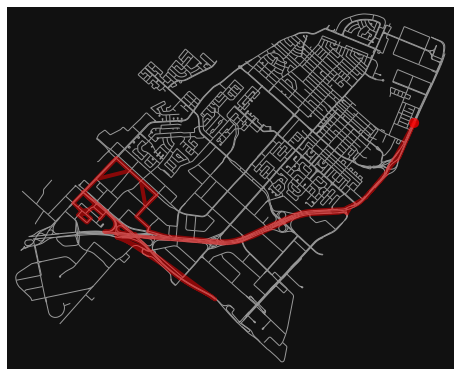

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 29457
time : 117.828 minutes
[17052772, 17052775, 17052778, 8622075561, 8622075612, 8622075637, 110756937, 2130285315, 110756942, 9796317771, 8621966396, 8621966393, 110756949, 110756955, 110756956, 9796317778, 8622071716, 9780449172, 8622075465, 8604402231, 110756966, 8618142999, 9768147179, 606288203, 110756977, 9768147178, 8618066776, 9768147181, 6128389411, 8618066766, 8604420524, 1766876419, 8604420534, 9768147163, 8604420505, 9768147163, 116474772, 8606907543, 8606907592, 8606907478, 8606907583, 245354955, 8606907583, 605207012, 8606907592, 8606907478, 8606907396, 245354944, 8604332270, 605206940, 9770109898, 8604332294, 98422950, 8604332294, 8604370228, 245354931, 8604370228, 245354931, 8604332270, 245354944, 245354899, 8606907396, 245354899, 245354931, 245354899, 245354859, 245354869, 245354864, 245354869, 245354861, 245358037, 8169487851, 9279066080, 8169487851, 4330765680, 8169487851, 245358037, 245354861, 2

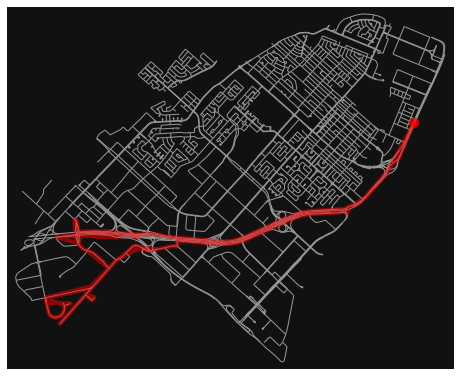

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 34000
time : 136.0 minutes
[17052772, 17052775, 17052778, 8622075561, 8622075612, 8622075637, 110756937, 98367588, 6050265324, 9795913719, 8621806285, 9795873012, 110744827, 245485132, 4072253881, 245485107, 110744815, 8621806124, 9780449166, 8621804646, 8281251599, 8619293734, 8604370306, 606288097, 9768147172, 110744798, 245462191, 245462215, 5414248537, 5414248206, 5414248522, 5414248540, 245363821, 245354865, 245354864, 245354869, 245354861, 4581427781, 605206668, 4143340374, 5586159124, 4143340385, 5586159124, 4143340374, 605206667, 245354779, 245354774, 3730704599, 1247747126, 8935199462, 245091999, 8935199462, 1247747140, 245354706, 1247747140, 1247747126, 3730704599, 245088922, 245354706, 245354720, 245354717, 245354720, 605206669, 245088922, 245354779, 245354774, 605206667, 605206668, 4581427781, 245354861, 245354869, 245354859, 245354899, 605206940, 110735562, 245092181, 245092029, 245092155, 245092140, 2450

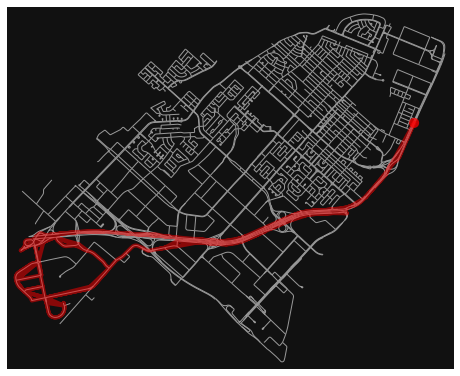

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 32272
time : 129.088 minutes
[17052772, 17052775, 17052778, 8622075561, 8622075612, 8622075637, 110756937, 2130285315, 110756942, 9796317771, 8621966396, 8621966393, 110756949, 110756955, 110756956, 9796317778, 8622071716, 9780449172, 8622075465, 8604402231, 110756966, 8618142999, 9768147179, 606288203, 110756977, 9768147178, 8618066776, 9768147181, 6128389411, 8618066766, 8604420524, 1766876419, 8604420534, 9768147163, 116474772, 8606907543, 245354955, 9770109901, 9770109914, 9770109913, 244201847, 9770112482, 605206809, 605206810, 245091996, 245091999, 245092140, 1247747090, 1247747093, 1247747090, 245354717, 1247747093, 245354836, 245354825, 245354825, 245354836, 245354859, 245354864, 245354865, 245363821, 245354865, 245363821, 5414248540, 5414248522, 5414248540, 5414248523, 5414248208, 5414248537, 5414248206, 5414248208, 4376701397, 4376701406, 4376701409, 245462197, 245462213, 245462213, 245462197, 4376701409, 86

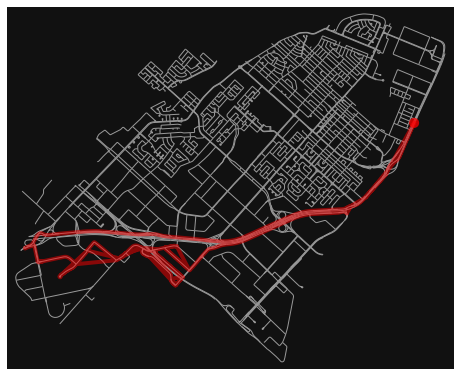

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 27191
time : 108.764 minutes
[17052772, 17052775, 17052778, 8622075561, 8622075612, 8622075637, 110756937, 98367588, 6050265324, 9795913719, 8621806285, 9795873012, 110744827, 245485132, 4072253881, 245485107, 110744815, 8621806124, 9780449166, 8621804646, 8281251599, 8619276544, 4332013050, 8619303554, 1656948335, 606288173, 606288159, 9779646893, 606288173, 1656948335, 8619303554, 4332013050, 8619303554, 1656948334, 8619304516, 1656948334, 1656948335, 1656948338, 245465040, 606288084, 606288082, 606288058, 606287505, 245462197, 245462217, 606288084, 245462191, 110744798, 9768147172, 606288097, 8604370306, 606288097, 245465138, 8619284876, 8618143010, 245471088, 1843396777, 31410110, 245569269, 31410110, 245569283, 245569271, 298528205, 298528162, 298541197, 298541205, 298541215, 298541217, 298542171, 298542172, 298542174, 477364679, 298542175, 29217082, 4366364704, 29217082, 298542175, 298136477, 298542185, 29598757

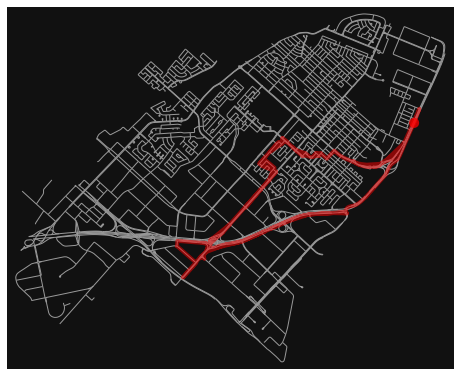

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 16998
time : 67.992 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 5281042258, 4065691415, 3313262022, 3313262006, 3313262007, 8630521161, 246283772, 227761294, 581020588, 581020581, 29217080, 215062535, 29217078, 298140033, 298140036, 298140054, 298140078, 298137784, 298137778, 298137777, 298137793, 298137794, 298137780, 298137779, 477364669, 29598757, 298542185, 298136477, 298542175, 298136477, 477364680, 298136477, 298136475, 298136487, 298136475, 298136472, 298136471, 298136472, 298136484, 298136471, 298136468, 298136484, 298136468, 298136466, 477364810, 298136466, 298136488, 581020609, 581020614, 581020609, 298136488, 298136490, 298136488, 477364673, 477364811, 298137807, 477364811, 246283590, 246283596, 9647399296, 215062637, 581020617, 246283632, 479078863, 479078836, 479078863, 479078899, 246283630, 246283632, 246283633, 246283629, 246283633, 581020642, 3124

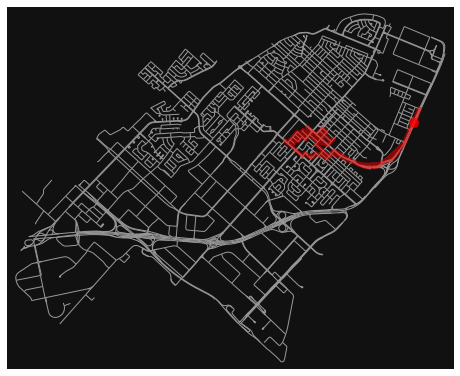

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 12407
time : 49.628 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 5281042258, 4065691415, 3313262022, 3313262006, 3313262007, 8630521161, 246283772, 227761294, 581020588, 581020581, 29217080, 215062535, 29217078, 298140033, 298140036, 298140054, 298140078, 298140054, 298140052, 298140041, 4592641911, 477364672, 477364674, 4625163309, 4625163310, 298175339, 4625163310, 477364676, 4625163312, 4625163308, 477364686, 4625163308, 4625163307, 4625163311, 4625163307, 4625163312, 4625163313, 298175345, 477364676, 4625163309, 477364674, 298140018, 298175345, 4625163313, 298140019, 298176683, 4592622644, 477364675, 477364686, 298140019, 298140065, 298140068, 298140069, 298140063, 298140062, 298140069, 298140068, 298140066, 298140065, 298140066, 298140047, 298140046, 298140047, 298137784, 4592622644, 298137774, 4592622644, 298176683, 298140019, 298140065, 298140068, 298140069

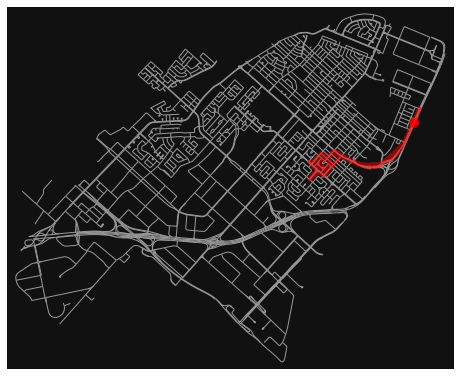

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 10823
time : 43.292 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 5281042258, 4065691415, 3313262022, 3313262006, 3313262007, 8630521161, 246283772, 227761294, 581020588, 581020581, 29217080, 215062535, 29217078, 298140033, 298140036, 298140054, 298140078, 298137784, 298137778, 298137777, 298137793, 298137794, 298137780, 298137779, 298137780, 298137781, 298137794, 298137793, 298137777, 298137776, 298137793, 298137794, 298137780, 298137781, 298137783, 298137787, 298137786, 298137785, 298137786, 298137785, 298137778, 298137784, 298176683, 477364675, 298176669, 298176671, 298176665, 298176669, 477364675, 477364685, 298137774, 298137776, 298137777, 298137778, 298137784, 298140078, 298137801, 298140028, 298140033, 29217078, 215062535, 581020570, 581020584, 246283628, 581020584, 9049452804, 581020581, 29217080, 9049452804, 246283750, 215062743, 4357627505, 215062743, 215

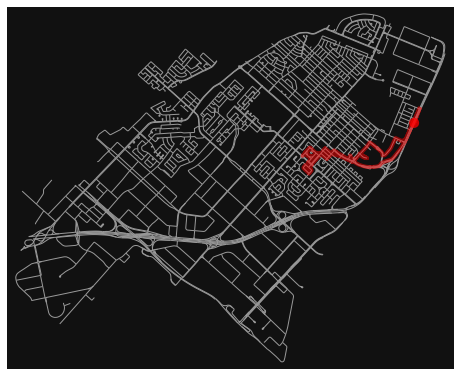

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 10403
time : 41.612 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 246284656, 4065691418, 4065691419, 298544001, 227778652, 215062643, 215062743, 215062737, 580368312, 580368312, 215062737, 215062733, 215062686, 215062647, 298544109, 215062647, 215062686, 215062733, 246283624, 246283623, 246283624, 246283628, 246283623, 215062541, 246283620, 215062541, 33588903, 215062541, 215062686, 215062690, 215062696, 479079738, 33588904, 479079738, 215062668, 246283630, 246283629, 33588904, 33588903, 33588904, 215062696, 215062655, 215062659, 33588900, 31243751, 915136521, 4344285536, 915136524, 581020692, 915136524, 4344285536, 33588902, 485767131, 33588901, 215062560, 915136595, 215062614, 33588898, 29583134, 4330900462, 298544011, 5245638587, 246284656, 4065691422, 4065691425, 4109587564, 473370011, 1843993868, 4810585640, 8632391124, 2462

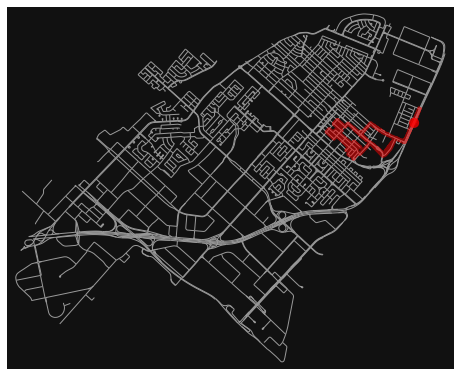

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 10641
time : 42.564 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 246284656, 5245638587, 298544011, 4330900462, 29583134, 33588898, 31243748, 215062609, 472502193, 215062609, 215062603, 472502196, 246283582, 580368408, 31629083, 215062551, 7892137091, 246282794, 246283531, 9656011683, 246283532, 29217072, 215062666, 246283587, 215062664, 215062709, 215062680, 246283593, 4599545727, 479079138, 246283589, 9656011770, 246283470, 246283465, 246283589, 479079138, 215062680, 246283593, 5268999410, 4502491792, 5268999410, 9656053854, 4502491792, 215062675, 215062714, 215062715, 215062664, 33588897, 246283586, 29217072, 215062666, 246283470, 246283469, 246283535, 246283546, 246283469, 246283464, 246283469, 246283470, 215062666, 246283587, 246283586, 915136497, 449080997, 246283584, 580368408, 246283582, 3705958573, 476562478, 472502195, 

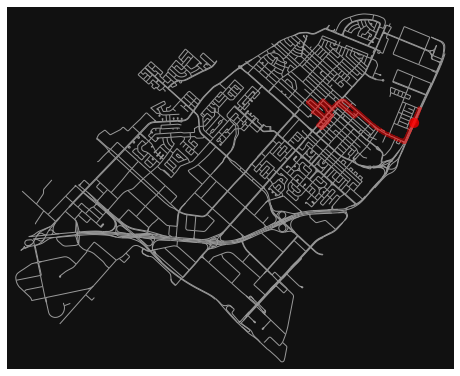

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 9994
time : 39.976 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 246284656, 5245638587, 298544011, 4330900462, 29583134, 33588898, 31243748, 472502195, 476562478, 3705958573, 246283582, 580368408, 246283584, 449080997, 915136497, 246283586, 246283587, 215062666, 246283470, 246283465, 246283595, 581020631, 581020620, 581020631, 581020611, 581020620, 29217073, 581020609, 29217073, 581020620, 658977071, 246283590, 29217073, 581020614, 29217075, 29217082, 29217083, 4365908806, 4365908819, 9648852534, 4331950929, 4331950930, 4365908822, 581020638, 581020633, 581020611, 581020633, 29217075, 9649232653, 29217085, 581020638, 246283384, 4365908826, 246283384, 4330838054, 4330838057, 4330838054, 4330838057, 246283464, 246283463, 246283461, 246283462, 246283421, 246283422, 246283431, 246283375, 246283431, 246283427, 246283373, 246283371, 48

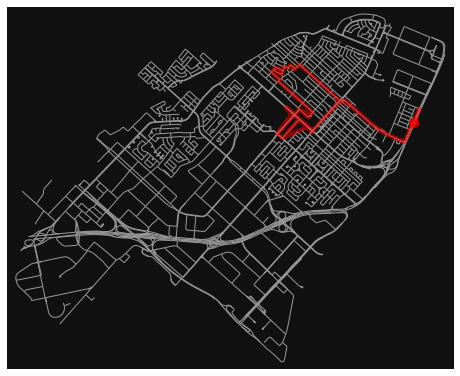

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13792
time : 55.168 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 246284656, 5245638587, 298544011, 4330900462, 29583134, 33588898, 31243748, 472502195, 476562478, 3705958573, 246283538, 4331898529, 246283537, 9807062888, 246283478, 246283552, 472423247, 9803519300, 246283416, 480627426, 246283371, 246283373, 246283427, 246283440, 246283441, 246283434, 3705851607, 3705851608, 246283449, 3705851607, 246283449, 246283371, 246283441, 246283440, 246283426, 246283425, 246283423, 485767053, 246283380, 246283381, 9649000780, 9649000782, 9649000781, 9649000780, 246283381, 246283462, 246283421, 480565592, 480565588, 246283467, 480565588, 246283467, 246283460, 246283419, 246283460, 246283461, 246283383, 4330672236, 4330672238, 4330672236, 4330672238, 4330668772, 4330668775, 4330668772, 4330668775, 9649000782, 1849279244, 4331950930, 433195

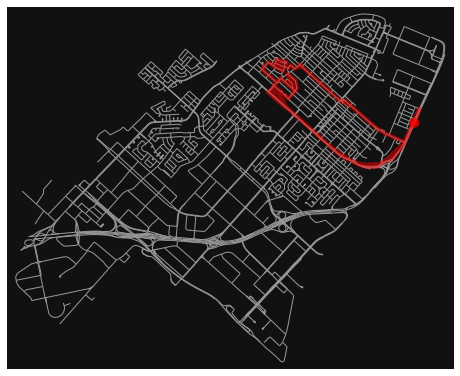

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 14851
time : 59.404 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 246284656, 5245638587, 298544011, 4330900462, 29583134, 33588898, 31243748, 472502195, 476562478, 3705958573, 246283538, 4331898529, 246283537, 9807062888, 246283478, 246283552, 472423247, 9803519300, 246283416, 246283417, 246283418, 246283419, 246283377, 480565592, 246283421, 246283462, 246283381, 9649000780, 9649000781, 6010972967, 246283380, 246283422, 246283423, 480627405, 480627412, 480627405, 480627412, 246283356, 246283378, 485767053, 246280415, 6010972967, 246280415, 246280412, 246283354, 9523114591, 9523114596, 9523114591, 245571046, 4500104061, 4500104045, 4500104048, 1247647284, 1247647243, 486090527, 9522453869, 9772590383, 9522453869, 9522441209, 9522453869, 486090527, 486090528, 1247647284, 4500104048, 4500104035, 4500104045, 4344195535, 9523114588, 9

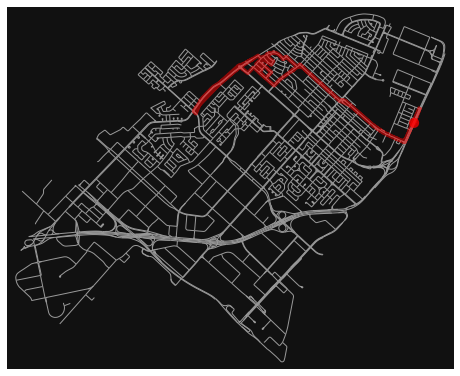

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 15575
time : 62.3 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 246284656, 5245638587, 298544011, 4330900462, 29583134, 33588898, 31243748, 472502195, 476562478, 3705958573, 246283538, 4331898529, 246283537, 9807062888, 246283478, 246283552, 472423247, 9803519300, 246283416, 480627426, 246283371, 246283449, 3705851607, 246283434, 246283433, 246283439, 246283433, 246283434, 246283433, 246283361, 246283360, 246283361, 246283362, 3705929238, 246283362, 3705929238, 246283367, 3705851608, 246283367, 246283445, 9803519300, 246283416, 246283417, 246283418, 480627426, 246283418, 246283419, 246283377, 480565592, 246283377, 246283375, 246283373, 246283371, 480627426, 246283416, 9803519300, 472423247, 4500405524, 246283553, 246283554, 246283555, 246283558, 246283521, 246283568, 246283567, 246283565, 6003604875, 246284672, 246284673, 2462846

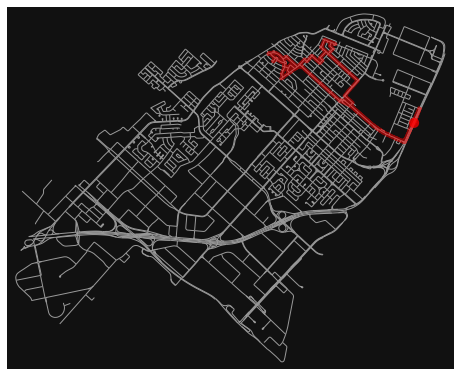

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13294
time : 53.176 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 246284656, 5245638587, 298544011, 4330900462, 29583134, 33588898, 31243748, 472502195, 246285214, 246283579, 4342881587, 246283524, 246282792, 246284691, 246283569, 246285153, 2972424954, 246285179, 246284677, 246285181, 246284679, 246284678, 246284679, 246284678, 246283573, 471953375, 246283573, 246284678, 246283572, 246283571, 246283572, 246284679, 246285181, 246285180, 246285181, 246284677, 246285179, 2972424954, 246285158, 246285157, 246285155, 246285153, 2972424954, 246285153, 246283569, 246284687, 246283570, 246283566, 246283571, 246284673, 246284672, 246283407, 5217188850, 246283557, 6003604875, 246283557, 471953349, 246283556, 471953349, 246283564, 246283568, 246283564, 246283565, 246283567, 246283566, 246283571, 246284677, 246285179, 246285177, 246285175, 

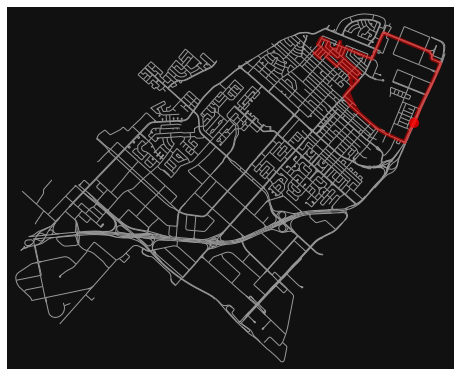

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13170
time : 52.68 minutes
[17052772, 3700802582, 246285226, 246285216, 282041607, 282041604, 6139605437, 246285419, 246285412, 6139605654, 4344307275, 246285406, 246285415, 4500365986, 9654443365, 476569690, 4500347058, 246282785, 246282787, 246282789, 4577350630, 246285173, 246285170, 246285173, 246285174, 246285165, 246285166, 246285167, 246285160, 246285162, 246285164, 246285162, 246285163, 469052508, 469052507, 468445494, 469052507, 469052508, 246285163, 246285173, 4577350630, 4577350629, 4577350630, 246282789, 246285165, 246285174, 246285160, 246285164, 468445494, 246285169, 246285175, 246285159, 246285167, 246285169, 246285170, 246285177, 246285180, 246283573, 471953352, 246283406, 246283407, 5217188850, 246283409, 246283556, 246283555, 246283410, 4518691763, 4518691760, 4518691763, 246283561, 246283563, 246283561, 246283563, 246283489, 4500405524, 246283553, 246283480, 246283479, 485797216, 246284693, 13440931

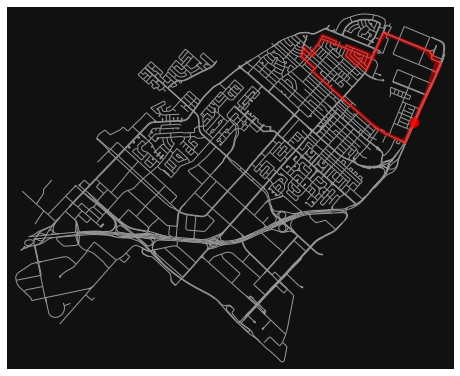

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13701
time : 54.804 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 246284656, 5245638587, 298544011, 4330900462, 29583134, 33588898, 31243748, 472502195, 476562478, 246283580, 29583132, 246284694, 1344093168, 246284693, 485797216, 246283479, 246283480, 246283553, 4500405524, 246283489, 246283563, 246283561, 4518691760, 4616272858, 4616272855, 4616272858, 246283490, 2934287681, 5217188836, 5217188836, 2934287681, 2934287678, 2934287678, 2934287681, 246283492, 4616272852, 246283518, 4518691766, 246283516, 246283518, 4616272852, 4616272854, 246283500, 476558856, 476558852, 476558856, 246283539, 246283513, 246283516, 4518691766, 246283508, 246283505, 246283508, 246283509, 246283512, 246283509, 246283493, 246283489, 246283493, 4578848411, 4578848412, 4578848411, 246283497, 9524274841, 9524274854, 246279619, 9524274841, 4344195546, 2462

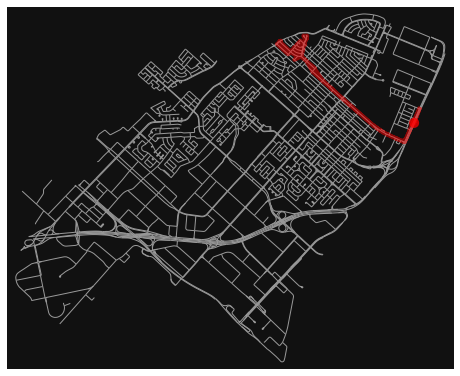

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 12411
time : 49.644 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 246284656, 5245638587, 298544011, 4330900462, 29583134, 33588898, 31243748, 472502195, 476562478, 246283580, 29583132, 246284694, 1344093168, 246284693, 485797216, 246283479, 246283480, 246283553, 4500405524, 246283489, 246283493, 246283509, 246283508, 246283505, 246283504, 476558830, 246279616, 246279615, 476558830, 246283504, 246283513, 246283539, 246279614, 9524274876, 9524274938, 9524274937, 9524274876, 246279614, 246279615, 246279616, 246279619, 9524274854, 4344195548, 9524235011, 4613731609, 9524235011, 9524235010, 246279628, 3705936595, 4344195541, 246279629, 9523114596, 245571046, 4344195535, 9523114585, 4344195538, 3705936593, 4344195538, 246279629, 246280412, 246283378, 246283356, 246283357, 246283358, 246283359, 246283360, 246279628, 9524235010, 24627962

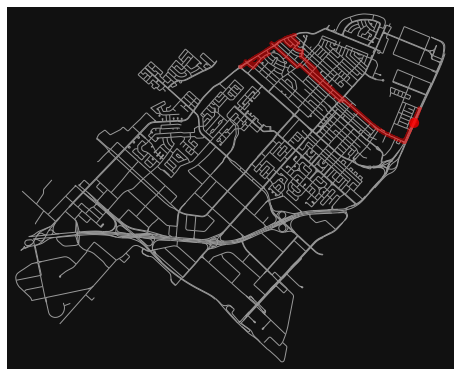

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 12775
time : 51.1 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 246284656, 5245638587, 298544011, 4330900462, 29583134, 33588898, 31243748, 472502195, 476562478, 3705958573, 246283538, 4331898529, 246283537, 9807062888, 246283478, 246283552, 472423247, 4578848412, 246283501, 4578848412, 472423247, 246283552, 246283551, 246283553, 246283480, 246283481, 246283558, 2972424733, 246283522, 246284687, 493900081, 493900082, 493900081, 246284700, 246284699, 246284700, 246284701, 246284702, 246284701, 246284690, 246284691, 246285155, 246285158, 246285159, 9654531655, 9654531656, 4599752656, 4599752655, 471542719, 468140156, 468140176, 468140176, 468140156, 246282787, 4599752655, 246282791, 246285166, 246282791, 9654531655, 246282791, 9654531656, 246284686, 246285157, 246284686, 246282792, 246284691, 246283569, 246283566, 246283569, 246284

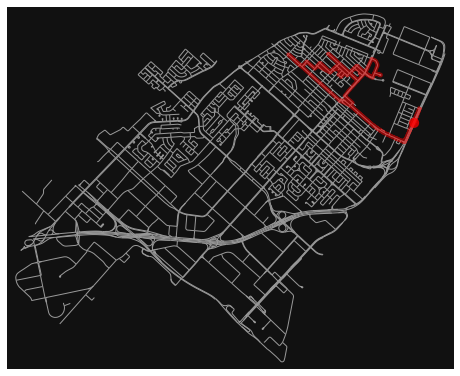

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13675
time : 54.7 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 246284656, 5245638587, 298544011, 4330900462, 29583134, 33588898, 31243748, 472502195, 246285214, 246283579, 4342881587, 246283524, 246284689, 246283523, 246284702, 246284701, 246284700, 493900081, 246284687, 246283570, 246283521, 246283522, 246284695, 246284699, 246284698, 246284697, 246284698, 246284702, 246283523, 246284689, 246284690, 246283523, 246283486, 246283484, 246283486, 246283484, 246284697, 246283483, 2972424632, 246283548, 485797216, 246283479, 246283551, 246283552, 246283478, 9807062888, 246283527, 246283477, 246283478, 246283479, 246283480, 246283481, 246283554, 246283411, 246283563, 246283489, 4500405524, 246283411, 246283410, 246283409, 471957075, 471957103, 471957075, 4616272855, 246283490, 246283492, 4616272854, 246283500, 9524274937, 246283500, 4

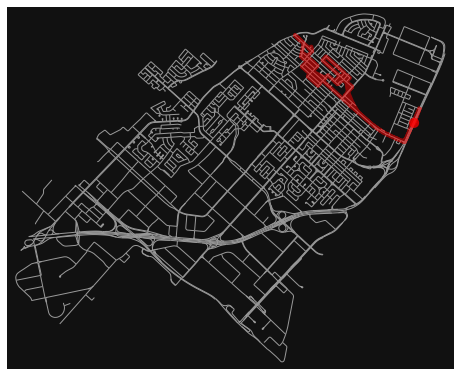

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13880
time : 55.52 minutes
[17052772, 3700802582, 246285226, 246285216, 282041607, 282041604, 6139605437, 246285419, 246285412, 6139605654, 4344307275, 246285406, 246285415, 4500365986, 9654443365, 476569690, 246282784, 246285346, 246285323, 246285325, 4502327405, 246282368, 486502345, 4502313085, 246282364, 4502313086, 4502313080, 246282363, 424004581, 424004583, 9524636151, 8503242865, 456661583, 246100012, 456661583, 8503242865, 9524636151, 8503242865, 8660702733, 456661583, 456661584, 246099989, 9524274938, 246099989, 246100012, 424004585, 246282353, 424004585, 424004583, 9524636151, 401364813, 424004583, 424004581, 246282363, 4502313080, 4502313086, 246282364, 4502313085, 4502314589, 246282364, 246282354, 4502314591, 246282353, 424004581, 246282363, 246285287, 246285293, 246285303, 246285302, 246285322, 246285323, 246285346, 246282784, 476569690, 4500347058, 246282785, 246282787, 246282789, 246282358, 246282785, 

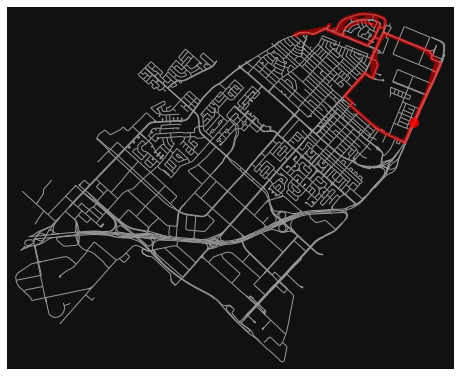

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 13871
time : 55.484 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 246284656, 5245638587, 298544011, 4330900462, 29583134, 33588898, 31243748, 472502195, 246285214, 246283579, 4342896267, 246283577, 4599752656, 246284670, 478435894, 246285206, 246285206, 478435894, 246284670, 471542719, 246284670, 4599752656, 246283577, 4342896267, 246283577, 246282792, 246283524, 4342896267, 246283579, 246285214, 3088409078, 246285214, 472502195, 31243748, 33588898, 215062614, 215062619, 246283755, 246283747, 246283748, 246283747, 227784559, 298543993, 298544001, 227778652, 581020692, 215062630, 246283747, 227784559, 227778652, 215062643, 5225077119, 215062643, 215062743, 215062643, 215062641, 915136524, 33588901, 215062630, 227784559, 298543993, 4065691418, 246284656, 4065691422, 4065691425, 4109587564, 473370011, 1843993868, 4810585640, 8632391

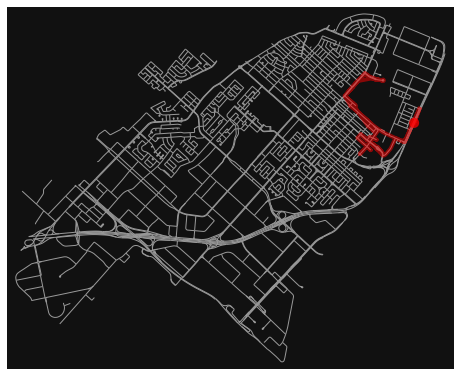

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 12031
time : 48.124 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 4109587564, 4065691425, 4065691422, 246284656, 5245638587, 298544011, 298544009, 298544011, 4330900462, 4330900467, 4330900462, 29583134, 246283755, 29583134, 33588898, 31243748, 215062609, 215062603, 580368405, 215062563, 215062546, 33588902, 4344285536, 215062640, 215062641, 215062647, 215062651, 215062655, 31243751, 215062640, 215062651, 215062690, 33588903, 246283619, 246283621, 581020654, 29217078, 31243749, 298140028, 298137801, 298140036, 298140054, 298140044, 298140046, 298140043, 298140044, 298140043, 298140042, 298140041, 298140040, 298140039, 485798862, 298169990, 298140023, 298140024, 298140025, 298140026, 29217080, 581020581, 581020588, 227761294, 246283772, 8630521161, 3313262007, 3313262006, 3313262022, 4065691415, 5281042258, 473370011, 1843993868, 4810585640, 8632391124, 246285221, 2

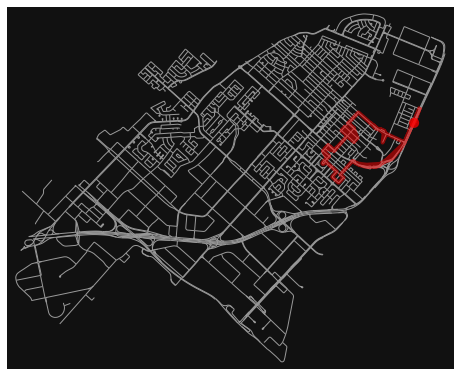

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)
length of road : 9662
time : 38.648 minutes
[17052772, 3700802582, 246285220, 246285221, 8632391124, 4810585640, 1843993868, 473370011, 5281042258, 4065691415, 3313262022, 3313262006, 3313262007, 8630521161, 246283772, 227761294, 581020588, 581020581, 29217080, 298140026, 298140025, 298140024, 298140023, 485798862, 298169927, 298169933, 298169993, 298169944, 298169993, 298169990, 298140023, 485798862, 298169927, 298169923, 2130282101, 298175358, 493016799, 298177510, 298177503, 298177502, 298177503, 493016799, 298175358, 298175428, 298175425, 298175428, 298175425, 298175363, 298175361, 298175362, 298175369, 298178380, 298175369, 298175376, 298175344, 298175376, 298175379, 298175369, 298175379, 298175343, 580368350, 298528099, 580368350, 298528102, 298528130, 298528120, 298175342, 298528120, 298528117, 298528130, 298528102, 298528099, 298528088, 298176713, 298176716, 298175340, 4625163311, 298175339, 298175338, 298175337, 298175354, 29

In [ ]:
resolve_function(listofquarter, 2200, 15, drive, walk)